# Deep Convolutional GANs 深度卷积GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

在这款笔记本中，您将使用生成器和鉴别器中的卷积层构建GAN。这被称为深卷积GAN，简称为DCGAN。 DCGAN架构去年首次被探索，并且在生成新图像方面取得了令人印象深刻的成果，您可以阅读 [原始论文](https://arxiv.org/pdf/1511.06434.pdf)。

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST.

你将在[Street View House Numbers](http://ufldl.stanford.edu/housenumbers/)（SVHN）数据集上训练DCGAN。这些是从Google街景视图收集的房屋号码的彩色图像。 SVHN图像是颜色，比MNIST更加变化。

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

所以我们需要一个更深入，更强大的网络。这通过在鉴别器和发生器中使用卷积层来实现。还需要使用批归一化来获得卷积网络的训练。与[you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) 相比，唯一真正的变化是在生成器和鉴别器中，否则其余的实现是相同的。

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: 无法创建目录"data": 文件已存在


## Getting the data 获得数据

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

在这里可以下载SVHN数据集。 运行上面的单元格，它将下载到您的计算机。

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

这些SVHN文件是通常与Matlab一起使用的`.mat`文件。 但是，我们可以使用上面导入的 `scipy.io.loadmat` 加载它们。

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

在这里，我展示了一小部分图像。 这些都是32x32，有3个彩色通道(RGB)。 这些是我们将传递给鉴别器的真实图像，以及发生器将最终假定的真实图像。

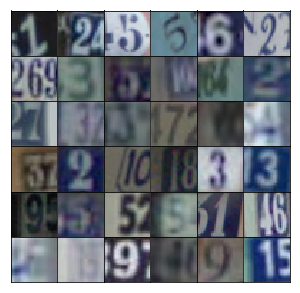

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

在这里，我们需要进行一些预处理，并将图像转换成可以将批次传递到网络的形式。 首先，我们需要将图像重新缩放到-1到1的范围，因为我们的发生器的输出也在该范围内。 我们还有一组测试和验证图像，如果我们试图识别图像中的数字，可以使用它们。

In [20]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [21]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), self.scaler(y)

## Network Inputs 网络输入

Here, just creating some placeholders like normal. 在这里，只是创建一些像正常的占位符。

In [22]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator 生成器

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

在这里，您将构建生成器网络。 输入将像以前一样是我们的噪声矢量 `z`。 同样如前所述，输出将是 $tanh$ 输出，但是这次大小为32x32，这是我们的SVHN图像的大小。

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

这里有新功能，我们将使用卷积层来创建我们的新图像。 第一层是完全连接的层，其重新形成深而窄的层，像原始DCGAN纸中的4×4×1024。 然后我们使用批归一化和leaky ReLU激活。 接下来是一个转置的卷积，通常你会将深度减半，并加倍上一层的宽度和高度。 再次，我们使用批归一化和leaky ReLU。 对于这些层中的每一层，一般方案是 卷积 > 批归一化 > leaky ReLU。

You keep stack layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

你可以像这样保持堆叠层，直到得到32x32x3形状的最终转置的卷积层。 以下是原始DCGAN论文中使用的archicture：

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3.

请注意，这里的最后一层是64x64x3，而对于我们的SVHN数据集，我们只希望它是32x32x3。

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator 鉴别器

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

在这里，您将构建鉴别器。 这基本上只是你之前建立的卷积分类器。 鉴别器的输入为32x32x3张量/图像。 您将需要几个卷积层，然后是输出的完全连接层。 像以前一样，我们想要一个Sigmoid输出，你也需要返回逻辑。 对于卷积层的深度，我建议从第一层中的16,32,64个过滤器开始，然后在添加图层时将深度加倍。 请注意，在DCGAN论文中，他们进行了所有的采样，仅使用没有最大色散层的步进卷积层。

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

您还需要在除了第一个卷积和输出层之外的每个层上使用 `tf.layers.batch_normalization` 进行批量归一化。 再次，每个层应该看起来像卷积 >批量规范 > leaky ReLU。

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x32
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss 模型损失

Calculating the loss like before, nothing new here.

计算损失像以前一样，没有什么新鲜的。

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers 优化器

Again, nothing new here.

有一个，没有什么新鲜的

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
    g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model 建立模型

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

在这里，我们可以使用我们定义的函数来将模型构建为一个类。 这将使得在我们的代码中更容易地移动网络，因为图中的节点和操作被打包在一个对象中。

In [23]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, 0.5)

Here is a function for displaying generated images. 

这是现实生成图像的方法

In [24]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img)
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network.

另一个方法我们可以用来训练你的网络。

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(50, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 5, 10, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters 超参数

GANs are very senstive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

GANs 对超参数非常敏感。 大量的实验发现，寻找最佳的超参数，使得发生器和鉴别器不会相互超载。 尝试您自己的超参数或阅读 [DCGAN论文](https://arxiv.org/pdf/1511.06434.pdf)，看看它们有什么用。

In [25]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.3183... Generator Loss: 0.6955
Epoch 1/25... Discriminator Loss: 1.0385... Generator Loss: 0.6297
Epoch 1/25... Discriminator Loss: 0.3985... Generator Loss: 1.3502
Epoch 1/25... Discriminator Loss: 0.1469... Generator Loss: 2.9561
Epoch 1/25... Discriminator Loss: 0.1658... Generator Loss: 2.7151
Epoch 1/25... Discriminator Loss: 0.0742... Generator Loss: 3.5025
Epoch 1/25... Discriminator Loss: 0.1063... Generator Loss: 2.7564
Epoch 1/25... Discriminator Loss: 0.2471... Generator Loss: 2.0305
Epoch 1/25... Discriminator Loss: 0.9783... Generator Loss: 1.8017
Epoch 1/25... Discriminator Loss: 0.8145... Generator Loss: 1.1398


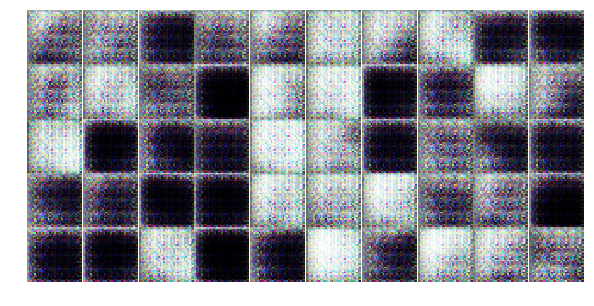

Epoch 1/25... Discriminator Loss: 0.9163... Generator Loss: 1.9436
Epoch 1/25... Discriminator Loss: 0.7336... Generator Loss: 1.8797
Epoch 1/25... Discriminator Loss: 0.8500... Generator Loss: 1.2794
Epoch 1/25... Discriminator Loss: 0.3461... Generator Loss: 2.3820
Epoch 1/25... Discriminator Loss: 0.4289... Generator Loss: 1.9456
Epoch 1/25... Discriminator Loss: 0.4931... Generator Loss: 1.3880
Epoch 1/25... Discriminator Loss: 0.3716... Generator Loss: 1.7019
Epoch 1/25... Discriminator Loss: 0.4325... Generator Loss: 1.5098
Epoch 1/25... Discriminator Loss: 0.5596... Generator Loss: 1.4336
Epoch 1/25... Discriminator Loss: 1.7819... Generator Loss: 2.5253


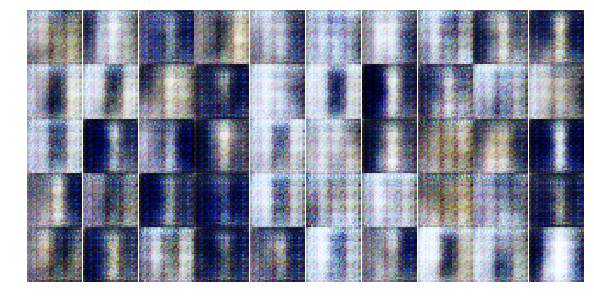

Epoch 1/25... Discriminator Loss: 1.2199... Generator Loss: 0.5270
Epoch 1/25... Discriminator Loss: 0.2110... Generator Loss: 2.7441
Epoch 1/25... Discriminator Loss: 1.0975... Generator Loss: 0.6006
Epoch 1/25... Discriminator Loss: 1.2923... Generator Loss: 4.2824
Epoch 1/25... Discriminator Loss: 0.4095... Generator Loss: 1.6319
Epoch 1/25... Discriminator Loss: 0.9081... Generator Loss: 0.9593
Epoch 1/25... Discriminator Loss: 0.5314... Generator Loss: 1.3730
Epoch 1/25... Discriminator Loss: 1.1667... Generator Loss: 1.5904
Epoch 1/25... Discriminator Loss: 0.5000... Generator Loss: 1.5207
Epoch 1/25... Discriminator Loss: 0.8847... Generator Loss: 2.8169


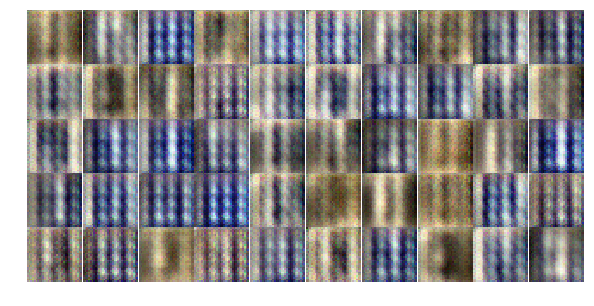

Epoch 1/25... Discriminator Loss: 1.1838... Generator Loss: 0.8475
Epoch 1/25... Discriminator Loss: 0.5410... Generator Loss: 1.9548
Epoch 1/25... Discriminator Loss: 0.3657... Generator Loss: 1.7653
Epoch 1/25... Discriminator Loss: 0.4165... Generator Loss: 2.9274
Epoch 1/25... Discriminator Loss: 0.4971... Generator Loss: 1.3171
Epoch 1/25... Discriminator Loss: 0.2352... Generator Loss: 2.4256
Epoch 1/25... Discriminator Loss: 0.5819... Generator Loss: 1.6218
Epoch 1/25... Discriminator Loss: 0.4574... Generator Loss: 2.3583
Epoch 1/25... Discriminator Loss: 0.2353... Generator Loss: 2.1079
Epoch 1/25... Discriminator Loss: 0.3114... Generator Loss: 2.3554


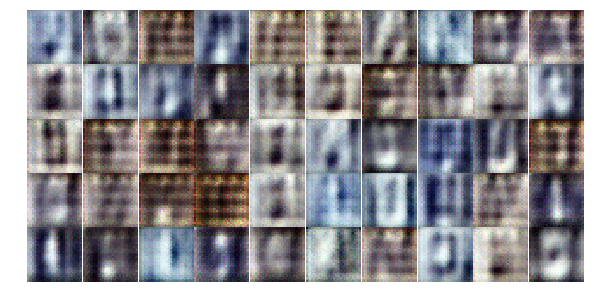

Epoch 1/25... Discriminator Loss: 0.3051... Generator Loss: 2.1064
Epoch 1/25... Discriminator Loss: 0.5433... Generator Loss: 1.2389
Epoch 1/25... Discriminator Loss: 0.5948... Generator Loss: 1.0994
Epoch 1/25... Discriminator Loss: 0.3175... Generator Loss: 2.9312
Epoch 1/25... Discriminator Loss: 0.6249... Generator Loss: 1.8663
Epoch 1/25... Discriminator Loss: 0.6079... Generator Loss: 1.4747
Epoch 1/25... Discriminator Loss: 0.6467... Generator Loss: 1.4607
Epoch 1/25... Discriminator Loss: 1.0969... Generator Loss: 0.7197
Epoch 1/25... Discriminator Loss: 0.7827... Generator Loss: 0.8706
Epoch 1/25... Discriminator Loss: 0.7267... Generator Loss: 1.5304


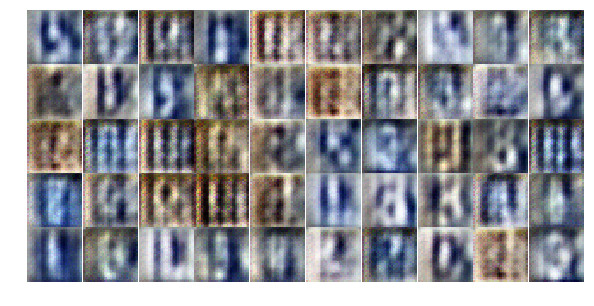

Epoch 1/25... Discriminator Loss: 0.3544... Generator Loss: 2.4860
Epoch 1/25... Discriminator Loss: 0.3818... Generator Loss: 1.7365
Epoch 1/25... Discriminator Loss: 0.5687... Generator Loss: 1.2298
Epoch 1/25... Discriminator Loss: 0.8457... Generator Loss: 0.7682
Epoch 1/25... Discriminator Loss: 0.7681... Generator Loss: 1.0837
Epoch 1/25... Discriminator Loss: 0.5708... Generator Loss: 1.4048
Epoch 1/25... Discriminator Loss: 0.3565... Generator Loss: 2.1532
Epoch 2/25... Discriminator Loss: 0.7474... Generator Loss: 2.0870
Epoch 2/25... Discriminator Loss: 0.8077... Generator Loss: 1.3853
Epoch 2/25... Discriminator Loss: 0.7776... Generator Loss: 1.7525


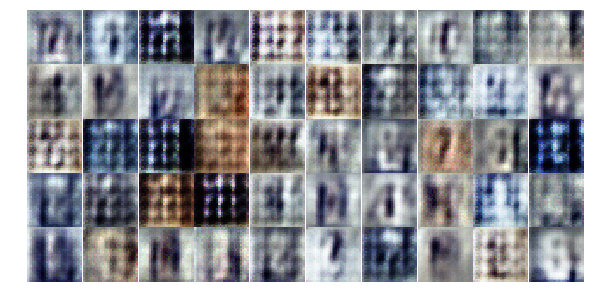

Epoch 2/25... Discriminator Loss: 0.9434... Generator Loss: 1.5056
Epoch 2/25... Discriminator Loss: 0.9666... Generator Loss: 1.3198
Epoch 2/25... Discriminator Loss: 1.2299... Generator Loss: 0.8097
Epoch 2/25... Discriminator Loss: 0.8737... Generator Loss: 1.3486
Epoch 2/25... Discriminator Loss: 0.8007... Generator Loss: 1.1066
Epoch 2/25... Discriminator Loss: 0.7339... Generator Loss: 1.5384
Epoch 2/25... Discriminator Loss: 0.8502... Generator Loss: 1.1464
Epoch 2/25... Discriminator Loss: 0.9963... Generator Loss: 1.7826
Epoch 2/25... Discriminator Loss: 0.5940... Generator Loss: 1.7844
Epoch 2/25... Discriminator Loss: 1.1775... Generator Loss: 1.8134


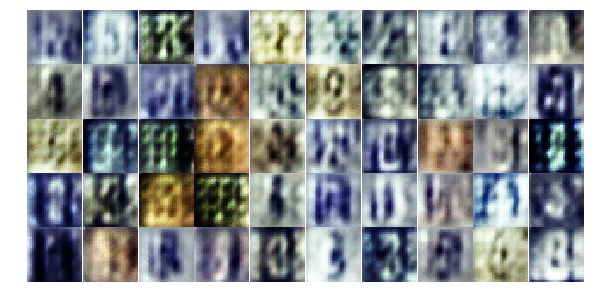

Epoch 2/25... Discriminator Loss: 0.9121... Generator Loss: 1.2906
Epoch 2/25... Discriminator Loss: 0.8279... Generator Loss: 1.2594
Epoch 2/25... Discriminator Loss: 0.7520... Generator Loss: 1.0392
Epoch 2/25... Discriminator Loss: 0.6515... Generator Loss: 1.3471
Epoch 2/25... Discriminator Loss: 0.6716... Generator Loss: 1.7253
Epoch 2/25... Discriminator Loss: 0.9298... Generator Loss: 1.0100
Epoch 2/25... Discriminator Loss: 1.2152... Generator Loss: 1.2348
Epoch 2/25... Discriminator Loss: 1.2825... Generator Loss: 0.5549
Epoch 2/25... Discriminator Loss: 1.0998... Generator Loss: 0.8033
Epoch 2/25... Discriminator Loss: 0.8750... Generator Loss: 1.0600


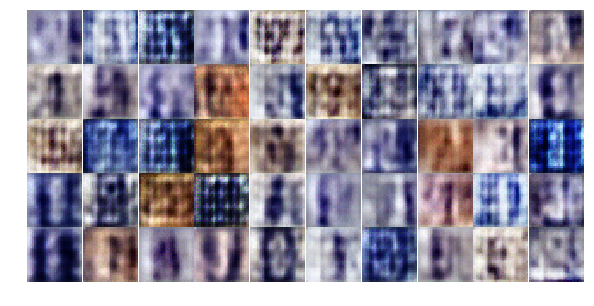

Epoch 2/25... Discriminator Loss: 0.7605... Generator Loss: 1.1276
Epoch 2/25... Discriminator Loss: 0.9523... Generator Loss: 1.3496
Epoch 2/25... Discriminator Loss: 0.8629... Generator Loss: 1.1891
Epoch 2/25... Discriminator Loss: 1.1616... Generator Loss: 0.9245
Epoch 2/25... Discriminator Loss: 1.2336... Generator Loss: 1.5806
Epoch 2/25... Discriminator Loss: 1.0110... Generator Loss: 1.3805
Epoch 2/25... Discriminator Loss: 1.1072... Generator Loss: 0.7861
Epoch 2/25... Discriminator Loss: 1.3744... Generator Loss: 0.5918
Epoch 2/25... Discriminator Loss: 1.0866... Generator Loss: 0.8417
Epoch 2/25... Discriminator Loss: 1.1122... Generator Loss: 0.9519


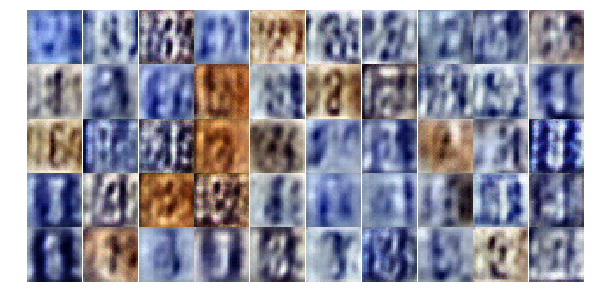

Epoch 2/25... Discriminator Loss: 1.0759... Generator Loss: 0.8486
Epoch 2/25... Discriminator Loss: 1.1871... Generator Loss: 1.0333
Epoch 2/25... Discriminator Loss: 1.0470... Generator Loss: 0.8206
Epoch 2/25... Discriminator Loss: 0.9314... Generator Loss: 0.9628
Epoch 2/25... Discriminator Loss: 0.9919... Generator Loss: 1.3599
Epoch 2/25... Discriminator Loss: 1.0972... Generator Loss: 0.8480
Epoch 2/25... Discriminator Loss: 0.9829... Generator Loss: 1.1743
Epoch 2/25... Discriminator Loss: 1.1187... Generator Loss: 1.1999
Epoch 2/25... Discriminator Loss: 0.9321... Generator Loss: 1.1070
Epoch 2/25... Discriminator Loss: 1.2350... Generator Loss: 1.1918


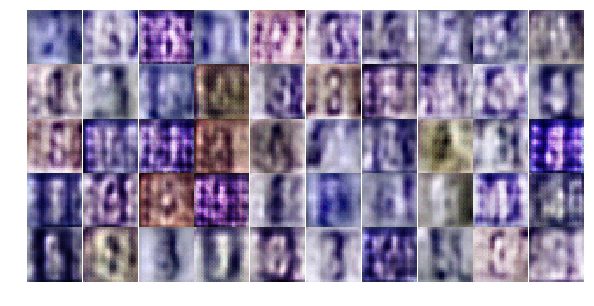

Epoch 2/25... Discriminator Loss: 1.0116... Generator Loss: 1.0779
Epoch 2/25... Discriminator Loss: 1.1754... Generator Loss: 1.5762
Epoch 2/25... Discriminator Loss: 0.9282... Generator Loss: 1.0128
Epoch 2/25... Discriminator Loss: 1.2523... Generator Loss: 0.7838
Epoch 2/25... Discriminator Loss: 1.0090... Generator Loss: 0.9571
Epoch 2/25... Discriminator Loss: 1.0758... Generator Loss: 1.0229
Epoch 2/25... Discriminator Loss: 0.9819... Generator Loss: 1.5376
Epoch 2/25... Discriminator Loss: 0.8452... Generator Loss: 1.3409
Epoch 2/25... Discriminator Loss: 1.1750... Generator Loss: 0.8492
Epoch 2/25... Discriminator Loss: 1.0084... Generator Loss: 1.0137


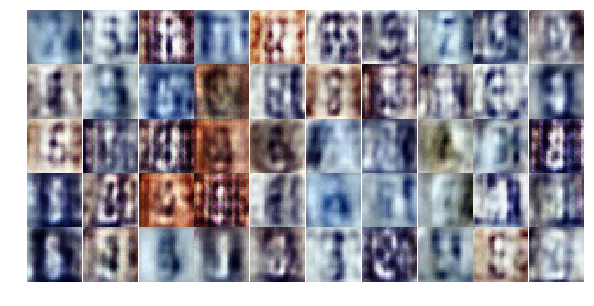

Epoch 2/25... Discriminator Loss: 0.8729... Generator Loss: 1.4344
Epoch 2/25... Discriminator Loss: 0.9842... Generator Loss: 1.1374
Epoch 2/25... Discriminator Loss: 1.3200... Generator Loss: 0.5664
Epoch 2/25... Discriminator Loss: 1.2013... Generator Loss: 0.8567
Epoch 3/25... Discriminator Loss: 0.9264... Generator Loss: 1.2054
Epoch 3/25... Discriminator Loss: 1.0105... Generator Loss: 0.8780
Epoch 3/25... Discriminator Loss: 1.0093... Generator Loss: 1.4507
Epoch 3/25... Discriminator Loss: 0.7710... Generator Loss: 1.1985
Epoch 3/25... Discriminator Loss: 0.9335... Generator Loss: 1.0424
Epoch 3/25... Discriminator Loss: 0.8830... Generator Loss: 1.4679


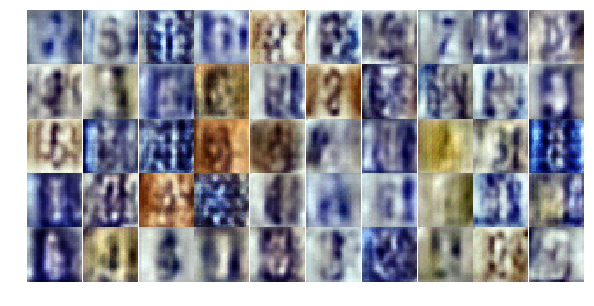

Epoch 3/25... Discriminator Loss: 0.9241... Generator Loss: 1.0490
Epoch 3/25... Discriminator Loss: 1.0053... Generator Loss: 1.1968
Epoch 3/25... Discriminator Loss: 1.1835... Generator Loss: 0.9768
Epoch 3/25... Discriminator Loss: 0.6885... Generator Loss: 1.5223
Epoch 3/25... Discriminator Loss: 1.1145... Generator Loss: 0.6592
Epoch 3/25... Discriminator Loss: 0.8049... Generator Loss: 1.2152
Epoch 3/25... Discriminator Loss: 1.0089... Generator Loss: 1.2891
Epoch 3/25... Discriminator Loss: 1.2527... Generator Loss: 1.3932
Epoch 3/25... Discriminator Loss: 0.8763... Generator Loss: 1.0619
Epoch 3/25... Discriminator Loss: 0.6961... Generator Loss: 1.3717


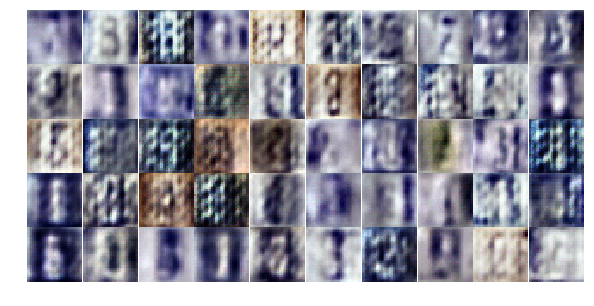

Epoch 3/25... Discriminator Loss: 0.9161... Generator Loss: 1.3854
Epoch 3/25... Discriminator Loss: 0.7642... Generator Loss: 1.1052
Epoch 3/25... Discriminator Loss: 0.7712... Generator Loss: 1.1368
Epoch 3/25... Discriminator Loss: 0.7085... Generator Loss: 1.3699
Epoch 3/25... Discriminator Loss: 0.3885... Generator Loss: 1.5998
Epoch 3/25... Discriminator Loss: 0.4694... Generator Loss: 1.9900
Epoch 3/25... Discriminator Loss: 0.6691... Generator Loss: 1.7887
Epoch 3/25... Discriminator Loss: 0.7899... Generator Loss: 1.0552
Epoch 3/25... Discriminator Loss: 0.8834... Generator Loss: 1.0398
Epoch 3/25... Discriminator Loss: 0.7778... Generator Loss: 1.0874


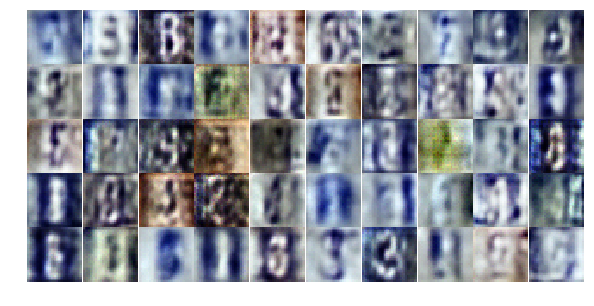

Epoch 3/25... Discriminator Loss: 0.7357... Generator Loss: 1.2580
Epoch 3/25... Discriminator Loss: 0.6594... Generator Loss: 1.6641
Epoch 3/25... Discriminator Loss: 0.7802... Generator Loss: 0.9387
Epoch 3/25... Discriminator Loss: 0.3114... Generator Loss: 1.9620
Epoch 3/25... Discriminator Loss: 0.7887... Generator Loss: 1.2026
Epoch 3/25... Discriminator Loss: 0.6295... Generator Loss: 1.5389
Epoch 3/25... Discriminator Loss: 1.0028... Generator Loss: 0.7488
Epoch 3/25... Discriminator Loss: 0.4971... Generator Loss: 1.7979
Epoch 3/25... Discriminator Loss: 0.5632... Generator Loss: 1.5906
Epoch 3/25... Discriminator Loss: 0.7401... Generator Loss: 0.9522


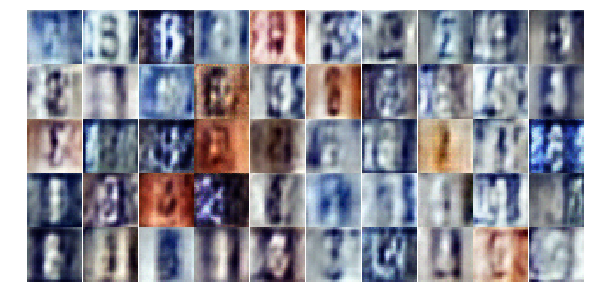

Epoch 3/25... Discriminator Loss: 0.6717... Generator Loss: 2.2909
Epoch 3/25... Discriminator Loss: 0.2583... Generator Loss: 2.4184
Epoch 3/25... Discriminator Loss: 0.6214... Generator Loss: 1.1775
Epoch 3/25... Discriminator Loss: 0.6680... Generator Loss: 1.3730
Epoch 3/25... Discriminator Loss: 0.4722... Generator Loss: 1.7158
Epoch 3/25... Discriminator Loss: 0.5936... Generator Loss: 1.2798
Epoch 3/25... Discriminator Loss: 0.7862... Generator Loss: 2.0198
Epoch 3/25... Discriminator Loss: 0.6768... Generator Loss: 1.2307
Epoch 3/25... Discriminator Loss: 0.9884... Generator Loss: 1.0450
Epoch 3/25... Discriminator Loss: 0.7862... Generator Loss: 1.1195


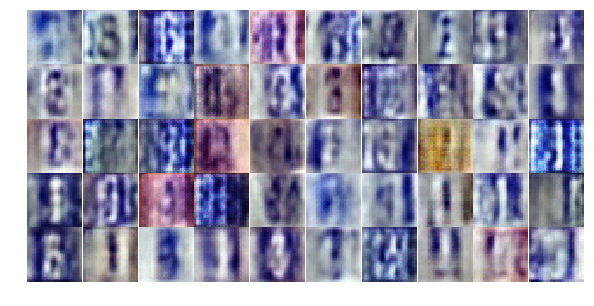

Epoch 3/25... Discriminator Loss: 0.6002... Generator Loss: 1.7269
Epoch 3/25... Discriminator Loss: 2.2917... Generator Loss: 3.6976
Epoch 3/25... Discriminator Loss: 0.7505... Generator Loss: 1.1033
Epoch 3/25... Discriminator Loss: 0.4631... Generator Loss: 1.4965
Epoch 3/25... Discriminator Loss: 0.4266... Generator Loss: 1.5388
Epoch 3/25... Discriminator Loss: 0.4313... Generator Loss: 1.7846
Epoch 3/25... Discriminator Loss: 0.5924... Generator Loss: 1.3204
Epoch 3/25... Discriminator Loss: 0.3462... Generator Loss: 2.0593
Epoch 3/25... Discriminator Loss: 0.4589... Generator Loss: 1.8510
Epoch 3/25... Discriminator Loss: 0.3697... Generator Loss: 2.0104


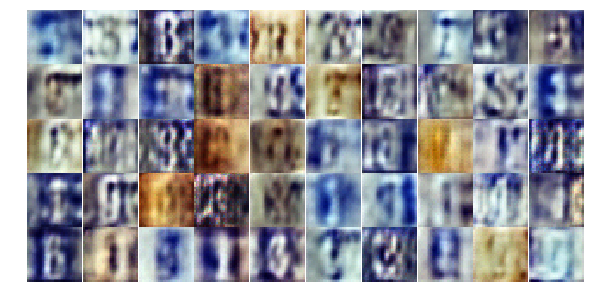

Epoch 3/25... Discriminator Loss: 0.5706... Generator Loss: 1.2434
Epoch 4/25... Discriminator Loss: 0.6941... Generator Loss: 1.0747
Epoch 4/25... Discriminator Loss: 0.3395... Generator Loss: 1.9188
Epoch 4/25... Discriminator Loss: 0.9058... Generator Loss: 0.7388
Epoch 4/25... Discriminator Loss: 0.3590... Generator Loss: 2.0752
Epoch 4/25... Discriminator Loss: 0.6904... Generator Loss: 1.1902
Epoch 4/25... Discriminator Loss: 0.2577... Generator Loss: 2.5655
Epoch 4/25... Discriminator Loss: 0.4033... Generator Loss: 2.1494
Epoch 4/25... Discriminator Loss: 1.1007... Generator Loss: 3.6906
Epoch 4/25... Discriminator Loss: 0.6993... Generator Loss: 1.1951


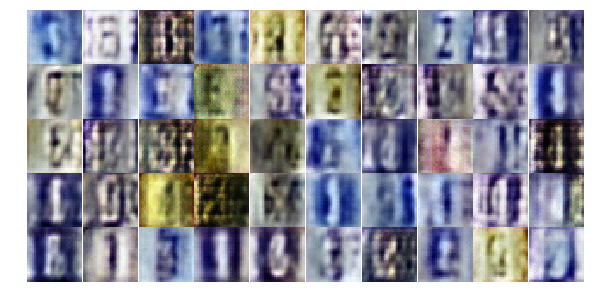

Epoch 4/25... Discriminator Loss: 0.3621... Generator Loss: 2.0981
Epoch 4/25... Discriminator Loss: 0.9186... Generator Loss: 0.7370
Epoch 4/25... Discriminator Loss: 1.0833... Generator Loss: 1.8138
Epoch 4/25... Discriminator Loss: 0.3367... Generator Loss: 2.1703
Epoch 4/25... Discriminator Loss: 0.4687... Generator Loss: 1.6033
Epoch 4/25... Discriminator Loss: 0.9689... Generator Loss: 0.6963
Epoch 4/25... Discriminator Loss: 0.5011... Generator Loss: 1.9097
Epoch 4/25... Discriminator Loss: 0.3504... Generator Loss: 2.0461
Epoch 4/25... Discriminator Loss: 0.6219... Generator Loss: 1.8900
Epoch 4/25... Discriminator Loss: 3.1936... Generator Loss: 5.2093


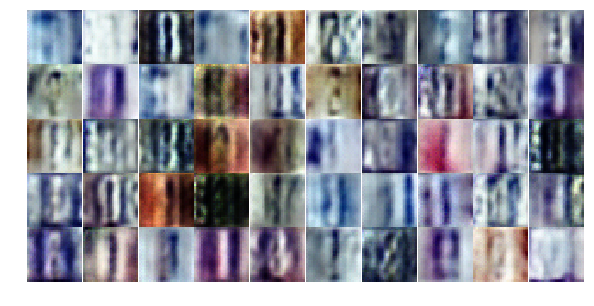

Epoch 4/25... Discriminator Loss: 0.9243... Generator Loss: 1.1218
Epoch 4/25... Discriminator Loss: 0.7669... Generator Loss: 1.6101
Epoch 4/25... Discriminator Loss: 0.5754... Generator Loss: 1.4285
Epoch 4/25... Discriminator Loss: 0.7293... Generator Loss: 1.1373
Epoch 4/25... Discriminator Loss: 0.6677... Generator Loss: 1.1466
Epoch 4/25... Discriminator Loss: 0.5056... Generator Loss: 2.5571
Epoch 4/25... Discriminator Loss: 0.4140... Generator Loss: 2.2072
Epoch 4/25... Discriminator Loss: 0.6579... Generator Loss: 1.1120
Epoch 4/25... Discriminator Loss: 0.8084... Generator Loss: 0.8945
Epoch 4/25... Discriminator Loss: 0.4840... Generator Loss: 1.3940


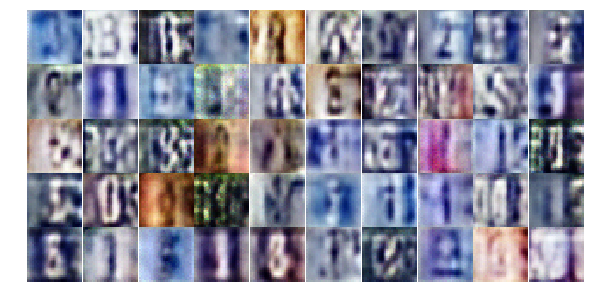

Epoch 4/25... Discriminator Loss: 0.3394... Generator Loss: 1.9459
Epoch 4/25... Discriminator Loss: 0.3914... Generator Loss: 1.7601
Epoch 4/25... Discriminator Loss: 0.5834... Generator Loss: 1.1295
Epoch 4/25... Discriminator Loss: 0.4380... Generator Loss: 2.4411
Epoch 4/25... Discriminator Loss: 0.5754... Generator Loss: 2.0720
Epoch 4/25... Discriminator Loss: 0.5176... Generator Loss: 1.6949
Epoch 4/25... Discriminator Loss: 0.3862... Generator Loss: 2.3539
Epoch 4/25... Discriminator Loss: 0.4671... Generator Loss: 1.5287
Epoch 4/25... Discriminator Loss: 0.4671... Generator Loss: 1.5960
Epoch 4/25... Discriminator Loss: 0.8221... Generator Loss: 0.9237


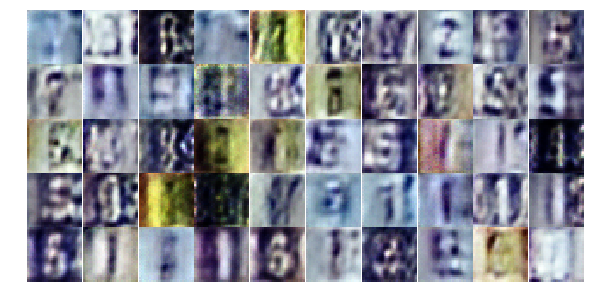

Epoch 4/25... Discriminator Loss: 0.4272... Generator Loss: 1.6856
Epoch 4/25... Discriminator Loss: 0.4674... Generator Loss: 1.4856
Epoch 4/25... Discriminator Loss: 0.8017... Generator Loss: 1.2021
Epoch 4/25... Discriminator Loss: 0.4686... Generator Loss: 1.5081
Epoch 4/25... Discriminator Loss: 0.6185... Generator Loss: 1.0994
Epoch 4/25... Discriminator Loss: 0.8236... Generator Loss: 1.0753
Epoch 4/25... Discriminator Loss: 2.9313... Generator Loss: 0.0922
Epoch 4/25... Discriminator Loss: 0.8316... Generator Loss: 1.7556
Epoch 4/25... Discriminator Loss: 0.9085... Generator Loss: 0.7461
Epoch 4/25... Discriminator Loss: 0.5772... Generator Loss: 1.2526


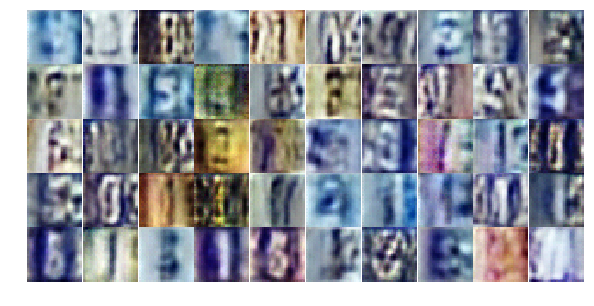

Epoch 4/25... Discriminator Loss: 0.5498... Generator Loss: 1.4577
Epoch 4/25... Discriminator Loss: 0.4885... Generator Loss: 1.7836
Epoch 4/25... Discriminator Loss: 0.4000... Generator Loss: 1.7702
Epoch 4/25... Discriminator Loss: 0.7580... Generator Loss: 1.1264
Epoch 4/25... Discriminator Loss: 0.6345... Generator Loss: 1.2718
Epoch 4/25... Discriminator Loss: 0.6109... Generator Loss: 1.3999
Epoch 4/25... Discriminator Loss: 0.4242... Generator Loss: 1.6318
Epoch 4/25... Discriminator Loss: 0.8761... Generator Loss: 0.8017
Epoch 4/25... Discriminator Loss: 0.5026... Generator Loss: 2.0629
Epoch 5/25... Discriminator Loss: 0.5245... Generator Loss: 1.5594


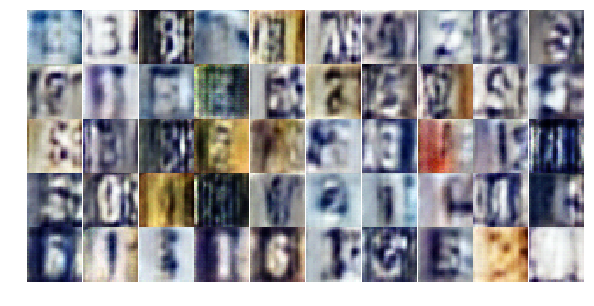

Epoch 5/25... Discriminator Loss: 0.4199... Generator Loss: 1.9358
Epoch 5/25... Discriminator Loss: 0.2824... Generator Loss: 2.3662
Epoch 5/25... Discriminator Loss: 0.5010... Generator Loss: 1.3536
Epoch 5/25... Discriminator Loss: 0.7784... Generator Loss: 0.8359
Epoch 5/25... Discriminator Loss: 0.4876... Generator Loss: 2.4992
Epoch 5/25... Discriminator Loss: 0.8437... Generator Loss: 0.7742
Epoch 5/25... Discriminator Loss: 0.7052... Generator Loss: 0.8977
Epoch 5/25... Discriminator Loss: 0.5449... Generator Loss: 1.1649
Epoch 5/25... Discriminator Loss: 0.4273... Generator Loss: 1.5356
Epoch 5/25... Discriminator Loss: 1.3238... Generator Loss: 0.4201


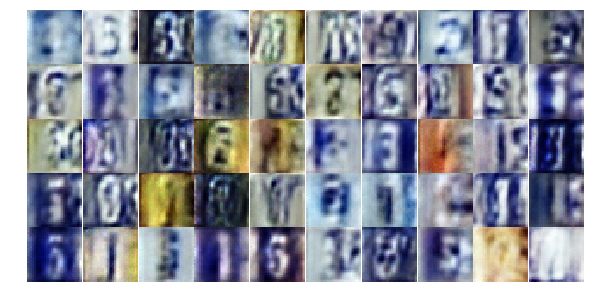

Epoch 5/25... Discriminator Loss: 1.2660... Generator Loss: 0.6119
Epoch 5/25... Discriminator Loss: 0.8130... Generator Loss: 1.1148
Epoch 5/25... Discriminator Loss: 0.5773... Generator Loss: 2.2533
Epoch 5/25... Discriminator Loss: 1.2530... Generator Loss: 0.4925
Epoch 5/25... Discriminator Loss: 0.7737... Generator Loss: 1.5201
Epoch 5/25... Discriminator Loss: 0.4987... Generator Loss: 1.9919
Epoch 5/25... Discriminator Loss: 0.4887... Generator Loss: 1.6792
Epoch 5/25... Discriminator Loss: 0.5364... Generator Loss: 1.6886
Epoch 5/25... Discriminator Loss: 0.5200... Generator Loss: 1.5409
Epoch 5/25... Discriminator Loss: 0.4875... Generator Loss: 1.9551


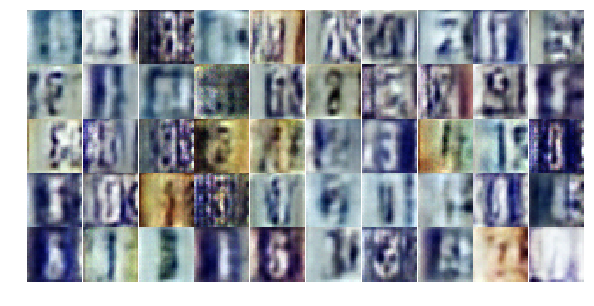

Epoch 5/25... Discriminator Loss: 0.3671... Generator Loss: 1.6889
Epoch 5/25... Discriminator Loss: 0.5933... Generator Loss: 1.5421
Epoch 5/25... Discriminator Loss: 0.6048... Generator Loss: 1.0800
Epoch 5/25... Discriminator Loss: 0.5584... Generator Loss: 1.2421
Epoch 5/25... Discriminator Loss: 0.6648... Generator Loss: 0.9412
Epoch 5/25... Discriminator Loss: 0.5094... Generator Loss: 1.5303
Epoch 5/25... Discriminator Loss: 0.8720... Generator Loss: 0.7603
Epoch 5/25... Discriminator Loss: 0.4493... Generator Loss: 1.6652
Epoch 5/25... Discriminator Loss: 0.9853... Generator Loss: 0.6768
Epoch 5/25... Discriminator Loss: 0.5086... Generator Loss: 1.2842


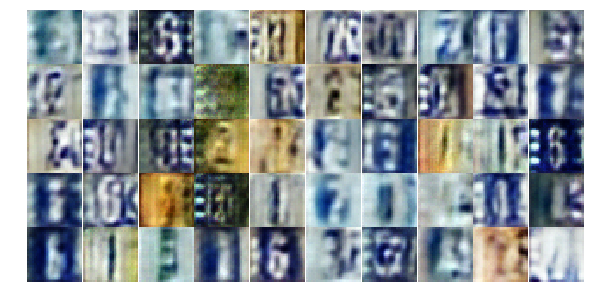

Epoch 5/25... Discriminator Loss: 0.6926... Generator Loss: 1.1500
Epoch 5/25... Discriminator Loss: 1.6724... Generator Loss: 0.3220
Epoch 5/25... Discriminator Loss: 0.7892... Generator Loss: 2.1647
Epoch 5/25... Discriminator Loss: 0.4615... Generator Loss: 1.3723
Epoch 5/25... Discriminator Loss: 0.5847... Generator Loss: 1.3067
Epoch 5/25... Discriminator Loss: 0.4827... Generator Loss: 2.3483
Epoch 5/25... Discriminator Loss: 1.0149... Generator Loss: 0.6118
Epoch 5/25... Discriminator Loss: 0.4193... Generator Loss: 1.5575
Epoch 5/25... Discriminator Loss: 1.1877... Generator Loss: 0.4752
Epoch 5/25... Discriminator Loss: 0.5404... Generator Loss: 1.2035


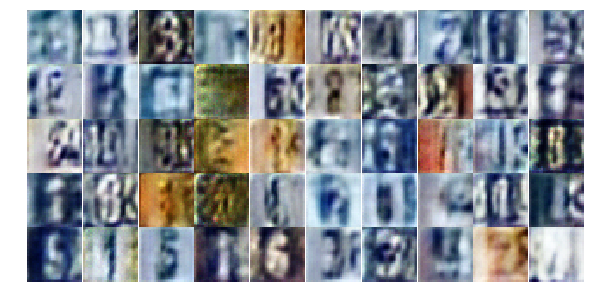

Epoch 5/25... Discriminator Loss: 0.4378... Generator Loss: 1.7619
Epoch 5/25... Discriminator Loss: 0.6367... Generator Loss: 0.9792
Epoch 5/25... Discriminator Loss: 1.6267... Generator Loss: 0.3149
Epoch 5/25... Discriminator Loss: 0.5830... Generator Loss: 2.5275
Epoch 5/25... Discriminator Loss: 0.7922... Generator Loss: 0.9911
Epoch 5/25... Discriminator Loss: 1.1010... Generator Loss: 0.5580
Epoch 5/25... Discriminator Loss: 0.6398... Generator Loss: 1.0454
Epoch 5/25... Discriminator Loss: 0.4802... Generator Loss: 1.8623
Epoch 5/25... Discriminator Loss: 0.5168... Generator Loss: 1.2066
Epoch 5/25... Discriminator Loss: 0.5354... Generator Loss: 1.1971


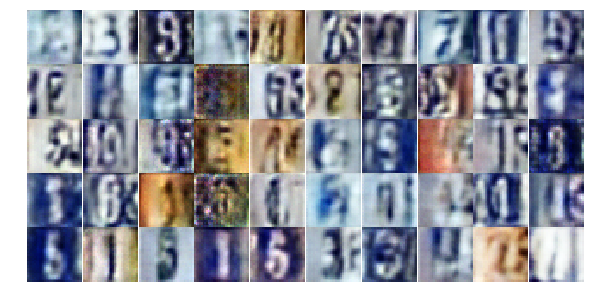

Epoch 5/25... Discriminator Loss: 1.3974... Generator Loss: 1.0832
Epoch 5/25... Discriminator Loss: 0.8398... Generator Loss: 0.7694
Epoch 5/25... Discriminator Loss: 0.6752... Generator Loss: 1.1215
Epoch 5/25... Discriminator Loss: 0.7094... Generator Loss: 0.8742
Epoch 5/25... Discriminator Loss: 0.7052... Generator Loss: 0.9040
Epoch 5/25... Discriminator Loss: 0.5524... Generator Loss: 1.2904
Epoch 6/25... Discriminator Loss: 0.5182... Generator Loss: 1.3595
Epoch 6/25... Discriminator Loss: 0.5072... Generator Loss: 1.3825
Epoch 6/25... Discriminator Loss: 0.6333... Generator Loss: 1.2061
Epoch 6/25... Discriminator Loss: 1.4878... Generator Loss: 0.3423


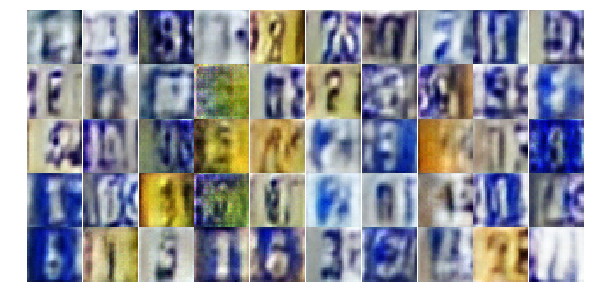

Epoch 6/25... Discriminator Loss: 1.3067... Generator Loss: 0.4331
Epoch 6/25... Discriminator Loss: 0.9095... Generator Loss: 0.8609
Epoch 6/25... Discriminator Loss: 0.5279... Generator Loss: 1.7950
Epoch 6/25... Discriminator Loss: 1.3588... Generator Loss: 0.4055
Epoch 6/25... Discriminator Loss: 0.8322... Generator Loss: 0.9911
Epoch 6/25... Discriminator Loss: 0.6857... Generator Loss: 1.0173
Epoch 6/25... Discriminator Loss: 0.5405... Generator Loss: 1.5255
Epoch 6/25... Discriminator Loss: 1.0381... Generator Loss: 0.6160
Epoch 6/25... Discriminator Loss: 0.7512... Generator Loss: 0.9720
Epoch 6/25... Discriminator Loss: 1.1433... Generator Loss: 1.6734


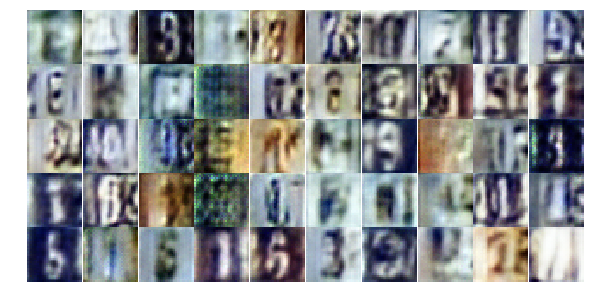

Epoch 6/25... Discriminator Loss: 0.9075... Generator Loss: 2.1146
Epoch 6/25... Discriminator Loss: 1.9884... Generator Loss: 0.2204
Epoch 6/25... Discriminator Loss: 0.7986... Generator Loss: 0.8135
Epoch 6/25... Discriminator Loss: 0.7738... Generator Loss: 0.9400
Epoch 6/25... Discriminator Loss: 0.4219... Generator Loss: 2.0006
Epoch 6/25... Discriminator Loss: 0.4709... Generator Loss: 1.4275
Epoch 6/25... Discriminator Loss: 0.6056... Generator Loss: 1.2761
Epoch 6/25... Discriminator Loss: 0.6473... Generator Loss: 1.1002
Epoch 6/25... Discriminator Loss: 0.4625... Generator Loss: 1.9241
Epoch 6/25... Discriminator Loss: 0.6509... Generator Loss: 1.3128


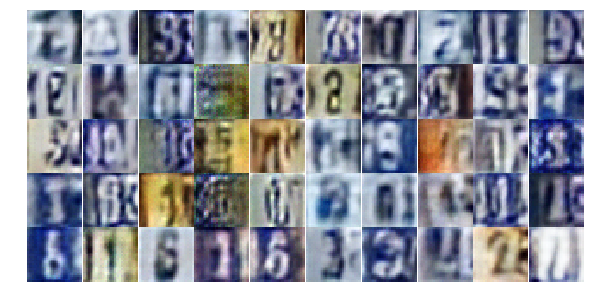

Epoch 6/25... Discriminator Loss: 1.0533... Generator Loss: 0.5489
Epoch 6/25... Discriminator Loss: 0.9989... Generator Loss: 0.6378
Epoch 6/25... Discriminator Loss: 0.8964... Generator Loss: 0.7448
Epoch 6/25... Discriminator Loss: 1.1652... Generator Loss: 0.5484
Epoch 6/25... Discriminator Loss: 1.2874... Generator Loss: 3.5706
Epoch 6/25... Discriminator Loss: 1.1141... Generator Loss: 0.6476
Epoch 6/25... Discriminator Loss: 0.7336... Generator Loss: 1.0416
Epoch 6/25... Discriminator Loss: 0.4240... Generator Loss: 1.5095
Epoch 6/25... Discriminator Loss: 0.4358... Generator Loss: 1.7294
Epoch 6/25... Discriminator Loss: 0.4069... Generator Loss: 1.6915


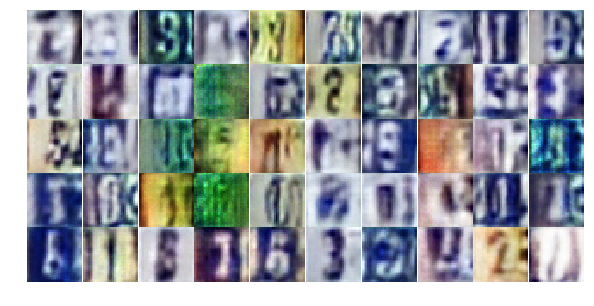

Epoch 6/25... Discriminator Loss: 1.1000... Generator Loss: 0.6226
Epoch 6/25... Discriminator Loss: 0.6102... Generator Loss: 1.4484
Epoch 6/25... Discriminator Loss: 1.3020... Generator Loss: 0.4740
Epoch 6/25... Discriminator Loss: 0.7805... Generator Loss: 0.9270
Epoch 6/25... Discriminator Loss: 1.1260... Generator Loss: 0.5252
Epoch 6/25... Discriminator Loss: 0.6340... Generator Loss: 1.2095
Epoch 6/25... Discriminator Loss: 0.3848... Generator Loss: 1.7255
Epoch 6/25... Discriminator Loss: 0.6178... Generator Loss: 1.1328
Epoch 6/25... Discriminator Loss: 0.7471... Generator Loss: 0.9582
Epoch 6/25... Discriminator Loss: 0.6518... Generator Loss: 0.9941


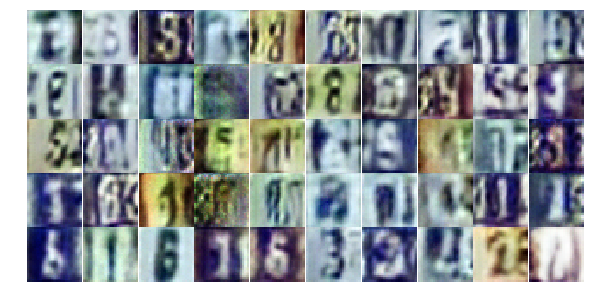

Epoch 6/25... Discriminator Loss: 0.6322... Generator Loss: 1.0728
Epoch 6/25... Discriminator Loss: 0.6855... Generator Loss: 1.0762
Epoch 6/25... Discriminator Loss: 0.7271... Generator Loss: 1.1273
Epoch 6/25... Discriminator Loss: 0.4017... Generator Loss: 1.7846
Epoch 6/25... Discriminator Loss: 0.4064... Generator Loss: 1.8159
Epoch 6/25... Discriminator Loss: 0.4832... Generator Loss: 1.3543
Epoch 6/25... Discriminator Loss: 0.5289... Generator Loss: 1.3289
Epoch 6/25... Discriminator Loss: 1.1095... Generator Loss: 0.5503
Epoch 6/25... Discriminator Loss: 0.8030... Generator Loss: 1.0378
Epoch 6/25... Discriminator Loss: 1.6496... Generator Loss: 0.2767


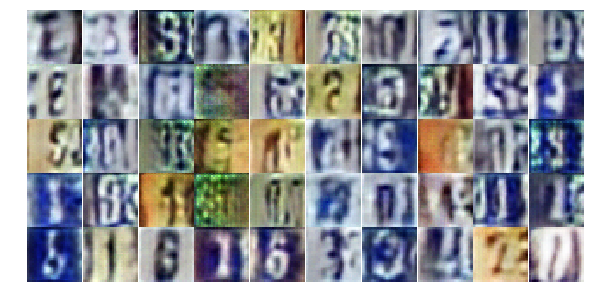

Epoch 6/25... Discriminator Loss: 0.4593... Generator Loss: 1.7595
Epoch 6/25... Discriminator Loss: 0.5858... Generator Loss: 1.1723
Epoch 6/25... Discriminator Loss: 0.6405... Generator Loss: 1.7748
Epoch 7/25... Discriminator Loss: 0.7262... Generator Loss: 0.9519
Epoch 7/25... Discriminator Loss: 0.6770... Generator Loss: 1.1369
Epoch 7/25... Discriminator Loss: 0.6933... Generator Loss: 1.0630
Epoch 7/25... Discriminator Loss: 0.7144... Generator Loss: 0.9201
Epoch 7/25... Discriminator Loss: 0.5106... Generator Loss: 1.6387
Epoch 7/25... Discriminator Loss: 0.3939... Generator Loss: 1.8503
Epoch 7/25... Discriminator Loss: 0.7222... Generator Loss: 1.3319


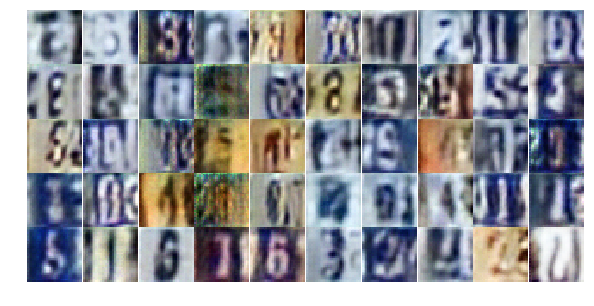

Epoch 7/25... Discriminator Loss: 0.5660... Generator Loss: 2.5618
Epoch 7/25... Discriminator Loss: 0.8668... Generator Loss: 0.7722
Epoch 7/25... Discriminator Loss: 0.6310... Generator Loss: 1.1477
Epoch 7/25... Discriminator Loss: 0.7157... Generator Loss: 1.5517
Epoch 7/25... Discriminator Loss: 0.5621... Generator Loss: 1.1806
Epoch 7/25... Discriminator Loss: 0.6420... Generator Loss: 1.0002
Epoch 7/25... Discriminator Loss: 1.3719... Generator Loss: 3.1341
Epoch 7/25... Discriminator Loss: 0.8860... Generator Loss: 1.8001
Epoch 7/25... Discriminator Loss: 0.7652... Generator Loss: 2.2584
Epoch 7/25... Discriminator Loss: 0.6941... Generator Loss: 2.1636


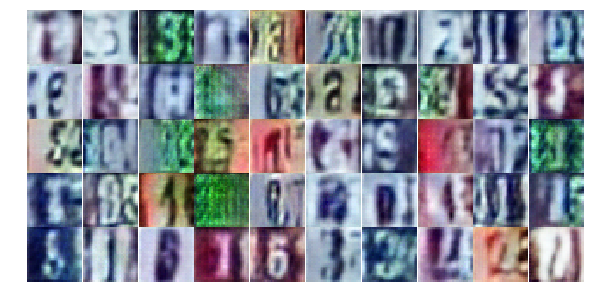

Epoch 7/25... Discriminator Loss: 0.7428... Generator Loss: 1.2879
Epoch 7/25... Discriminator Loss: 0.4637... Generator Loss: 1.9303
Epoch 7/25... Discriminator Loss: 0.8090... Generator Loss: 0.8624
Epoch 7/25... Discriminator Loss: 0.5831... Generator Loss: 1.1919
Epoch 7/25... Discriminator Loss: 0.4137... Generator Loss: 1.6190
Epoch 7/25... Discriminator Loss: 0.6676... Generator Loss: 1.0505
Epoch 7/25... Discriminator Loss: 0.5971... Generator Loss: 1.2058
Epoch 7/25... Discriminator Loss: 0.8008... Generator Loss: 0.8783
Epoch 7/25... Discriminator Loss: 0.4832... Generator Loss: 1.6038
Epoch 7/25... Discriminator Loss: 0.5330... Generator Loss: 1.5336


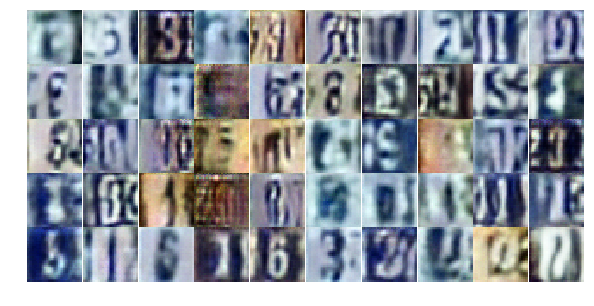

Epoch 7/25... Discriminator Loss: 1.0921... Generator Loss: 0.6020
Epoch 7/25... Discriminator Loss: 1.3346... Generator Loss: 0.4803
Epoch 7/25... Discriminator Loss: 0.4764... Generator Loss: 1.3732
Epoch 7/25... Discriminator Loss: 0.7446... Generator Loss: 0.8661
Epoch 7/25... Discriminator Loss: 1.2232... Generator Loss: 0.4507
Epoch 7/25... Discriminator Loss: 1.4378... Generator Loss: 0.4398
Epoch 7/25... Discriminator Loss: 0.6602... Generator Loss: 1.0195
Epoch 7/25... Discriminator Loss: 0.3527... Generator Loss: 2.0242
Epoch 7/25... Discriminator Loss: 0.8030... Generator Loss: 2.5650
Epoch 7/25... Discriminator Loss: 0.9542... Generator Loss: 3.0554


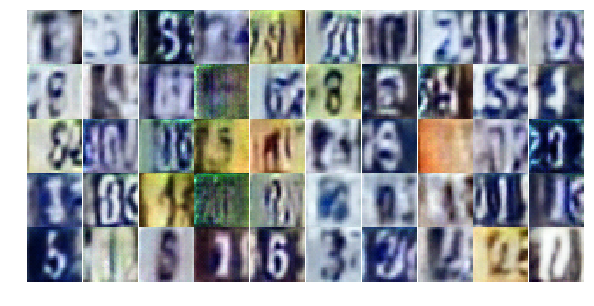

Epoch 7/25... Discriminator Loss: 2.3504... Generator Loss: 0.1695
Epoch 7/25... Discriminator Loss: 1.3083... Generator Loss: 0.5370
Epoch 7/25... Discriminator Loss: 0.3483... Generator Loss: 2.0522
Epoch 7/25... Discriminator Loss: 0.5191... Generator Loss: 1.3559
Epoch 7/25... Discriminator Loss: 0.6847... Generator Loss: 0.9673
Epoch 7/25... Discriminator Loss: 0.4163... Generator Loss: 1.5784
Epoch 7/25... Discriminator Loss: 0.3439... Generator Loss: 1.8956
Epoch 7/25... Discriminator Loss: 0.9485... Generator Loss: 2.0214
Epoch 7/25... Discriminator Loss: 0.4078... Generator Loss: 2.9689
Epoch 7/25... Discriminator Loss: 1.0701... Generator Loss: 0.5570


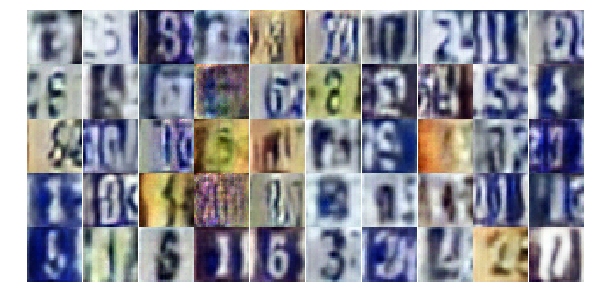

Epoch 7/25... Discriminator Loss: 0.3946... Generator Loss: 1.6066
Epoch 7/25... Discriminator Loss: 0.5219... Generator Loss: 1.3284
Epoch 7/25... Discriminator Loss: 0.9036... Generator Loss: 2.8378
Epoch 7/25... Discriminator Loss: 0.4848... Generator Loss: 1.3548
Epoch 7/25... Discriminator Loss: 0.4923... Generator Loss: 1.3421
Epoch 7/25... Discriminator Loss: 1.7548... Generator Loss: 0.3592
Epoch 7/25... Discriminator Loss: 1.2218... Generator Loss: 0.4960
Epoch 7/25... Discriminator Loss: 0.7761... Generator Loss: 0.9965
Epoch 7/25... Discriminator Loss: 0.8225... Generator Loss: 1.0458
Epoch 7/25... Discriminator Loss: 0.4294... Generator Loss: 1.5163


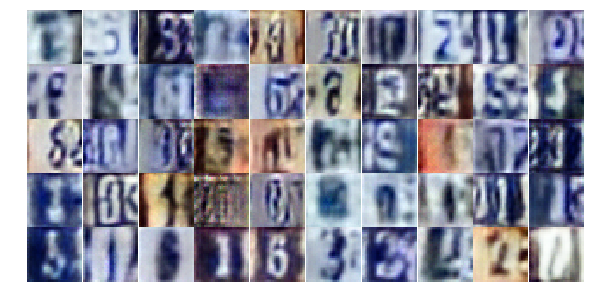

Epoch 7/25... Discriminator Loss: 0.5875... Generator Loss: 1.4780
Epoch 8/25... Discriminator Loss: 0.5496... Generator Loss: 1.1977
Epoch 8/25... Discriminator Loss: 0.9377... Generator Loss: 0.6469
Epoch 8/25... Discriminator Loss: 0.7285... Generator Loss: 0.9968
Epoch 8/25... Discriminator Loss: 0.4985... Generator Loss: 1.4070
Epoch 8/25... Discriminator Loss: 0.6997... Generator Loss: 1.6546
Epoch 8/25... Discriminator Loss: 0.9195... Generator Loss: 0.7135
Epoch 8/25... Discriminator Loss: 0.4696... Generator Loss: 1.7561
Epoch 8/25... Discriminator Loss: 0.8274... Generator Loss: 0.8000
Epoch 8/25... Discriminator Loss: 0.4522... Generator Loss: 1.3904


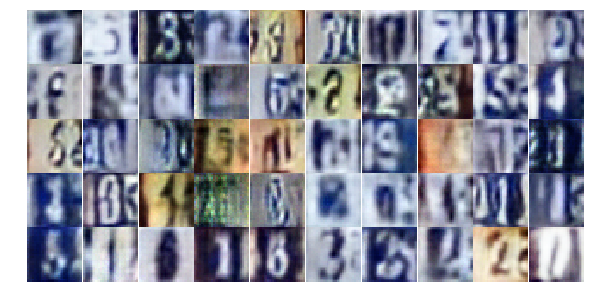

Epoch 8/25... Discriminator Loss: 0.5612... Generator Loss: 1.3392
Epoch 8/25... Discriminator Loss: 0.3891... Generator Loss: 2.6840
Epoch 8/25... Discriminator Loss: 1.1595... Generator Loss: 0.5087
Epoch 8/25... Discriminator Loss: 0.5260... Generator Loss: 2.5808
Epoch 8/25... Discriminator Loss: 0.7265... Generator Loss: 0.9887
Epoch 8/25... Discriminator Loss: 0.6558... Generator Loss: 2.0982
Epoch 8/25... Discriminator Loss: 0.5780... Generator Loss: 1.0058
Epoch 8/25... Discriminator Loss: 0.5920... Generator Loss: 1.3078
Epoch 8/25... Discriminator Loss: 0.5546... Generator Loss: 1.3136
Epoch 8/25... Discriminator Loss: 0.9805... Generator Loss: 0.6959


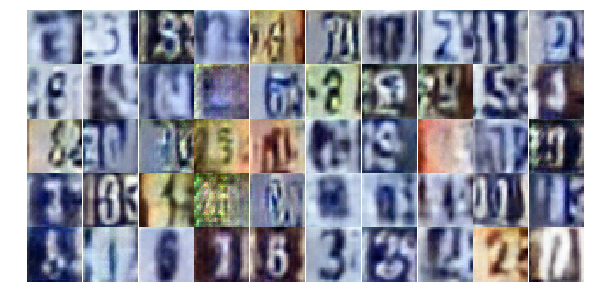

Epoch 8/25... Discriminator Loss: 0.4185... Generator Loss: 1.8186
Epoch 8/25... Discriminator Loss: 0.5180... Generator Loss: 1.2153
Epoch 8/25... Discriminator Loss: 0.5100... Generator Loss: 1.6436
Epoch 8/25... Discriminator Loss: 0.9124... Generator Loss: 1.9001
Epoch 8/25... Discriminator Loss: 0.3612... Generator Loss: 1.8338
Epoch 8/25... Discriminator Loss: 0.6937... Generator Loss: 2.3141
Epoch 8/25... Discriminator Loss: 0.6492... Generator Loss: 1.1522
Epoch 8/25... Discriminator Loss: 0.5441... Generator Loss: 1.1482
Epoch 8/25... Discriminator Loss: 0.5940... Generator Loss: 1.9985
Epoch 8/25... Discriminator Loss: 0.4818... Generator Loss: 2.0792


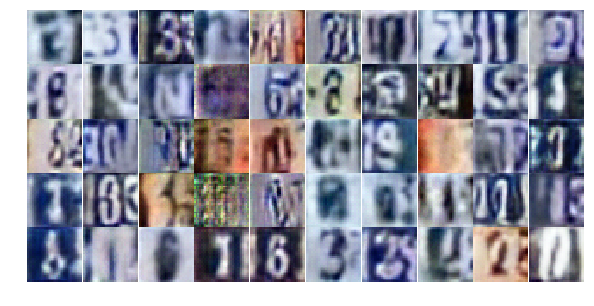

Epoch 8/25... Discriminator Loss: 0.6765... Generator Loss: 1.8703
Epoch 8/25... Discriminator Loss: 0.9474... Generator Loss: 0.6703
Epoch 8/25... Discriminator Loss: 0.4536... Generator Loss: 1.6537
Epoch 8/25... Discriminator Loss: 1.0000... Generator Loss: 0.6396
Epoch 8/25... Discriminator Loss: 0.5191... Generator Loss: 1.4192
Epoch 8/25... Discriminator Loss: 0.3204... Generator Loss: 1.8506
Epoch 8/25... Discriminator Loss: 0.5086... Generator Loss: 1.3987
Epoch 8/25... Discriminator Loss: 0.5989... Generator Loss: 1.1633
Epoch 8/25... Discriminator Loss: 0.6902... Generator Loss: 1.0553
Epoch 8/25... Discriminator Loss: 0.6939... Generator Loss: 0.9455


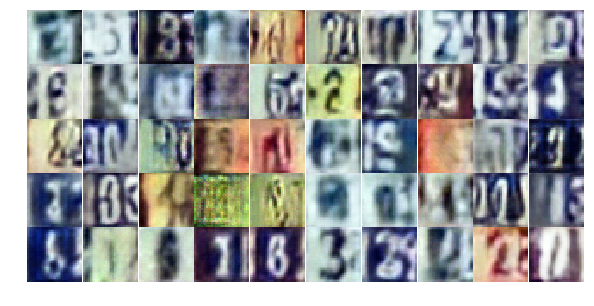

Epoch 8/25... Discriminator Loss: 0.3436... Generator Loss: 2.2578
Epoch 8/25... Discriminator Loss: 0.9244... Generator Loss: 0.7361
Epoch 8/25... Discriminator Loss: 0.5331... Generator Loss: 1.1426
Epoch 8/25... Discriminator Loss: 0.5853... Generator Loss: 1.1467
Epoch 8/25... Discriminator Loss: 0.5879... Generator Loss: 1.9388
Epoch 8/25... Discriminator Loss: 0.5917... Generator Loss: 1.2969
Epoch 8/25... Discriminator Loss: 2.6001... Generator Loss: 0.1414
Epoch 8/25... Discriminator Loss: 0.7082... Generator Loss: 2.1253
Epoch 8/25... Discriminator Loss: 0.7646... Generator Loss: 1.0366
Epoch 8/25... Discriminator Loss: 0.7748... Generator Loss: 0.8597


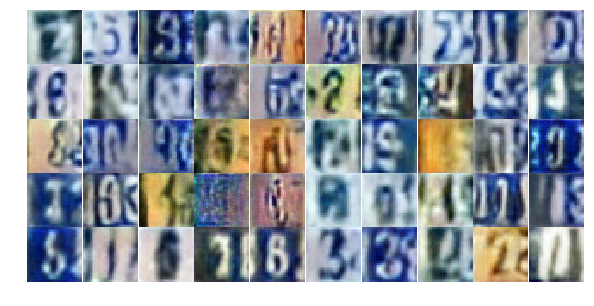

Epoch 8/25... Discriminator Loss: 0.6224... Generator Loss: 1.3701
Epoch 8/25... Discriminator Loss: 0.4752... Generator Loss: 1.5024
Epoch 8/25... Discriminator Loss: 0.7328... Generator Loss: 2.0993
Epoch 8/25... Discriminator Loss: 0.9720... Generator Loss: 0.6572
Epoch 8/25... Discriminator Loss: 0.3891... Generator Loss: 2.4830
Epoch 8/25... Discriminator Loss: 0.9487... Generator Loss: 0.7021
Epoch 8/25... Discriminator Loss: 0.6712... Generator Loss: 1.0491
Epoch 8/25... Discriminator Loss: 0.6813... Generator Loss: 2.3656
Epoch 9/25... Discriminator Loss: 0.7543... Generator Loss: 1.2107
Epoch 9/25... Discriminator Loss: 0.7549... Generator Loss: 1.0066


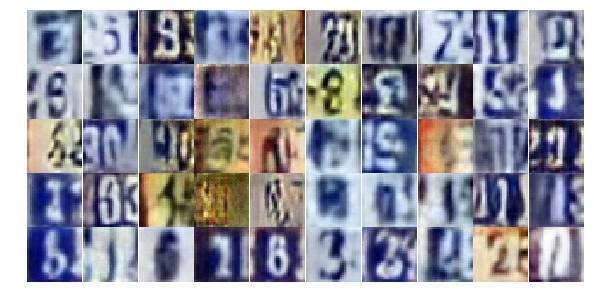

Epoch 9/25... Discriminator Loss: 0.9715... Generator Loss: 0.6339
Epoch 9/25... Discriminator Loss: 0.5376... Generator Loss: 1.2808
Epoch 9/25... Discriminator Loss: 0.9317... Generator Loss: 0.6878
Epoch 9/25... Discriminator Loss: 0.3567... Generator Loss: 2.0585
Epoch 9/25... Discriminator Loss: 0.8209... Generator Loss: 0.8050
Epoch 9/25... Discriminator Loss: 0.4823... Generator Loss: 1.5921
Epoch 9/25... Discriminator Loss: 0.6147... Generator Loss: 1.0428
Epoch 9/25... Discriminator Loss: 0.4834... Generator Loss: 1.2906
Epoch 9/25... Discriminator Loss: 0.7192... Generator Loss: 0.9198
Epoch 9/25... Discriminator Loss: 0.8333... Generator Loss: 0.8077


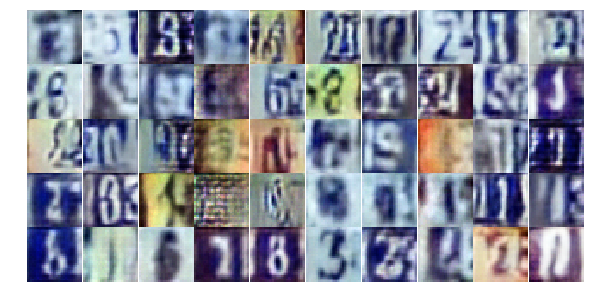

Epoch 9/25... Discriminator Loss: 0.9028... Generator Loss: 0.7233
Epoch 9/25... Discriminator Loss: 1.4637... Generator Loss: 0.3491
Epoch 9/25... Discriminator Loss: 1.3077... Generator Loss: 0.4766
Epoch 9/25... Discriminator Loss: 0.8822... Generator Loss: 1.5080
Epoch 9/25... Discriminator Loss: 0.7726... Generator Loss: 0.9388
Epoch 9/25... Discriminator Loss: 0.9876... Generator Loss: 0.7304
Epoch 9/25... Discriminator Loss: 0.8624... Generator Loss: 0.7899
Epoch 9/25... Discriminator Loss: 0.4506... Generator Loss: 1.4750
Epoch 9/25... Discriminator Loss: 1.0465... Generator Loss: 0.5756
Epoch 9/25... Discriminator Loss: 0.8612... Generator Loss: 0.7687


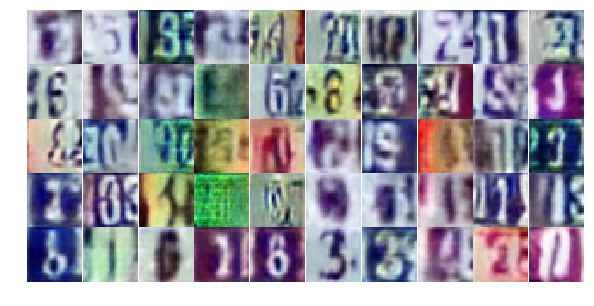

Epoch 9/25... Discriminator Loss: 0.9984... Generator Loss: 0.7105
Epoch 9/25... Discriminator Loss: 0.7333... Generator Loss: 1.0947
Epoch 9/25... Discriminator Loss: 0.5752... Generator Loss: 1.4917
Epoch 9/25... Discriminator Loss: 0.6516... Generator Loss: 0.9361
Epoch 9/25... Discriminator Loss: 0.5115... Generator Loss: 1.3428
Epoch 9/25... Discriminator Loss: 0.4448... Generator Loss: 1.9581
Epoch 9/25... Discriminator Loss: 0.7919... Generator Loss: 1.1424
Epoch 9/25... Discriminator Loss: 0.6621... Generator Loss: 1.0957
Epoch 9/25... Discriminator Loss: 0.6501... Generator Loss: 1.0437
Epoch 9/25... Discriminator Loss: 0.6281... Generator Loss: 0.9904


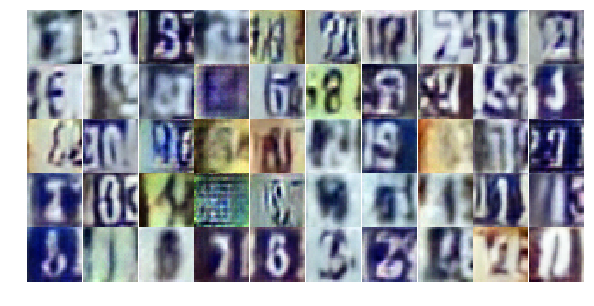

Epoch 9/25... Discriminator Loss: 0.5077... Generator Loss: 1.8221
Epoch 9/25... Discriminator Loss: 0.6388... Generator Loss: 1.3457
Epoch 9/25... Discriminator Loss: 0.9033... Generator Loss: 1.2646
Epoch 9/25... Discriminator Loss: 0.4831... Generator Loss: 1.3671
Epoch 9/25... Discriminator Loss: 0.5905... Generator Loss: 1.0788
Epoch 9/25... Discriminator Loss: 0.6622... Generator Loss: 1.1289
Epoch 9/25... Discriminator Loss: 0.5717... Generator Loss: 1.1874
Epoch 9/25... Discriminator Loss: 0.3565... Generator Loss: 1.6770
Epoch 9/25... Discriminator Loss: 0.7386... Generator Loss: 0.9868
Epoch 9/25... Discriminator Loss: 0.8440... Generator Loss: 0.7917


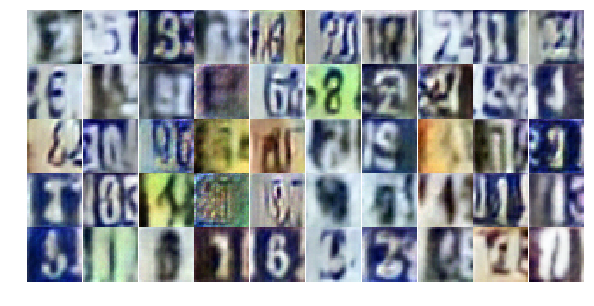

Epoch 9/25... Discriminator Loss: 0.5331... Generator Loss: 1.2741
Epoch 9/25... Discriminator Loss: 0.7345... Generator Loss: 3.1906
Epoch 9/25... Discriminator Loss: 0.6132... Generator Loss: 1.1679
Epoch 9/25... Discriminator Loss: 0.8410... Generator Loss: 0.9374
Epoch 9/25... Discriminator Loss: 0.2290... Generator Loss: 2.7873
Epoch 9/25... Discriminator Loss: 0.9592... Generator Loss: 0.6336
Epoch 9/25... Discriminator Loss: 0.6014... Generator Loss: 1.6760
Epoch 9/25... Discriminator Loss: 0.6555... Generator Loss: 1.0234
Epoch 9/25... Discriminator Loss: 0.5223... Generator Loss: 1.2135
Epoch 9/25... Discriminator Loss: 0.7854... Generator Loss: 2.9762


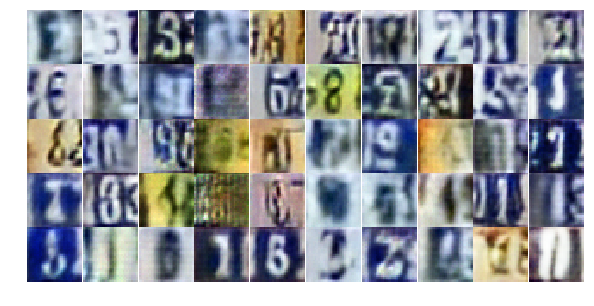

Epoch 9/25... Discriminator Loss: 1.6747... Generator Loss: 1.3665
Epoch 9/25... Discriminator Loss: 1.0463... Generator Loss: 2.8874
Epoch 9/25... Discriminator Loss: 0.5840... Generator Loss: 1.4007
Epoch 9/25... Discriminator Loss: 1.3894... Generator Loss: 0.3846
Epoch 9/25... Discriminator Loss: 0.5037... Generator Loss: 1.5463
Epoch 10/25... Discriminator Loss: 0.4715... Generator Loss: 1.4844
Epoch 10/25... Discriminator Loss: 0.4223... Generator Loss: 1.6403
Epoch 10/25... Discriminator Loss: 1.2063... Generator Loss: 0.4869
Epoch 10/25... Discriminator Loss: 0.9995... Generator Loss: 0.6753
Epoch 10/25... Discriminator Loss: 1.1121... Generator Loss: 0.4997


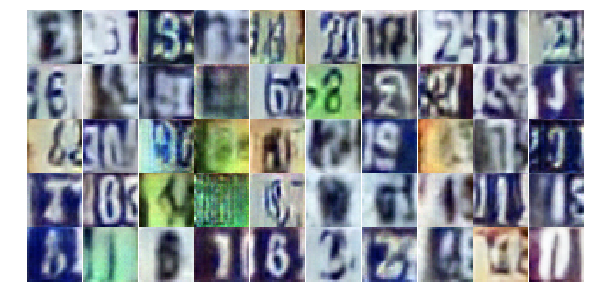

Epoch 10/25... Discriminator Loss: 1.0296... Generator Loss: 0.6260
Epoch 10/25... Discriminator Loss: 0.4385... Generator Loss: 1.6132
Epoch 10/25... Discriminator Loss: 0.6366... Generator Loss: 1.0467
Epoch 10/25... Discriminator Loss: 0.5566... Generator Loss: 1.9368
Epoch 10/25... Discriminator Loss: 0.5828... Generator Loss: 1.3701
Epoch 10/25... Discriminator Loss: 0.6934... Generator Loss: 1.0376
Epoch 10/25... Discriminator Loss: 0.4370... Generator Loss: 1.5474
Epoch 10/25... Discriminator Loss: 1.2110... Generator Loss: 0.5799
Epoch 10/25... Discriminator Loss: 0.7033... Generator Loss: 1.1111
Epoch 10/25... Discriminator Loss: 0.6325... Generator Loss: 1.1122


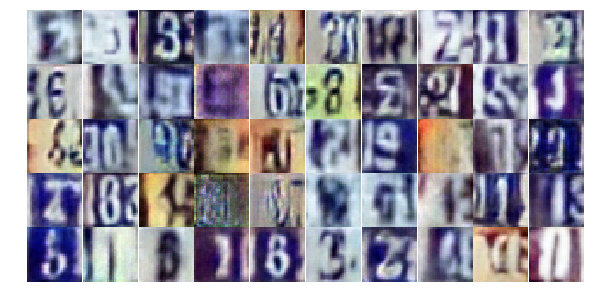

Epoch 10/25... Discriminator Loss: 0.5612... Generator Loss: 1.6997
Epoch 10/25... Discriminator Loss: 1.0035... Generator Loss: 0.6223
Epoch 10/25... Discriminator Loss: 0.6057... Generator Loss: 1.1801
Epoch 10/25... Discriminator Loss: 1.4752... Generator Loss: 0.3561
Epoch 10/25... Discriminator Loss: 0.6660... Generator Loss: 1.4964
Epoch 10/25... Discriminator Loss: 0.5485... Generator Loss: 1.2137
Epoch 10/25... Discriminator Loss: 0.8157... Generator Loss: 0.8112
Epoch 10/25... Discriminator Loss: 0.5171... Generator Loss: 1.4536
Epoch 10/25... Discriminator Loss: 0.5144... Generator Loss: 1.4679
Epoch 10/25... Discriminator Loss: 0.4243... Generator Loss: 3.1459


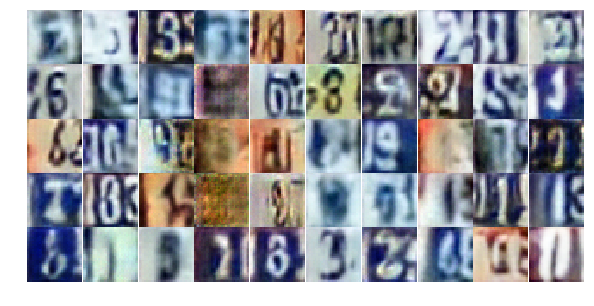

Epoch 10/25... Discriminator Loss: 1.0193... Generator Loss: 0.6739
Epoch 10/25... Discriminator Loss: 1.0299... Generator Loss: 0.7069
Epoch 10/25... Discriminator Loss: 0.3413... Generator Loss: 2.3500
Epoch 10/25... Discriminator Loss: 1.1935... Generator Loss: 3.8771
Epoch 10/25... Discriminator Loss: 1.3445... Generator Loss: 0.4692
Epoch 10/25... Discriminator Loss: 0.5485... Generator Loss: 1.2931
Epoch 10/25... Discriminator Loss: 0.3793... Generator Loss: 1.5650
Epoch 10/25... Discriminator Loss: 0.6941... Generator Loss: 1.4134
Epoch 10/25... Discriminator Loss: 0.6787... Generator Loss: 1.0444
Epoch 10/25... Discriminator Loss: 0.6657... Generator Loss: 0.9182


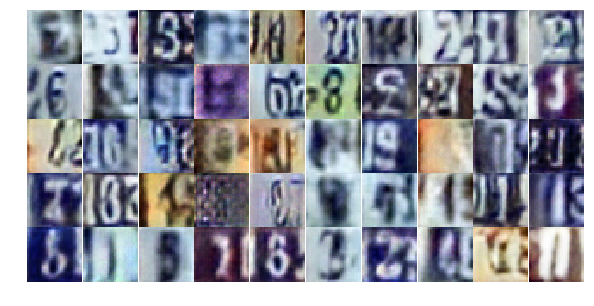

Epoch 10/25... Discriminator Loss: 0.4717... Generator Loss: 2.1704
Epoch 10/25... Discriminator Loss: 0.6765... Generator Loss: 1.1602
Epoch 10/25... Discriminator Loss: 0.5525... Generator Loss: 1.3297
Epoch 10/25... Discriminator Loss: 0.5976... Generator Loss: 1.3414
Epoch 10/25... Discriminator Loss: 0.7164... Generator Loss: 0.9771
Epoch 10/25... Discriminator Loss: 0.6516... Generator Loss: 1.0034
Epoch 10/25... Discriminator Loss: 0.5101... Generator Loss: 1.4591
Epoch 10/25... Discriminator Loss: 1.2356... Generator Loss: 0.4480
Epoch 10/25... Discriminator Loss: 0.8234... Generator Loss: 0.7553
Epoch 10/25... Discriminator Loss: 1.1230... Generator Loss: 2.0574


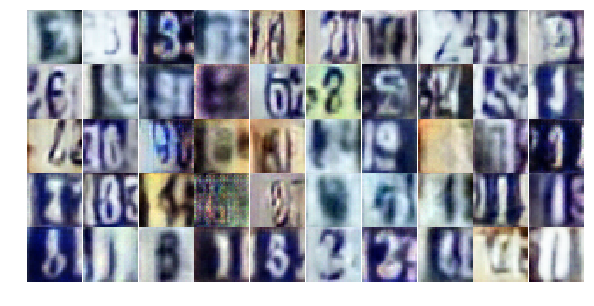

Epoch 10/25... Discriminator Loss: 0.5976... Generator Loss: 1.2562
Epoch 10/25... Discriminator Loss: 0.5756... Generator Loss: 1.2450
Epoch 10/25... Discriminator Loss: 0.9251... Generator Loss: 0.6963
Epoch 10/25... Discriminator Loss: 0.8666... Generator Loss: 0.7816
Epoch 10/25... Discriminator Loss: 0.5046... Generator Loss: 1.5355
Epoch 10/25... Discriminator Loss: 0.7120... Generator Loss: 0.9756
Epoch 10/25... Discriminator Loss: 0.4306... Generator Loss: 1.6874
Epoch 10/25... Discriminator Loss: 0.3458... Generator Loss: 1.7427
Epoch 10/25... Discriminator Loss: 0.6914... Generator Loss: 2.4744
Epoch 10/25... Discriminator Loss: 0.5632... Generator Loss: 1.3769


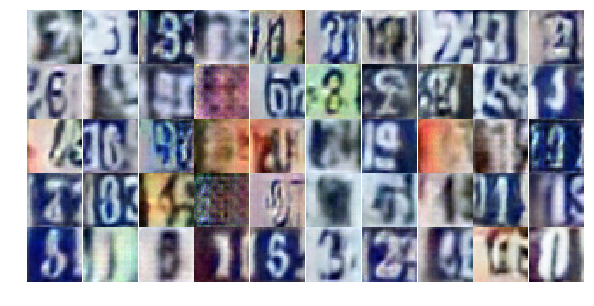

Epoch 10/25... Discriminator Loss: 0.7415... Generator Loss: 1.0830
Epoch 10/25... Discriminator Loss: 0.6092... Generator Loss: 1.0627
Epoch 10/25... Discriminator Loss: 0.4610... Generator Loss: 1.4381
Epoch 11/25... Discriminator Loss: 0.8348... Generator Loss: 0.9122
Epoch 11/25... Discriminator Loss: 0.6094... Generator Loss: 1.1012
Epoch 11/25... Discriminator Loss: 1.5758... Generator Loss: 0.3208
Epoch 11/25... Discriminator Loss: 0.9015... Generator Loss: 0.6682
Epoch 11/25... Discriminator Loss: 0.6562... Generator Loss: 1.1241
Epoch 11/25... Discriminator Loss: 1.5734... Generator Loss: 0.4631
Epoch 11/25... Discriminator Loss: 0.6824... Generator Loss: 0.9796


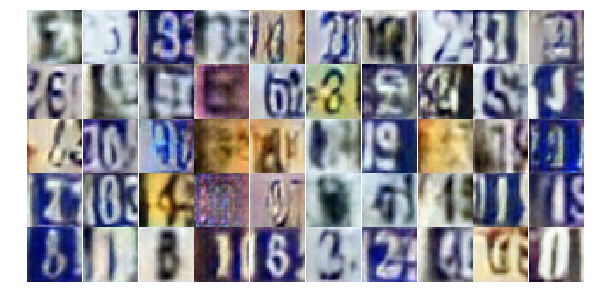

Epoch 11/25... Discriminator Loss: 0.4149... Generator Loss: 1.4031
Epoch 11/25... Discriminator Loss: 0.6068... Generator Loss: 1.3161
Epoch 11/25... Discriminator Loss: 0.5435... Generator Loss: 1.2038
Epoch 11/25... Discriminator Loss: 0.8562... Generator Loss: 0.7778
Epoch 11/25... Discriminator Loss: 1.2779... Generator Loss: 0.4483
Epoch 11/25... Discriminator Loss: 0.4511... Generator Loss: 1.5375
Epoch 11/25... Discriminator Loss: 0.6999... Generator Loss: 1.3327
Epoch 11/25... Discriminator Loss: 0.4521... Generator Loss: 1.6891
Epoch 11/25... Discriminator Loss: 0.7655... Generator Loss: 0.8088
Epoch 11/25... Discriminator Loss: 1.0549... Generator Loss: 0.6080


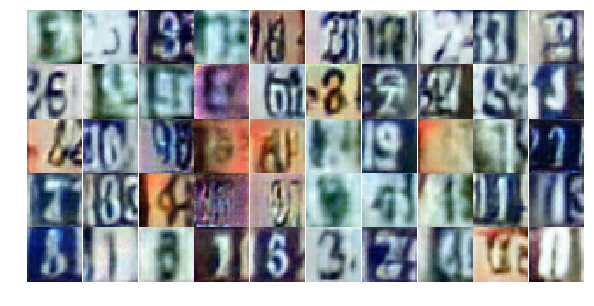

Epoch 11/25... Discriminator Loss: 0.9990... Generator Loss: 0.6393
Epoch 11/25... Discriminator Loss: 0.4458... Generator Loss: 2.0430
Epoch 11/25... Discriminator Loss: 1.1232... Generator Loss: 0.5959
Epoch 11/25... Discriminator Loss: 0.5154... Generator Loss: 1.2332
Epoch 11/25... Discriminator Loss: 0.3827... Generator Loss: 1.6701
Epoch 11/25... Discriminator Loss: 0.4464... Generator Loss: 1.8709
Epoch 11/25... Discriminator Loss: 0.5856... Generator Loss: 1.7270
Epoch 11/25... Discriminator Loss: 1.0194... Generator Loss: 0.6817
Epoch 11/25... Discriminator Loss: 0.4059... Generator Loss: 1.4028
Epoch 11/25... Discriminator Loss: 0.9583... Generator Loss: 0.6596


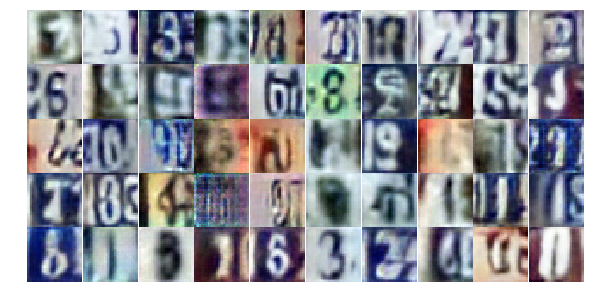

Epoch 11/25... Discriminator Loss: 0.9595... Generator Loss: 0.7128
Epoch 11/25... Discriminator Loss: 0.6845... Generator Loss: 1.3797
Epoch 11/25... Discriminator Loss: 1.2760... Generator Loss: 0.4638
Epoch 11/25... Discriminator Loss: 0.4953... Generator Loss: 1.3441
Epoch 11/25... Discriminator Loss: 0.7090... Generator Loss: 0.9580
Epoch 11/25... Discriminator Loss: 0.8158... Generator Loss: 0.8160
Epoch 11/25... Discriminator Loss: 1.2684... Generator Loss: 0.4854
Epoch 11/25... Discriminator Loss: 0.9281... Generator Loss: 0.8594
Epoch 11/25... Discriminator Loss: 0.3819... Generator Loss: 1.6918
Epoch 11/25... Discriminator Loss: 1.5096... Generator Loss: 0.3235


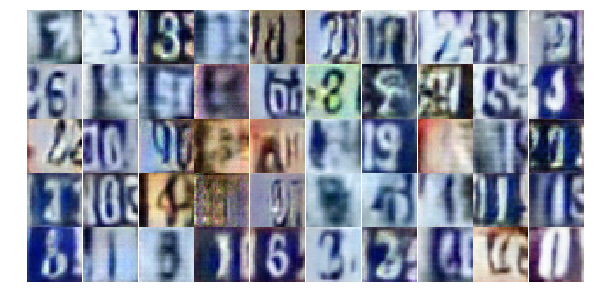

Epoch 11/25... Discriminator Loss: 0.4846... Generator Loss: 1.5204
Epoch 11/25... Discriminator Loss: 0.4819... Generator Loss: 1.3202
Epoch 11/25... Discriminator Loss: 0.6610... Generator Loss: 0.9813
Epoch 11/25... Discriminator Loss: 0.5999... Generator Loss: 1.1865
Epoch 11/25... Discriminator Loss: 0.5858... Generator Loss: 1.4328
Epoch 11/25... Discriminator Loss: 0.5560... Generator Loss: 1.3230
Epoch 11/25... Discriminator Loss: 0.4456... Generator Loss: 1.6044
Epoch 11/25... Discriminator Loss: 1.0017... Generator Loss: 3.2615
Epoch 11/25... Discriminator Loss: 1.6979... Generator Loss: 0.3079
Epoch 11/25... Discriminator Loss: 0.8218... Generator Loss: 0.8450


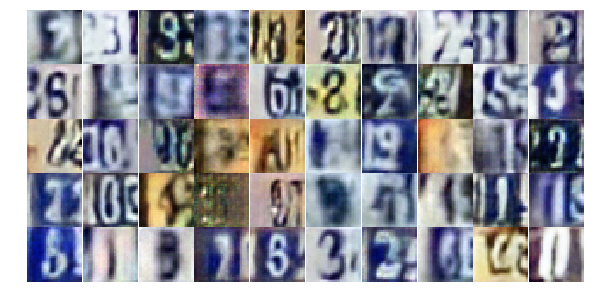

Epoch 11/25... Discriminator Loss: 0.8610... Generator Loss: 0.8306
Epoch 11/25... Discriminator Loss: 0.3177... Generator Loss: 2.0516
Epoch 11/25... Discriminator Loss: 0.5789... Generator Loss: 1.2403
Epoch 11/25... Discriminator Loss: 0.5436... Generator Loss: 1.2054
Epoch 11/25... Discriminator Loss: 1.5617... Generator Loss: 0.3628
Epoch 11/25... Discriminator Loss: 0.8289... Generator Loss: 0.8227
Epoch 11/25... Discriminator Loss: 0.6563... Generator Loss: 1.0086
Epoch 11/25... Discriminator Loss: 0.4112... Generator Loss: 1.6022
Epoch 11/25... Discriminator Loss: 1.0619... Generator Loss: 0.6012
Epoch 11/25... Discriminator Loss: 0.6781... Generator Loss: 1.1248


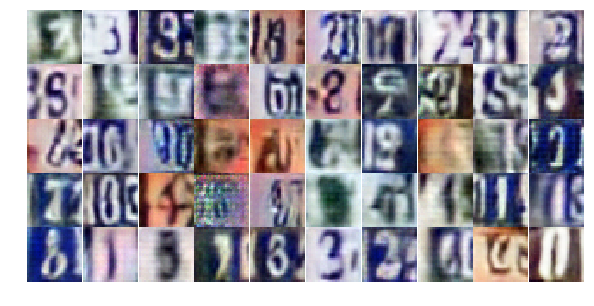

Epoch 12/25... Discriminator Loss: 0.4956... Generator Loss: 1.3243
Epoch 12/25... Discriminator Loss: 0.6442... Generator Loss: 1.3275
Epoch 12/25... Discriminator Loss: 1.1215... Generator Loss: 0.5246
Epoch 12/25... Discriminator Loss: 0.6963... Generator Loss: 1.0059
Epoch 12/25... Discriminator Loss: 0.4721... Generator Loss: 1.7692
Epoch 12/25... Discriminator Loss: 1.2994... Generator Loss: 0.4289
Epoch 12/25... Discriminator Loss: 0.5642... Generator Loss: 2.3781
Epoch 12/25... Discriminator Loss: 0.6423... Generator Loss: 1.3040
Epoch 12/25... Discriminator Loss: 0.8724... Generator Loss: 0.7710
Epoch 12/25... Discriminator Loss: 1.1965... Generator Loss: 0.5217


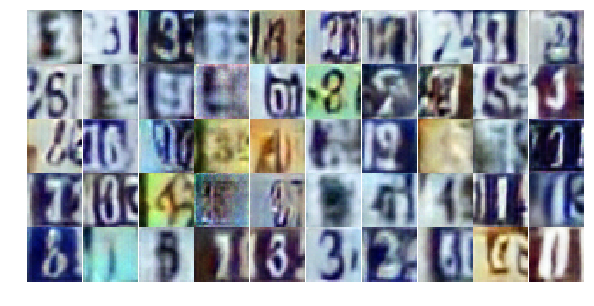

Epoch 12/25... Discriminator Loss: 0.6013... Generator Loss: 1.0390
Epoch 12/25... Discriminator Loss: 0.7933... Generator Loss: 0.8827
Epoch 12/25... Discriminator Loss: 0.4852... Generator Loss: 1.3308
Epoch 12/25... Discriminator Loss: 0.7042... Generator Loss: 1.0277
Epoch 12/25... Discriminator Loss: 0.4079... Generator Loss: 2.0073
Epoch 12/25... Discriminator Loss: 0.8935... Generator Loss: 0.8325
Epoch 12/25... Discriminator Loss: 0.8553... Generator Loss: 0.7646
Epoch 12/25... Discriminator Loss: 0.4276... Generator Loss: 2.0466
Epoch 12/25... Discriminator Loss: 0.4742... Generator Loss: 1.3737
Epoch 12/25... Discriminator Loss: 0.8889... Generator Loss: 0.7731


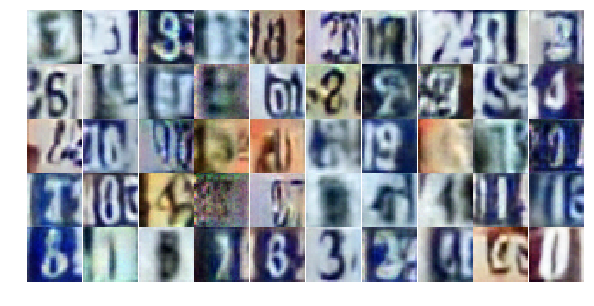

Epoch 12/25... Discriminator Loss: 0.3253... Generator Loss: 1.6436
Epoch 12/25... Discriminator Loss: 0.4089... Generator Loss: 2.0081
Epoch 12/25... Discriminator Loss: 1.2305... Generator Loss: 0.4848
Epoch 12/25... Discriminator Loss: 0.6865... Generator Loss: 2.4780
Epoch 12/25... Discriminator Loss: 0.4489... Generator Loss: 1.7680
Epoch 12/25... Discriminator Loss: 0.5189... Generator Loss: 1.3232
Epoch 12/25... Discriminator Loss: 0.9312... Generator Loss: 0.6561
Epoch 12/25... Discriminator Loss: 0.2861... Generator Loss: 1.8080
Epoch 12/25... Discriminator Loss: 0.5521... Generator Loss: 1.1308
Epoch 12/25... Discriminator Loss: 0.5398... Generator Loss: 1.2222


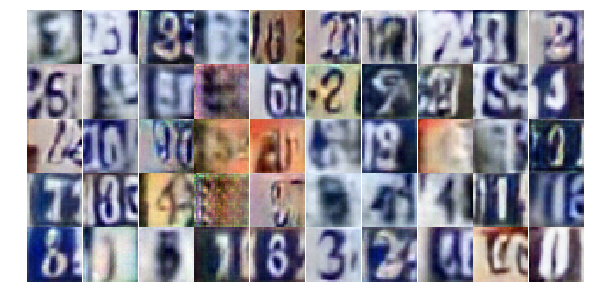

Epoch 12/25... Discriminator Loss: 0.5282... Generator Loss: 1.2423
Epoch 12/25... Discriminator Loss: 0.8211... Generator Loss: 0.8342
Epoch 12/25... Discriminator Loss: 0.8074... Generator Loss: 0.8040
Epoch 12/25... Discriminator Loss: 1.9883... Generator Loss: 0.2160
Epoch 12/25... Discriminator Loss: 1.2678... Generator Loss: 2.5110
Epoch 12/25... Discriminator Loss: 1.2531... Generator Loss: 3.3706
Epoch 12/25... Discriminator Loss: 0.9117... Generator Loss: 0.7522
Epoch 12/25... Discriminator Loss: 0.8805... Generator Loss: 0.7990
Epoch 12/25... Discriminator Loss: 0.6460... Generator Loss: 1.5708
Epoch 12/25... Discriminator Loss: 0.3684... Generator Loss: 1.6199


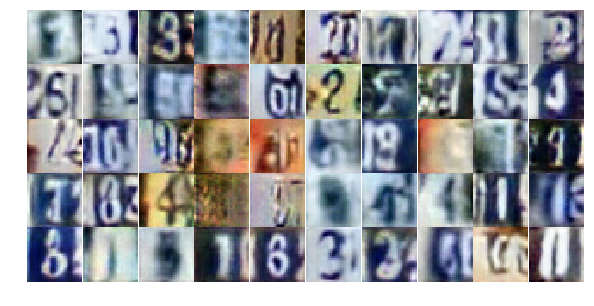

Epoch 12/25... Discriminator Loss: 0.5158... Generator Loss: 1.3206
Epoch 12/25... Discriminator Loss: 0.4756... Generator Loss: 1.3159
Epoch 12/25... Discriminator Loss: 0.4474... Generator Loss: 1.4614
Epoch 12/25... Discriminator Loss: 0.6560... Generator Loss: 1.1617
Epoch 12/25... Discriminator Loss: 0.7133... Generator Loss: 1.1964
Epoch 12/25... Discriminator Loss: 1.3561... Generator Loss: 0.3835
Epoch 12/25... Discriminator Loss: 0.7818... Generator Loss: 1.2396
Epoch 12/25... Discriminator Loss: 1.0020... Generator Loss: 0.6924
Epoch 12/25... Discriminator Loss: 0.5458... Generator Loss: 1.3569
Epoch 12/25... Discriminator Loss: 0.7118... Generator Loss: 0.9533


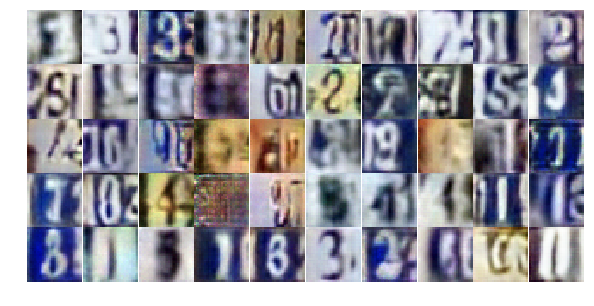

Epoch 12/25... Discriminator Loss: 0.7727... Generator Loss: 0.9133
Epoch 12/25... Discriminator Loss: 0.5587... Generator Loss: 1.2899
Epoch 12/25... Discriminator Loss: 0.6781... Generator Loss: 2.9072
Epoch 12/25... Discriminator Loss: 1.0912... Generator Loss: 0.5753
Epoch 12/25... Discriminator Loss: 0.4256... Generator Loss: 1.4863
Epoch 12/25... Discriminator Loss: 0.6511... Generator Loss: 1.9996
Epoch 12/25... Discriminator Loss: 1.4011... Generator Loss: 0.4016
Epoch 13/25... Discriminator Loss: 0.6225... Generator Loss: 1.2633
Epoch 13/25... Discriminator Loss: 0.4555... Generator Loss: 1.5709
Epoch 13/25... Discriminator Loss: 0.8649... Generator Loss: 0.7921


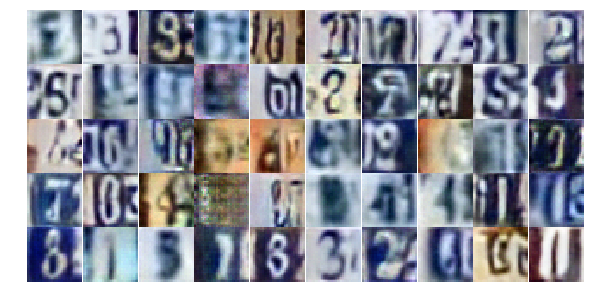

Epoch 13/25... Discriminator Loss: 0.5682... Generator Loss: 1.2988
Epoch 13/25... Discriminator Loss: 0.6970... Generator Loss: 1.1695
Epoch 13/25... Discriminator Loss: 0.9403... Generator Loss: 0.8035
Epoch 13/25... Discriminator Loss: 1.0119... Generator Loss: 1.0670
Epoch 13/25... Discriminator Loss: 0.6072... Generator Loss: 1.1517
Epoch 13/25... Discriminator Loss: 0.4625... Generator Loss: 1.4499
Epoch 13/25... Discriminator Loss: 0.4387... Generator Loss: 2.0106
Epoch 13/25... Discriminator Loss: 0.5565... Generator Loss: 1.2712
Epoch 13/25... Discriminator Loss: 0.6068... Generator Loss: 1.1074
Epoch 13/25... Discriminator Loss: 0.5705... Generator Loss: 2.6249


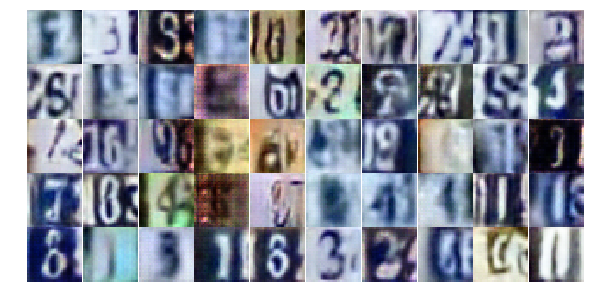

Epoch 13/25... Discriminator Loss: 1.8832... Generator Loss: 3.5379
Epoch 13/25... Discriminator Loss: 0.6964... Generator Loss: 1.0418
Epoch 13/25... Discriminator Loss: 1.1313... Generator Loss: 0.5108
Epoch 13/25... Discriminator Loss: 0.7156... Generator Loss: 1.0785
Epoch 13/25... Discriminator Loss: 0.9396... Generator Loss: 0.7108
Epoch 13/25... Discriminator Loss: 0.8787... Generator Loss: 0.7302
Epoch 13/25... Discriminator Loss: 0.6539... Generator Loss: 1.4757
Epoch 13/25... Discriminator Loss: 1.2314... Generator Loss: 0.5044
Epoch 13/25... Discriminator Loss: 0.8624... Generator Loss: 0.7339
Epoch 13/25... Discriminator Loss: 0.9547... Generator Loss: 0.6618


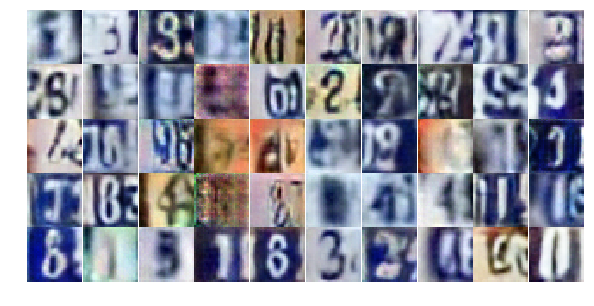

Epoch 13/25... Discriminator Loss: 0.6897... Generator Loss: 0.9482
Epoch 13/25... Discriminator Loss: 0.4953... Generator Loss: 2.0038
Epoch 13/25... Discriminator Loss: 0.5061... Generator Loss: 2.6994
Epoch 13/25... Discriminator Loss: 0.6189... Generator Loss: 1.0060
Epoch 13/25... Discriminator Loss: 0.5618... Generator Loss: 1.2701
Epoch 13/25... Discriminator Loss: 0.7119... Generator Loss: 1.0916
Epoch 13/25... Discriminator Loss: 0.7744... Generator Loss: 1.6351
Epoch 13/25... Discriminator Loss: 0.5322... Generator Loss: 1.2374
Epoch 13/25... Discriminator Loss: 0.7635... Generator Loss: 0.8581
Epoch 13/25... Discriminator Loss: 0.5738... Generator Loss: 1.9161


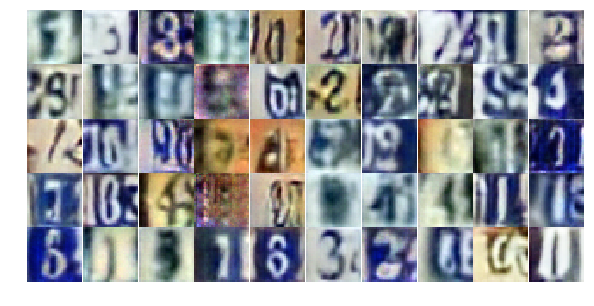

Epoch 13/25... Discriminator Loss: 1.0855... Generator Loss: 0.5586
Epoch 13/25... Discriminator Loss: 0.9894... Generator Loss: 0.6981
Epoch 13/25... Discriminator Loss: 1.1462... Generator Loss: 0.5180
Epoch 13/25... Discriminator Loss: 1.2314... Generator Loss: 0.4785
Epoch 13/25... Discriminator Loss: 0.7359... Generator Loss: 1.1493
Epoch 13/25... Discriminator Loss: 0.2838... Generator Loss: 2.1568
Epoch 13/25... Discriminator Loss: 0.6769... Generator Loss: 0.9848
Epoch 13/25... Discriminator Loss: 0.7229... Generator Loss: 0.9748
Epoch 13/25... Discriminator Loss: 0.6685... Generator Loss: 1.1970
Epoch 13/25... Discriminator Loss: 0.5657... Generator Loss: 1.1693


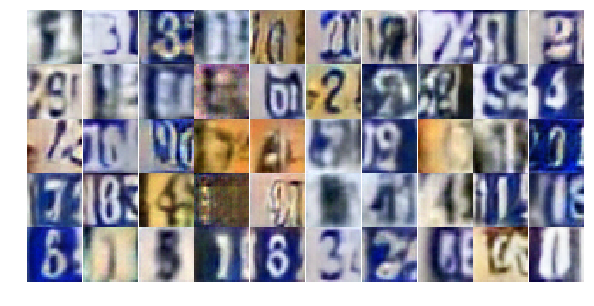

Epoch 13/25... Discriminator Loss: 0.5902... Generator Loss: 1.1330
Epoch 13/25... Discriminator Loss: 1.1942... Generator Loss: 0.7060
Epoch 13/25... Discriminator Loss: 0.6516... Generator Loss: 1.4465
Epoch 13/25... Discriminator Loss: 0.6676... Generator Loss: 1.3078
Epoch 13/25... Discriminator Loss: 1.0786... Generator Loss: 0.5938
Epoch 13/25... Discriminator Loss: 0.5601... Generator Loss: 1.7256
Epoch 13/25... Discriminator Loss: 0.6494... Generator Loss: 1.0648
Epoch 13/25... Discriminator Loss: 0.7891... Generator Loss: 0.8731
Epoch 13/25... Discriminator Loss: 1.3904... Generator Loss: 0.3944
Epoch 13/25... Discriminator Loss: 1.0095... Generator Loss: 0.6238


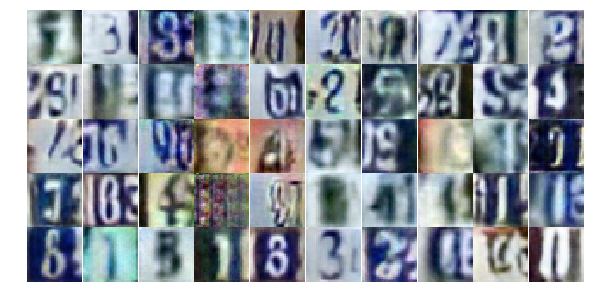

Epoch 13/25... Discriminator Loss: 0.3750... Generator Loss: 2.0064
Epoch 13/25... Discriminator Loss: 0.9666... Generator Loss: 0.6958
Epoch 13/25... Discriminator Loss: 0.5650... Generator Loss: 1.5464
Epoch 13/25... Discriminator Loss: 0.7873... Generator Loss: 0.8255
Epoch 14/25... Discriminator Loss: 1.0058... Generator Loss: 0.6161
Epoch 14/25... Discriminator Loss: 0.7897... Generator Loss: 0.9756
Epoch 14/25... Discriminator Loss: 1.1457... Generator Loss: 0.5455
Epoch 14/25... Discriminator Loss: 0.7579... Generator Loss: 2.2653
Epoch 14/25... Discriminator Loss: 0.5045... Generator Loss: 1.8086
Epoch 14/25... Discriminator Loss: 0.7318... Generator Loss: 0.9163


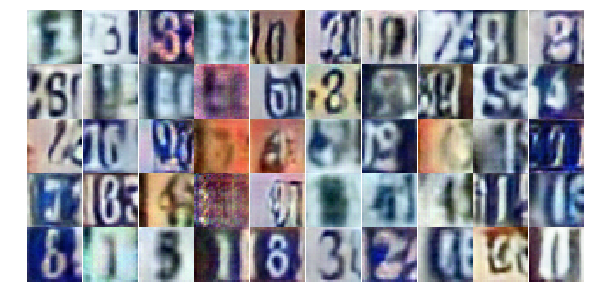

Epoch 14/25... Discriminator Loss: 0.8603... Generator Loss: 1.5103
Epoch 14/25... Discriminator Loss: 1.0520... Generator Loss: 0.6033
Epoch 14/25... Discriminator Loss: 0.6368... Generator Loss: 1.2704
Epoch 14/25... Discriminator Loss: 0.7987... Generator Loss: 0.8249
Epoch 14/25... Discriminator Loss: 1.6067... Generator Loss: 0.3022
Epoch 14/25... Discriminator Loss: 0.3850... Generator Loss: 1.4530
Epoch 14/25... Discriminator Loss: 0.5603... Generator Loss: 1.3290
Epoch 14/25... Discriminator Loss: 1.3897... Generator Loss: 0.4119
Epoch 14/25... Discriminator Loss: 0.9843... Generator Loss: 0.6396
Epoch 14/25... Discriminator Loss: 2.4541... Generator Loss: 0.1279


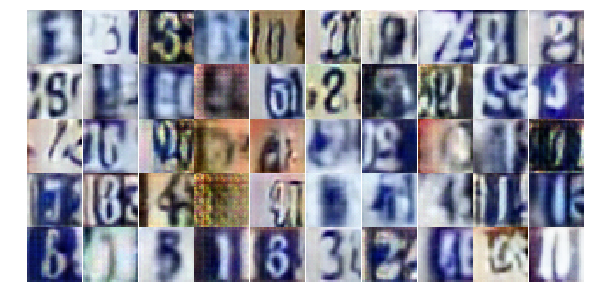

Epoch 14/25... Discriminator Loss: 0.5779... Generator Loss: 3.1033
Epoch 14/25... Discriminator Loss: 2.1041... Generator Loss: 0.2558
Epoch 14/25... Discriminator Loss: 0.8764... Generator Loss: 0.7566
Epoch 14/25... Discriminator Loss: 0.8709... Generator Loss: 0.9178
Epoch 14/25... Discriminator Loss: 1.2717... Generator Loss: 0.4846
Epoch 14/25... Discriminator Loss: 0.7191... Generator Loss: 0.9516
Epoch 14/25... Discriminator Loss: 0.4856... Generator Loss: 1.5212
Epoch 14/25... Discriminator Loss: 0.6279... Generator Loss: 1.2305
Epoch 14/25... Discriminator Loss: 0.6139... Generator Loss: 1.2595
Epoch 14/25... Discriminator Loss: 0.6120... Generator Loss: 1.1067


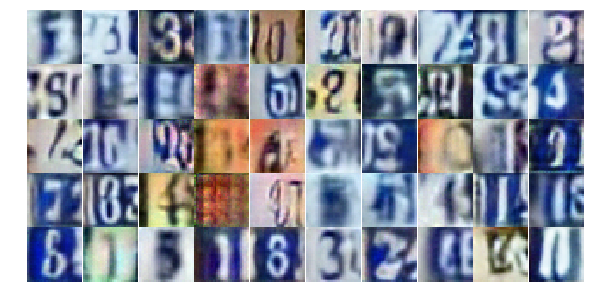

Epoch 14/25... Discriminator Loss: 0.8147... Generator Loss: 0.8915
Epoch 14/25... Discriminator Loss: 0.4188... Generator Loss: 1.9273
Epoch 14/25... Discriminator Loss: 0.6190... Generator Loss: 1.0773
Epoch 14/25... Discriminator Loss: 0.4135... Generator Loss: 1.7243
Epoch 14/25... Discriminator Loss: 0.6449... Generator Loss: 1.3156
Epoch 14/25... Discriminator Loss: 0.6148... Generator Loss: 1.1194
Epoch 14/25... Discriminator Loss: 0.6618... Generator Loss: 1.2550
Epoch 14/25... Discriminator Loss: 0.4108... Generator Loss: 2.1899
Epoch 14/25... Discriminator Loss: 0.5811... Generator Loss: 1.1474
Epoch 14/25... Discriminator Loss: 0.7916... Generator Loss: 0.9543


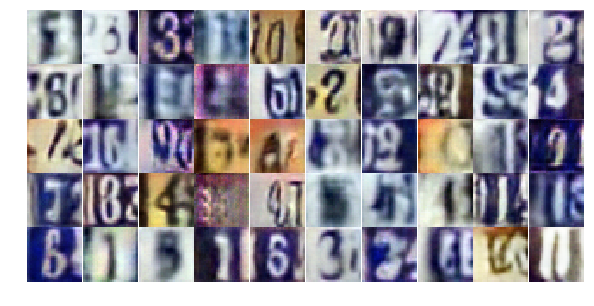

Epoch 14/25... Discriminator Loss: 1.2822... Generator Loss: 0.4615
Epoch 14/25... Discriminator Loss: 0.6617... Generator Loss: 1.5365
Epoch 14/25... Discriminator Loss: 1.4081... Generator Loss: 0.3798
Epoch 14/25... Discriminator Loss: 1.5327... Generator Loss: 0.3527
Epoch 14/25... Discriminator Loss: 0.6830... Generator Loss: 1.1320
Epoch 14/25... Discriminator Loss: 0.8867... Generator Loss: 0.7692
Epoch 14/25... Discriminator Loss: 0.6873... Generator Loss: 1.2676
Epoch 14/25... Discriminator Loss: 0.6129... Generator Loss: 1.1474
Epoch 14/25... Discriminator Loss: 1.4270... Generator Loss: 0.3868
Epoch 14/25... Discriminator Loss: 1.1218... Generator Loss: 0.5119


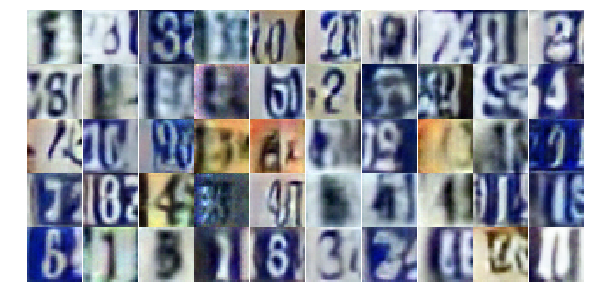

Epoch 14/25... Discriminator Loss: 0.9884... Generator Loss: 0.8515
Epoch 14/25... Discriminator Loss: 0.9777... Generator Loss: 0.7184
Epoch 14/25... Discriminator Loss: 0.4913... Generator Loss: 1.7530
Epoch 14/25... Discriminator Loss: 0.7063... Generator Loss: 0.9730
Epoch 14/25... Discriminator Loss: 0.5712... Generator Loss: 1.5007
Epoch 14/25... Discriminator Loss: 0.4272... Generator Loss: 2.0935
Epoch 14/25... Discriminator Loss: 0.6190... Generator Loss: 1.3020
Epoch 14/25... Discriminator Loss: 1.2021... Generator Loss: 0.4970
Epoch 14/25... Discriminator Loss: 0.8081... Generator Loss: 1.4206
Epoch 14/25... Discriminator Loss: 0.6704... Generator Loss: 0.9590


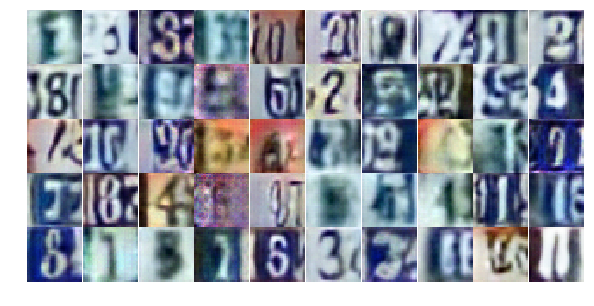

Epoch 14/25... Discriminator Loss: 0.8280... Generator Loss: 1.9481
Epoch 14/25... Discriminator Loss: 1.2731... Generator Loss: 0.4700
Epoch 15/25... Discriminator Loss: 0.8040... Generator Loss: 0.9747
Epoch 15/25... Discriminator Loss: 0.4901... Generator Loss: 1.5148
Epoch 15/25... Discriminator Loss: 0.6441... Generator Loss: 1.1140
Epoch 15/25... Discriminator Loss: 0.9673... Generator Loss: 0.6721
Epoch 15/25... Discriminator Loss: 1.0762... Generator Loss: 0.6008
Epoch 15/25... Discriminator Loss: 0.7792... Generator Loss: 0.8292
Epoch 15/25... Discriminator Loss: 1.2138... Generator Loss: 0.4981
Epoch 15/25... Discriminator Loss: 0.5644... Generator Loss: 1.2369


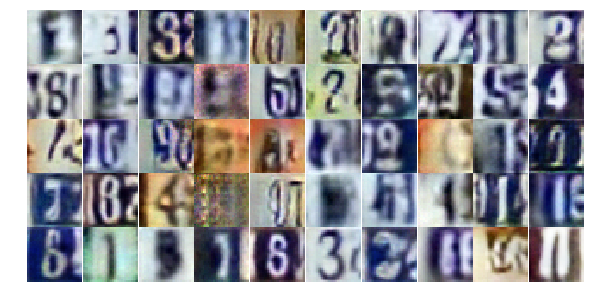

Epoch 15/25... Discriminator Loss: 0.6009... Generator Loss: 1.0969
Epoch 15/25... Discriminator Loss: 0.7322... Generator Loss: 1.1656
Epoch 15/25... Discriminator Loss: 0.9655... Generator Loss: 0.7374
Epoch 15/25... Discriminator Loss: 0.5682... Generator Loss: 1.3204
Epoch 15/25... Discriminator Loss: 0.9252... Generator Loss: 0.7401
Epoch 15/25... Discriminator Loss: 0.3427... Generator Loss: 1.8341
Epoch 15/25... Discriminator Loss: 0.9038... Generator Loss: 0.7352
Epoch 15/25... Discriminator Loss: 0.7668... Generator Loss: 0.9873
Epoch 15/25... Discriminator Loss: 0.6408... Generator Loss: 4.2201
Epoch 15/25... Discriminator Loss: 1.8366... Generator Loss: 0.2604


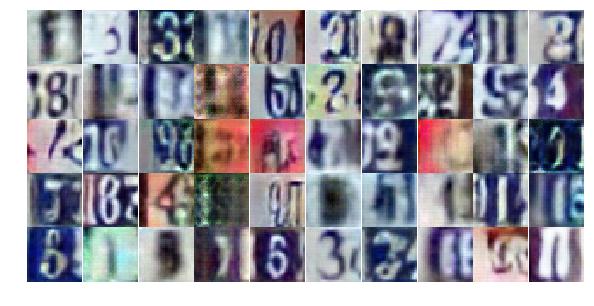

Epoch 15/25... Discriminator Loss: 1.0428... Generator Loss: 0.7639
Epoch 15/25... Discriminator Loss: 0.5932... Generator Loss: 1.1793
Epoch 15/25... Discriminator Loss: 0.5942... Generator Loss: 1.4494
Epoch 15/25... Discriminator Loss: 0.8453... Generator Loss: 0.7759
Epoch 15/25... Discriminator Loss: 0.9532... Generator Loss: 0.7896
Epoch 15/25... Discriminator Loss: 0.4706... Generator Loss: 1.4533
Epoch 15/25... Discriminator Loss: 1.7574... Generator Loss: 0.2572
Epoch 15/25... Discriminator Loss: 0.9289... Generator Loss: 0.7372
Epoch 15/25... Discriminator Loss: 0.6643... Generator Loss: 0.9572
Epoch 15/25... Discriminator Loss: 0.9461... Generator Loss: 0.7721


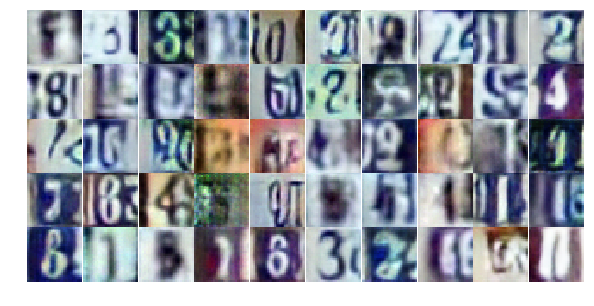

Epoch 15/25... Discriminator Loss: 0.6404... Generator Loss: 1.1197
Epoch 15/25... Discriminator Loss: 1.0131... Generator Loss: 0.6578
Epoch 15/25... Discriminator Loss: 0.5215... Generator Loss: 1.5133
Epoch 15/25... Discriminator Loss: 0.7163... Generator Loss: 1.0670
Epoch 15/25... Discriminator Loss: 0.6531... Generator Loss: 1.0667
Epoch 15/25... Discriminator Loss: 1.3447... Generator Loss: 2.4411
Epoch 15/25... Discriminator Loss: 0.6543... Generator Loss: 1.3711
Epoch 15/25... Discriminator Loss: 0.8329... Generator Loss: 1.7867
Epoch 15/25... Discriminator Loss: 0.7056... Generator Loss: 0.9719
Epoch 15/25... Discriminator Loss: 1.0202... Generator Loss: 0.6507


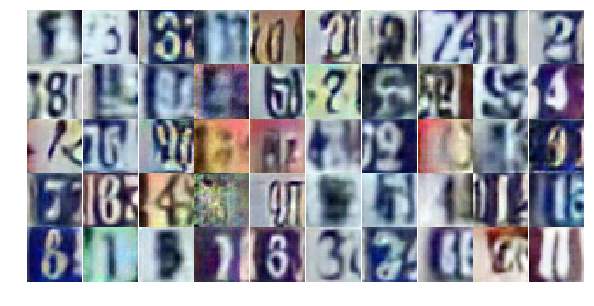

Epoch 15/25... Discriminator Loss: 0.6530... Generator Loss: 1.0194
Epoch 15/25... Discriminator Loss: 1.1586... Generator Loss: 0.5230
Epoch 15/25... Discriminator Loss: 0.6033... Generator Loss: 1.2018
Epoch 15/25... Discriminator Loss: 0.6291... Generator Loss: 1.1701
Epoch 15/25... Discriminator Loss: 0.5640... Generator Loss: 1.1240
Epoch 15/25... Discriminator Loss: 1.1956... Generator Loss: 0.5528
Epoch 15/25... Discriminator Loss: 0.4777... Generator Loss: 1.4004
Epoch 15/25... Discriminator Loss: 0.7679... Generator Loss: 1.3545
Epoch 15/25... Discriminator Loss: 0.5765... Generator Loss: 1.1880
Epoch 15/25... Discriminator Loss: 0.7885... Generator Loss: 1.3062


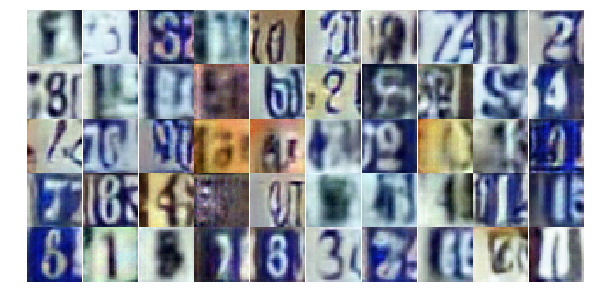

Epoch 15/25... Discriminator Loss: 1.5191... Generator Loss: 0.3358
Epoch 15/25... Discriminator Loss: 1.3539... Generator Loss: 0.4606
Epoch 15/25... Discriminator Loss: 0.5135... Generator Loss: 1.5276
Epoch 15/25... Discriminator Loss: 0.9583... Generator Loss: 0.7470
Epoch 15/25... Discriminator Loss: 0.5898... Generator Loss: 1.5773
Epoch 15/25... Discriminator Loss: 0.8275... Generator Loss: 1.6500
Epoch 15/25... Discriminator Loss: 1.0142... Generator Loss: 0.8714
Epoch 15/25... Discriminator Loss: 0.6319... Generator Loss: 1.2337
Epoch 15/25... Discriminator Loss: 1.4964... Generator Loss: 0.3824
Epoch 16/25... Discriminator Loss: 1.1625... Generator Loss: 0.5474


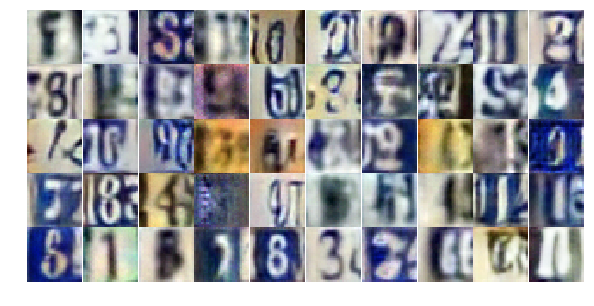

Epoch 16/25... Discriminator Loss: 0.7716... Generator Loss: 0.9761
Epoch 16/25... Discriminator Loss: 0.7520... Generator Loss: 1.0798
Epoch 16/25... Discriminator Loss: 0.8073... Generator Loss: 0.9806
Epoch 16/25... Discriminator Loss: 0.5658... Generator Loss: 1.5092
Epoch 16/25... Discriminator Loss: 0.6851... Generator Loss: 1.4293
Epoch 16/25... Discriminator Loss: 0.6258... Generator Loss: 1.1508
Epoch 16/25... Discriminator Loss: 1.6506... Generator Loss: 0.2739
Epoch 16/25... Discriminator Loss: 1.0751... Generator Loss: 0.5867
Epoch 16/25... Discriminator Loss: 0.5760... Generator Loss: 1.1525
Epoch 16/25... Discriminator Loss: 0.5033... Generator Loss: 1.4737


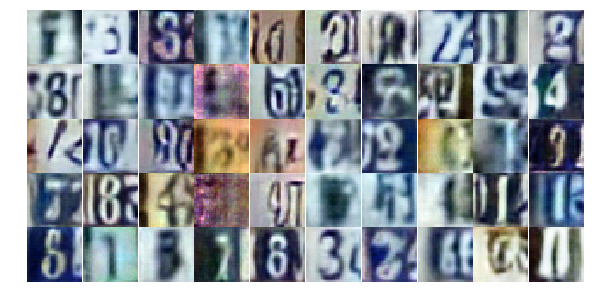

Epoch 16/25... Discriminator Loss: 1.5408... Generator Loss: 0.3362
Epoch 16/25... Discriminator Loss: 0.5975... Generator Loss: 1.2329
Epoch 16/25... Discriminator Loss: 0.7494... Generator Loss: 0.9826
Epoch 16/25... Discriminator Loss: 1.6940... Generator Loss: 0.2616
Epoch 16/25... Discriminator Loss: 1.9712... Generator Loss: 0.2921
Epoch 16/25... Discriminator Loss: 0.9499... Generator Loss: 0.7725
Epoch 16/25... Discriminator Loss: 1.0506... Generator Loss: 0.6062
Epoch 16/25... Discriminator Loss: 0.4320... Generator Loss: 2.0877
Epoch 16/25... Discriminator Loss: 0.5454... Generator Loss: 1.1879
Epoch 16/25... Discriminator Loss: 0.7091... Generator Loss: 0.8921


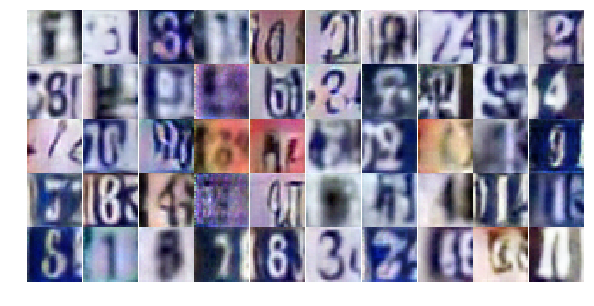

Epoch 16/25... Discriminator Loss: 0.7215... Generator Loss: 1.1034
Epoch 16/25... Discriminator Loss: 0.6544... Generator Loss: 1.0838
Epoch 16/25... Discriminator Loss: 0.7186... Generator Loss: 1.0680
Epoch 16/25... Discriminator Loss: 1.3230... Generator Loss: 0.4250
Epoch 16/25... Discriminator Loss: 0.6575... Generator Loss: 1.0967
Epoch 16/25... Discriminator Loss: 0.9161... Generator Loss: 0.7198
Epoch 16/25... Discriminator Loss: 0.6742... Generator Loss: 1.0032
Epoch 16/25... Discriminator Loss: 0.3374... Generator Loss: 1.8090
Epoch 16/25... Discriminator Loss: 0.6691... Generator Loss: 1.1879
Epoch 16/25... Discriminator Loss: 0.9134... Generator Loss: 0.7551


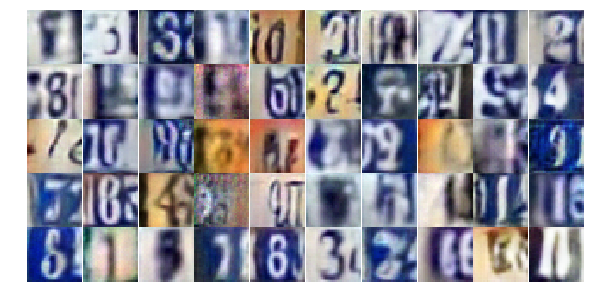

Epoch 16/25... Discriminator Loss: 1.0591... Generator Loss: 0.6522
Epoch 16/25... Discriminator Loss: 0.4996... Generator Loss: 1.4104
Epoch 16/25... Discriminator Loss: 0.7117... Generator Loss: 1.5193
Epoch 16/25... Discriminator Loss: 0.6450... Generator Loss: 1.2511
Epoch 16/25... Discriminator Loss: 0.8651... Generator Loss: 1.2367
Epoch 16/25... Discriminator Loss: 0.6323... Generator Loss: 1.2727
Epoch 16/25... Discriminator Loss: 0.8245... Generator Loss: 0.8093
Epoch 16/25... Discriminator Loss: 1.2608... Generator Loss: 0.4453
Epoch 16/25... Discriminator Loss: 1.2761... Generator Loss: 0.4695
Epoch 16/25... Discriminator Loss: 0.4801... Generator Loss: 1.5086


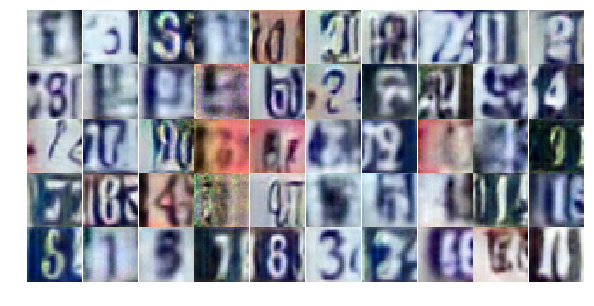

Epoch 16/25... Discriminator Loss: 0.5938... Generator Loss: 1.1926
Epoch 16/25... Discriminator Loss: 0.9528... Generator Loss: 0.7082
Epoch 16/25... Discriminator Loss: 0.9831... Generator Loss: 0.6643
Epoch 16/25... Discriminator Loss: 1.3000... Generator Loss: 0.4160
Epoch 16/25... Discriminator Loss: 1.0812... Generator Loss: 0.5908
Epoch 16/25... Discriminator Loss: 1.0645... Generator Loss: 0.5935
Epoch 16/25... Discriminator Loss: 0.5355... Generator Loss: 1.6235
Epoch 16/25... Discriminator Loss: 0.7686... Generator Loss: 0.8813
Epoch 16/25... Discriminator Loss: 0.3884... Generator Loss: 1.6181
Epoch 16/25... Discriminator Loss: 0.9005... Generator Loss: 0.7106


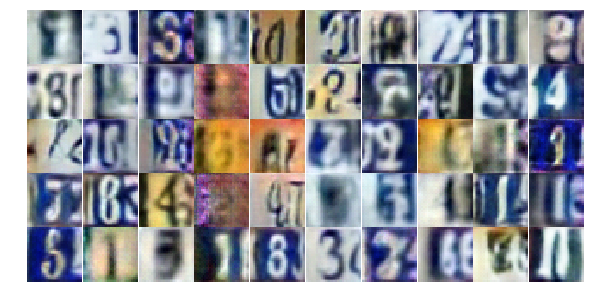

Epoch 16/25... Discriminator Loss: 1.3032... Generator Loss: 0.5234
Epoch 16/25... Discriminator Loss: 0.6221... Generator Loss: 1.0352
Epoch 16/25... Discriminator Loss: 1.8267... Generator Loss: 0.2490
Epoch 16/25... Discriminator Loss: 0.4755... Generator Loss: 2.2520
Epoch 16/25... Discriminator Loss: 0.5376... Generator Loss: 1.4054
Epoch 16/25... Discriminator Loss: 1.0536... Generator Loss: 0.6502
Epoch 17/25... Discriminator Loss: 0.6703... Generator Loss: 1.1545
Epoch 17/25... Discriminator Loss: 0.8659... Generator Loss: 0.7512
Epoch 17/25... Discriminator Loss: 0.7036... Generator Loss: 1.0847
Epoch 17/25... Discriminator Loss: 0.8816... Generator Loss: 0.7488


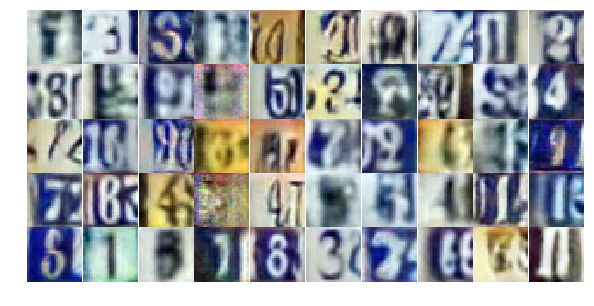

Epoch 17/25... Discriminator Loss: 0.5901... Generator Loss: 1.1791
Epoch 17/25... Discriminator Loss: 0.6075... Generator Loss: 1.0521
Epoch 17/25... Discriminator Loss: 0.8233... Generator Loss: 0.8756
Epoch 17/25... Discriminator Loss: 0.7248... Generator Loss: 0.9314
Epoch 17/25... Discriminator Loss: 1.1158... Generator Loss: 0.5580
Epoch 17/25... Discriminator Loss: 1.0640... Generator Loss: 0.6355
Epoch 17/25... Discriminator Loss: 0.7344... Generator Loss: 1.0047
Epoch 17/25... Discriminator Loss: 0.9709... Generator Loss: 0.6454
Epoch 17/25... Discriminator Loss: 0.3800... Generator Loss: 1.8006
Epoch 17/25... Discriminator Loss: 0.5810... Generator Loss: 1.7791


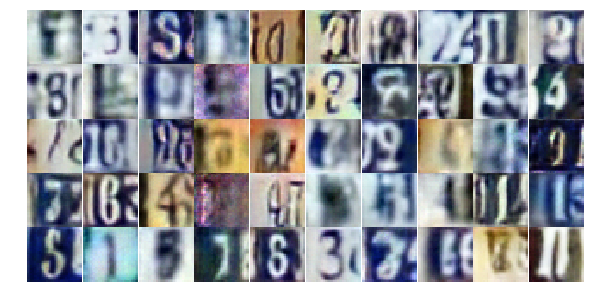

Epoch 17/25... Discriminator Loss: 0.9559... Generator Loss: 0.7685
Epoch 17/25... Discriminator Loss: 0.6896... Generator Loss: 1.9090
Epoch 17/25... Discriminator Loss: 0.7213... Generator Loss: 1.1096
Epoch 17/25... Discriminator Loss: 1.4117... Generator Loss: 0.5774
Epoch 17/25... Discriminator Loss: 0.8741... Generator Loss: 2.0888
Epoch 17/25... Discriminator Loss: 1.2154... Generator Loss: 0.4950
Epoch 17/25... Discriminator Loss: 0.6129... Generator Loss: 1.1259
Epoch 17/25... Discriminator Loss: 0.5658... Generator Loss: 1.2046
Epoch 17/25... Discriminator Loss: 0.7299... Generator Loss: 0.9622
Epoch 17/25... Discriminator Loss: 0.4994... Generator Loss: 1.5335


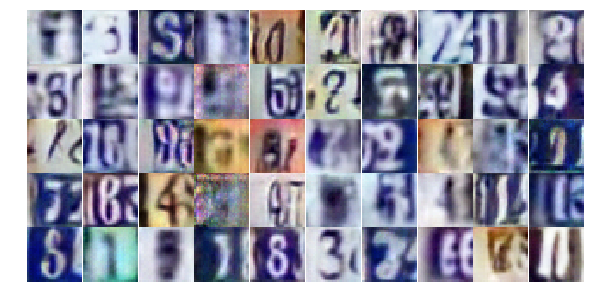

Epoch 17/25... Discriminator Loss: 1.5193... Generator Loss: 0.3424
Epoch 17/25... Discriminator Loss: 0.5813... Generator Loss: 1.2819
Epoch 17/25... Discriminator Loss: 0.6424... Generator Loss: 1.1481
Epoch 17/25... Discriminator Loss: 1.0465... Generator Loss: 0.6752
Epoch 17/25... Discriminator Loss: 1.5508... Generator Loss: 0.3319
Epoch 17/25... Discriminator Loss: 0.5334... Generator Loss: 1.4517
Epoch 17/25... Discriminator Loss: 0.8180... Generator Loss: 0.8608
Epoch 17/25... Discriminator Loss: 0.9724... Generator Loss: 0.6781
Epoch 17/25... Discriminator Loss: 0.9099... Generator Loss: 0.7082
Epoch 17/25... Discriminator Loss: 0.5404... Generator Loss: 1.2465


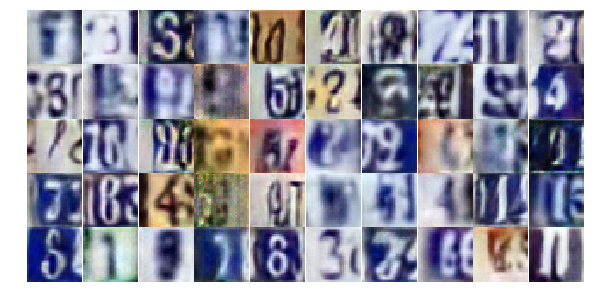

Epoch 17/25... Discriminator Loss: 0.6162... Generator Loss: 1.2152
Epoch 17/25... Discriminator Loss: 1.1564... Generator Loss: 0.5944
Epoch 17/25... Discriminator Loss: 0.6010... Generator Loss: 1.6053
Epoch 17/25... Discriminator Loss: 0.8803... Generator Loss: 0.8098
Epoch 17/25... Discriminator Loss: 0.7052... Generator Loss: 1.3590
Epoch 17/25... Discriminator Loss: 0.6170... Generator Loss: 1.4307
Epoch 17/25... Discriminator Loss: 1.0566... Generator Loss: 0.6453
Epoch 17/25... Discriminator Loss: 0.4514... Generator Loss: 1.5516
Epoch 17/25... Discriminator Loss: 0.4221... Generator Loss: 2.6257
Epoch 17/25... Discriminator Loss: 0.8478... Generator Loss: 0.7828


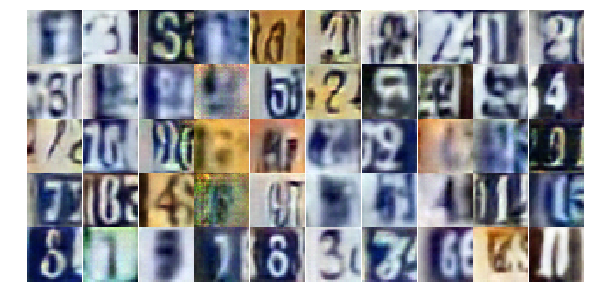

Epoch 17/25... Discriminator Loss: 2.6146... Generator Loss: 3.3142
Epoch 17/25... Discriminator Loss: 0.4112... Generator Loss: 2.5432
Epoch 17/25... Discriminator Loss: 1.2561... Generator Loss: 2.3520
Epoch 17/25... Discriminator Loss: 0.5621... Generator Loss: 1.2022
Epoch 17/25... Discriminator Loss: 0.6892... Generator Loss: 0.9862
Epoch 17/25... Discriminator Loss: 1.1488... Generator Loss: 0.5384
Epoch 17/25... Discriminator Loss: 1.0487... Generator Loss: 0.5994
Epoch 17/25... Discriminator Loss: 0.6553... Generator Loss: 1.1756
Epoch 17/25... Discriminator Loss: 0.5642... Generator Loss: 1.1961
Epoch 17/25... Discriminator Loss: 1.8968... Generator Loss: 0.3574


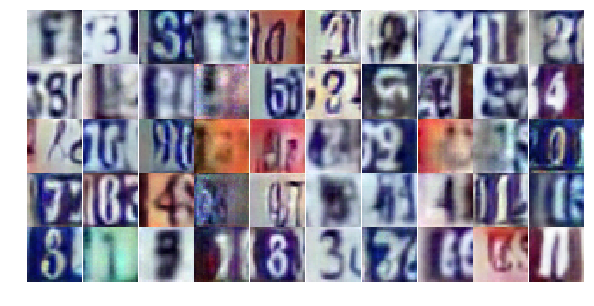

Epoch 17/25... Discriminator Loss: 0.8091... Generator Loss: 1.2729
Epoch 17/25... Discriminator Loss: 1.1624... Generator Loss: 0.5662
Epoch 17/25... Discriminator Loss: 0.4635... Generator Loss: 1.7226
Epoch 17/25... Discriminator Loss: 0.7898... Generator Loss: 0.8371
Epoch 18/25... Discriminator Loss: 0.9202... Generator Loss: 0.7524
Epoch 18/25... Discriminator Loss: 0.8155... Generator Loss: 0.8338
Epoch 18/25... Discriminator Loss: 0.8826... Generator Loss: 0.8068
Epoch 18/25... Discriminator Loss: 0.6794... Generator Loss: 1.0422
Epoch 18/25... Discriminator Loss: 0.5987... Generator Loss: 1.3757
Epoch 18/25... Discriminator Loss: 1.2007... Generator Loss: 0.5116


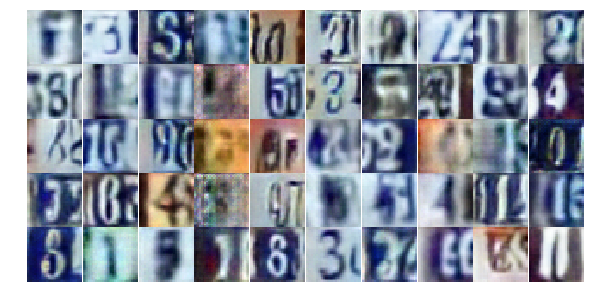

Epoch 18/25... Discriminator Loss: 0.6740... Generator Loss: 0.9407
Epoch 18/25... Discriminator Loss: 0.8304... Generator Loss: 0.8607
Epoch 18/25... Discriminator Loss: 1.0541... Generator Loss: 0.6239
Epoch 18/25... Discriminator Loss: 0.4355... Generator Loss: 1.5813
Epoch 18/25... Discriminator Loss: 0.7019... Generator Loss: 0.9499
Epoch 18/25... Discriminator Loss: 0.7418... Generator Loss: 0.8831
Epoch 18/25... Discriminator Loss: 0.6621... Generator Loss: 1.0456
Epoch 18/25... Discriminator Loss: 0.8987... Generator Loss: 0.7913
Epoch 18/25... Discriminator Loss: 0.8223... Generator Loss: 0.8660
Epoch 18/25... Discriminator Loss: 0.3020... Generator Loss: 1.8987


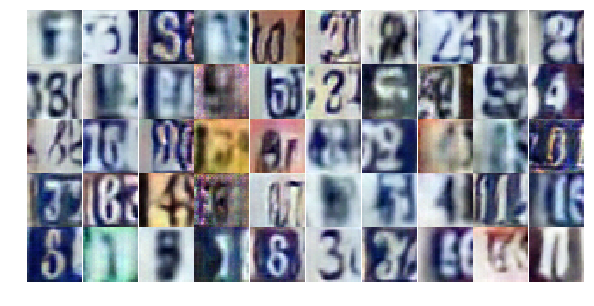

Epoch 18/25... Discriminator Loss: 0.8170... Generator Loss: 1.0510
Epoch 18/25... Discriminator Loss: 3.1324... Generator Loss: 5.4910
Epoch 18/25... Discriminator Loss: 1.3009... Generator Loss: 0.5038
Epoch 18/25... Discriminator Loss: 0.5704... Generator Loss: 1.4013
Epoch 18/25... Discriminator Loss: 0.3944... Generator Loss: 1.6637
Epoch 18/25... Discriminator Loss: 1.0414... Generator Loss: 0.6394
Epoch 18/25... Discriminator Loss: 0.9071... Generator Loss: 1.0172
Epoch 18/25... Discriminator Loss: 0.9136... Generator Loss: 0.7586
Epoch 18/25... Discriminator Loss: 0.7780... Generator Loss: 0.9096
Epoch 18/25... Discriminator Loss: 0.6601... Generator Loss: 1.0713


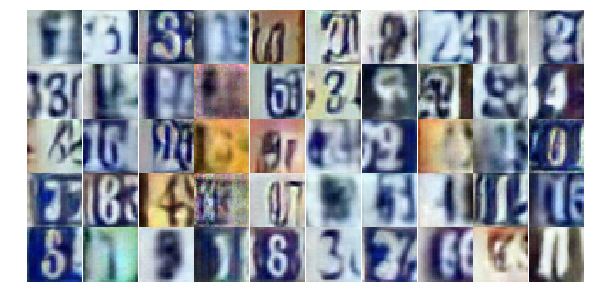

Epoch 18/25... Discriminator Loss: 0.4691... Generator Loss: 1.5961
Epoch 18/25... Discriminator Loss: 0.8627... Generator Loss: 0.8358
Epoch 18/25... Discriminator Loss: 1.0361... Generator Loss: 0.6047
Epoch 18/25... Discriminator Loss: 0.7441... Generator Loss: 0.9531
Epoch 18/25... Discriminator Loss: 1.1289... Generator Loss: 0.5702
Epoch 18/25... Discriminator Loss: 0.7621... Generator Loss: 0.9836
Epoch 18/25... Discriminator Loss: 0.7367... Generator Loss: 0.9130
Epoch 18/25... Discriminator Loss: 0.5688... Generator Loss: 1.3611
Epoch 18/25... Discriminator Loss: 0.8363... Generator Loss: 1.1444
Epoch 18/25... Discriminator Loss: 0.6578... Generator Loss: 1.2527


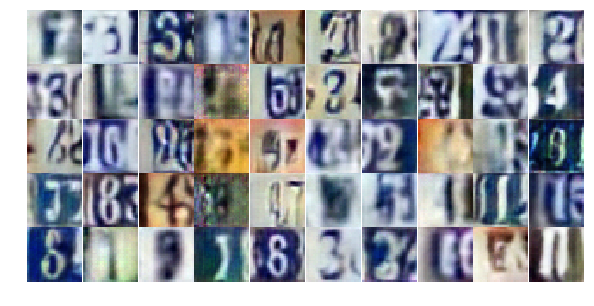

Epoch 18/25... Discriminator Loss: 0.4824... Generator Loss: 1.3529
Epoch 18/25... Discriminator Loss: 0.7517... Generator Loss: 0.9894
Epoch 18/25... Discriminator Loss: 0.6520... Generator Loss: 0.9841
Epoch 18/25... Discriminator Loss: 0.8222... Generator Loss: 0.8028
Epoch 18/25... Discriminator Loss: 1.2461... Generator Loss: 0.5349
Epoch 18/25... Discriminator Loss: 0.6777... Generator Loss: 1.0097
Epoch 18/25... Discriminator Loss: 0.8115... Generator Loss: 0.8090
Epoch 18/25... Discriminator Loss: 0.8846... Generator Loss: 1.3137
Epoch 18/25... Discriminator Loss: 0.6210... Generator Loss: 1.3003
Epoch 18/25... Discriminator Loss: 0.3931... Generator Loss: 1.9428


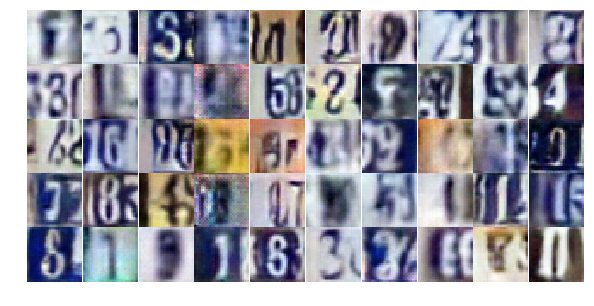

Epoch 18/25... Discriminator Loss: 0.5423... Generator Loss: 1.3839
Epoch 18/25... Discriminator Loss: 0.8331... Generator Loss: 0.8466
Epoch 18/25... Discriminator Loss: 0.7727... Generator Loss: 1.0149
Epoch 18/25... Discriminator Loss: 1.0313... Generator Loss: 0.6649
Epoch 18/25... Discriminator Loss: 0.5910... Generator Loss: 1.1799
Epoch 18/25... Discriminator Loss: 0.5068... Generator Loss: 1.5638
Epoch 18/25... Discriminator Loss: 0.5523... Generator Loss: 1.2439
Epoch 18/25... Discriminator Loss: 0.5351... Generator Loss: 1.4095
Epoch 18/25... Discriminator Loss: 0.9959... Generator Loss: 1.5184
Epoch 18/25... Discriminator Loss: 1.0884... Generator Loss: 0.6284


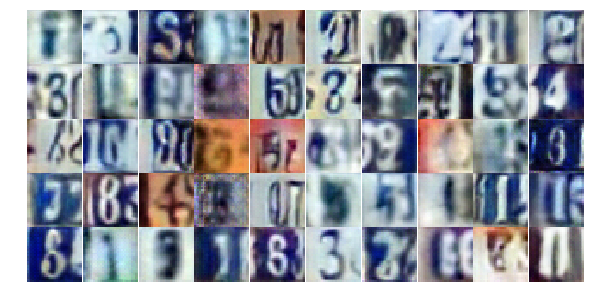

Epoch 18/25... Discriminator Loss: 0.7748... Generator Loss: 1.3053
Epoch 19/25... Discriminator Loss: 0.9949... Generator Loss: 0.6787
Epoch 19/25... Discriminator Loss: 1.0524... Generator Loss: 0.6109
Epoch 19/25... Discriminator Loss: 1.0032... Generator Loss: 0.6975
Epoch 19/25... Discriminator Loss: 0.7614... Generator Loss: 0.8692
Epoch 19/25... Discriminator Loss: 1.2472... Generator Loss: 0.5096
Epoch 19/25... Discriminator Loss: 0.6246... Generator Loss: 1.3401
Epoch 19/25... Discriminator Loss: 1.0021... Generator Loss: 0.8579
Epoch 19/25... Discriminator Loss: 0.7379... Generator Loss: 1.0738
Epoch 19/25... Discriminator Loss: 1.0586... Generator Loss: 0.6197


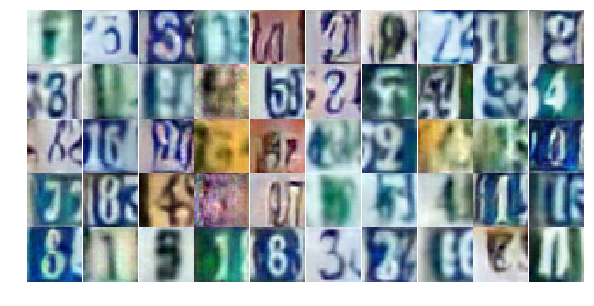

Epoch 19/25... Discriminator Loss: 1.0685... Generator Loss: 0.5932
Epoch 19/25... Discriminator Loss: 1.0982... Generator Loss: 0.5868
Epoch 19/25... Discriminator Loss: 1.1690... Generator Loss: 0.5655
Epoch 19/25... Discriminator Loss: 1.1041... Generator Loss: 0.5615
Epoch 19/25... Discriminator Loss: 0.9164... Generator Loss: 0.7149
Epoch 19/25... Discriminator Loss: 0.7210... Generator Loss: 1.0533
Epoch 19/25... Discriminator Loss: 0.8019... Generator Loss: 0.9473
Epoch 19/25... Discriminator Loss: 0.7390... Generator Loss: 0.8899
Epoch 19/25... Discriminator Loss: 1.0175... Generator Loss: 1.9388
Epoch 19/25... Discriminator Loss: 1.5051... Generator Loss: 0.3784


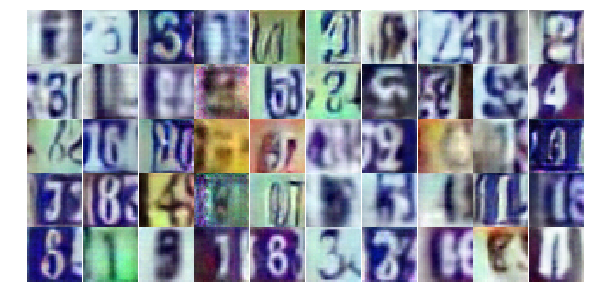

Epoch 19/25... Discriminator Loss: 1.1482... Generator Loss: 0.5712
Epoch 19/25... Discriminator Loss: 1.0822... Generator Loss: 0.7324
Epoch 19/25... Discriminator Loss: 1.2751... Generator Loss: 0.4998
Epoch 19/25... Discriminator Loss: 0.8501... Generator Loss: 0.7649
Epoch 19/25... Discriminator Loss: 1.5085... Generator Loss: 0.3393
Epoch 19/25... Discriminator Loss: 0.9612... Generator Loss: 0.6870
Epoch 19/25... Discriminator Loss: 1.0204... Generator Loss: 0.6521
Epoch 19/25... Discriminator Loss: 0.5560... Generator Loss: 1.1414
Epoch 19/25... Discriminator Loss: 0.7132... Generator Loss: 0.9020
Epoch 19/25... Discriminator Loss: 1.6670... Generator Loss: 0.2845


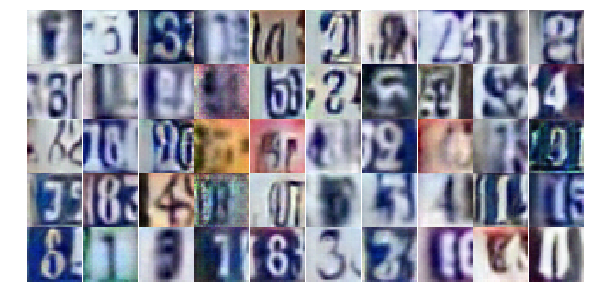

Epoch 19/25... Discriminator Loss: 0.5326... Generator Loss: 2.1756
Epoch 19/25... Discriminator Loss: 0.8534... Generator Loss: 0.8032
Epoch 19/25... Discriminator Loss: 1.0289... Generator Loss: 0.6031
Epoch 19/25... Discriminator Loss: 0.6007... Generator Loss: 1.2294
Epoch 19/25... Discriminator Loss: 0.6658... Generator Loss: 1.0401
Epoch 19/25... Discriminator Loss: 1.3619... Generator Loss: 0.3782
Epoch 19/25... Discriminator Loss: 0.7202... Generator Loss: 1.0243
Epoch 19/25... Discriminator Loss: 0.6226... Generator Loss: 1.2529
Epoch 19/25... Discriminator Loss: 0.9637... Generator Loss: 0.7218
Epoch 19/25... Discriminator Loss: 0.6116... Generator Loss: 1.0932


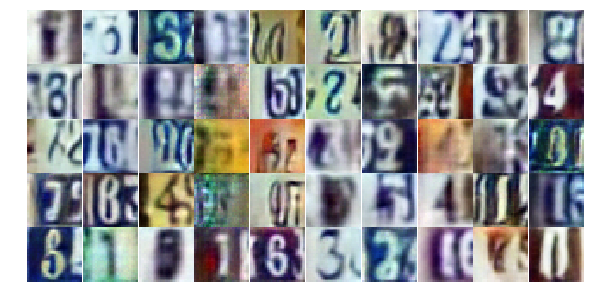

Epoch 19/25... Discriminator Loss: 0.5158... Generator Loss: 1.3470
Epoch 19/25... Discriminator Loss: 1.3232... Generator Loss: 0.4958
Epoch 19/25... Discriminator Loss: 0.8871... Generator Loss: 0.8226
Epoch 19/25... Discriminator Loss: 0.7378... Generator Loss: 0.9001
Epoch 19/25... Discriminator Loss: 0.9632... Generator Loss: 0.7944
Epoch 19/25... Discriminator Loss: 0.6208... Generator Loss: 2.1703
Epoch 19/25... Discriminator Loss: 0.8168... Generator Loss: 0.9219
Epoch 19/25... Discriminator Loss: 0.5603... Generator Loss: 1.2572
Epoch 19/25... Discriminator Loss: 0.6870... Generator Loss: 1.2482
Epoch 19/25... Discriminator Loss: 0.8853... Generator Loss: 0.8137


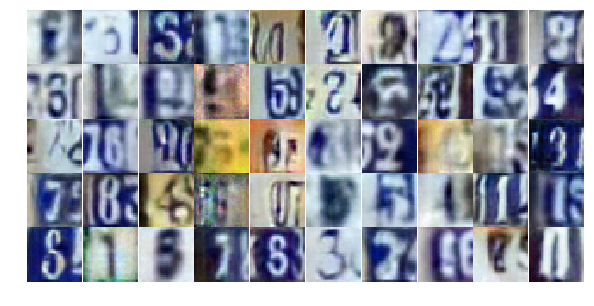

Epoch 19/25... Discriminator Loss: 1.1924... Generator Loss: 0.4621
Epoch 19/25... Discriminator Loss: 0.8974... Generator Loss: 0.8169
Epoch 19/25... Discriminator Loss: 1.8823... Generator Loss: 0.2756
Epoch 19/25... Discriminator Loss: 0.9705... Generator Loss: 1.0147
Epoch 19/25... Discriminator Loss: 0.7877... Generator Loss: 1.0264
Epoch 19/25... Discriminator Loss: 0.7671... Generator Loss: 0.9984
Epoch 19/25... Discriminator Loss: 1.6532... Generator Loss: 0.2918
Epoch 19/25... Discriminator Loss: 0.7029... Generator Loss: 1.6692
Epoch 20/25... Discriminator Loss: 0.7320... Generator Loss: 1.0639
Epoch 20/25... Discriminator Loss: 0.9190... Generator Loss: 0.6693


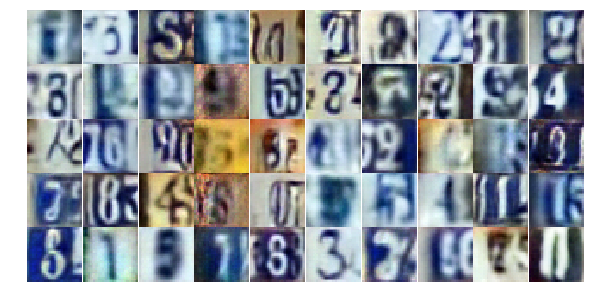

Epoch 20/25... Discriminator Loss: 0.3913... Generator Loss: 1.5476
Epoch 20/25... Discriminator Loss: 0.9215... Generator Loss: 0.7658
Epoch 20/25... Discriminator Loss: 1.2990... Generator Loss: 0.4428
Epoch 20/25... Discriminator Loss: 1.5134... Generator Loss: 0.3563
Epoch 20/25... Discriminator Loss: 0.7034... Generator Loss: 0.9520
Epoch 20/25... Discriminator Loss: 0.6291... Generator Loss: 1.1677
Epoch 20/25... Discriminator Loss: 0.9034... Generator Loss: 0.7327
Epoch 20/25... Discriminator Loss: 0.8134... Generator Loss: 1.0854
Epoch 20/25... Discriminator Loss: 0.9717... Generator Loss: 0.7456
Epoch 20/25... Discriminator Loss: 0.8130... Generator Loss: 0.7653


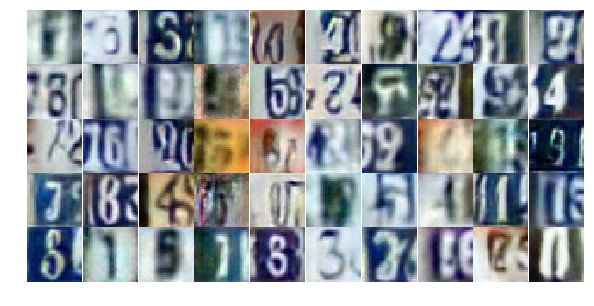

Epoch 20/25... Discriminator Loss: 1.7528... Generator Loss: 0.3105
Epoch 20/25... Discriminator Loss: 1.0770... Generator Loss: 0.6066
Epoch 20/25... Discriminator Loss: 0.8833... Generator Loss: 0.8312
Epoch 20/25... Discriminator Loss: 0.6393... Generator Loss: 1.1577
Epoch 20/25... Discriminator Loss: 0.8079... Generator Loss: 0.8549
Epoch 20/25... Discriminator Loss: 1.0998... Generator Loss: 0.5950
Epoch 20/25... Discriminator Loss: 1.5773... Generator Loss: 0.3776
Epoch 20/25... Discriminator Loss: 0.9994... Generator Loss: 0.6610
Epoch 20/25... Discriminator Loss: 0.9247... Generator Loss: 0.7620
Epoch 20/25... Discriminator Loss: 0.9885... Generator Loss: 0.6656


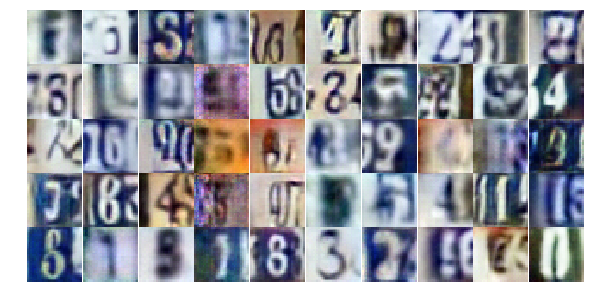

Epoch 20/25... Discriminator Loss: 0.6373... Generator Loss: 1.1905
Epoch 20/25... Discriminator Loss: 0.8110... Generator Loss: 0.9196
Epoch 20/25... Discriminator Loss: 0.3190... Generator Loss: 1.9292
Epoch 20/25... Discriminator Loss: 1.5338... Generator Loss: 0.3992
Epoch 20/25... Discriminator Loss: 0.8972... Generator Loss: 0.7737
Epoch 20/25... Discriminator Loss: 0.4864... Generator Loss: 1.2964
Epoch 20/25... Discriminator Loss: 0.7190... Generator Loss: 0.9779
Epoch 20/25... Discriminator Loss: 1.6050... Generator Loss: 0.4038
Epoch 20/25... Discriminator Loss: 1.0737... Generator Loss: 0.6090
Epoch 20/25... Discriminator Loss: 0.4142... Generator Loss: 1.6360


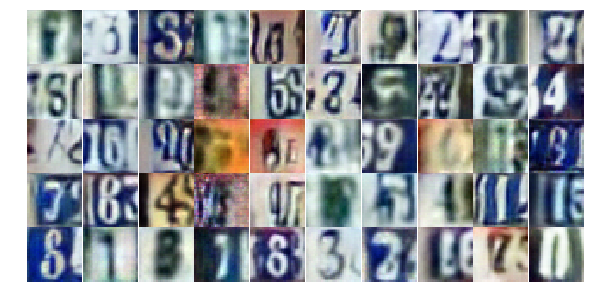

Epoch 20/25... Discriminator Loss: 0.9875... Generator Loss: 0.7548
Epoch 20/25... Discriminator Loss: 0.5666... Generator Loss: 1.1940
Epoch 20/25... Discriminator Loss: 0.9629... Generator Loss: 0.7972
Epoch 20/25... Discriminator Loss: 1.0182... Generator Loss: 0.6645
Epoch 20/25... Discriminator Loss: 0.7600... Generator Loss: 0.9126
Epoch 20/25... Discriminator Loss: 0.7138... Generator Loss: 1.1860
Epoch 20/25... Discriminator Loss: 0.7735... Generator Loss: 1.0098
Epoch 20/25... Discriminator Loss: 0.6793... Generator Loss: 1.0318
Epoch 20/25... Discriminator Loss: 0.7757... Generator Loss: 1.4861
Epoch 20/25... Discriminator Loss: 0.7407... Generator Loss: 0.8746


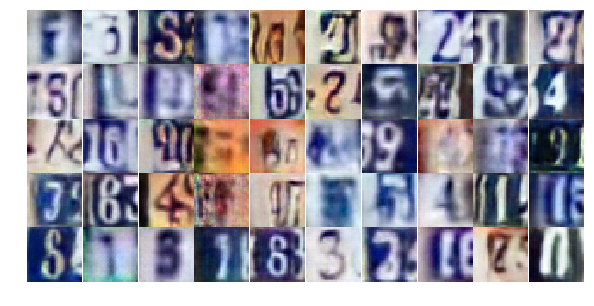

Epoch 20/25... Discriminator Loss: 0.7430... Generator Loss: 0.9155
Epoch 20/25... Discriminator Loss: 0.9049... Generator Loss: 0.6706
Epoch 20/25... Discriminator Loss: 0.8014... Generator Loss: 3.0835
Epoch 20/25... Discriminator Loss: 1.8037... Generator Loss: 0.3612
Epoch 20/25... Discriminator Loss: 1.3594... Generator Loss: 0.5831
Epoch 20/25... Discriminator Loss: 0.6660... Generator Loss: 1.2637
Epoch 20/25... Discriminator Loss: 1.0527... Generator Loss: 0.7166
Epoch 20/25... Discriminator Loss: 0.6880... Generator Loss: 1.1316
Epoch 20/25... Discriminator Loss: 0.5859... Generator Loss: 1.2663
Epoch 20/25... Discriminator Loss: 0.6686... Generator Loss: 1.1771


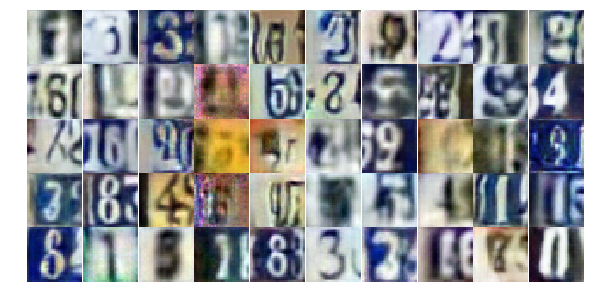

Epoch 20/25... Discriminator Loss: 0.6651... Generator Loss: 1.0787
Epoch 20/25... Discriminator Loss: 0.7535... Generator Loss: 1.0325
Epoch 20/25... Discriminator Loss: 0.5931... Generator Loss: 1.3904
Epoch 20/25... Discriminator Loss: 1.0205... Generator Loss: 0.7014
Epoch 20/25... Discriminator Loss: 0.4835... Generator Loss: 1.2408
Epoch 20/25... Discriminator Loss: 0.4971... Generator Loss: 1.4712
Epoch 21/25... Discriminator Loss: 0.8531... Generator Loss: 0.8652
Epoch 21/25... Discriminator Loss: 0.6682... Generator Loss: 1.0110
Epoch 21/25... Discriminator Loss: 1.3995... Generator Loss: 0.3899
Epoch 21/25... Discriminator Loss: 1.0818... Generator Loss: 0.5340


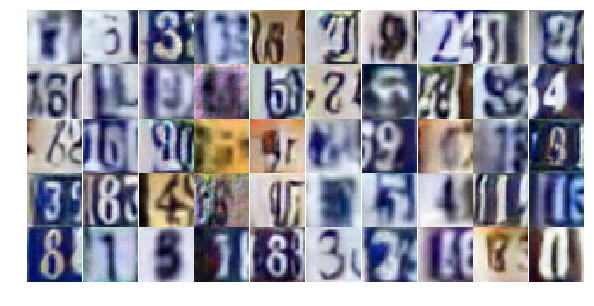

Epoch 21/25... Discriminator Loss: 1.0439... Generator Loss: 0.6823
Epoch 21/25... Discriminator Loss: 1.6626... Generator Loss: 0.3364
Epoch 21/25... Discriminator Loss: 0.5883... Generator Loss: 1.1407
Epoch 21/25... Discriminator Loss: 0.4879... Generator Loss: 1.2468
Epoch 21/25... Discriminator Loss: 0.6321... Generator Loss: 1.2869
Epoch 21/25... Discriminator Loss: 0.3385... Generator Loss: 1.6566
Epoch 21/25... Discriminator Loss: 1.0737... Generator Loss: 0.6459
Epoch 21/25... Discriminator Loss: 0.7085... Generator Loss: 1.2971
Epoch 21/25... Discriminator Loss: 0.7039... Generator Loss: 0.9583
Epoch 21/25... Discriminator Loss: 0.9336... Generator Loss: 0.7378


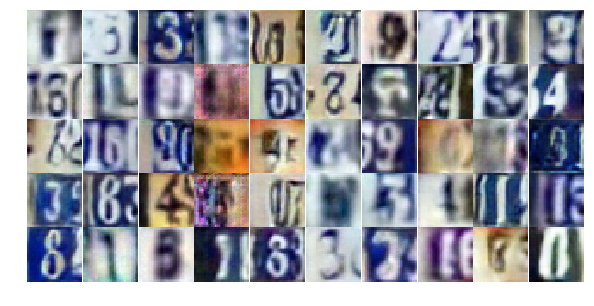

Epoch 21/25... Discriminator Loss: 0.4427... Generator Loss: 1.4152
Epoch 21/25... Discriminator Loss: 0.7502... Generator Loss: 0.8957
Epoch 21/25... Discriminator Loss: 2.2577... Generator Loss: 0.2042
Epoch 21/25... Discriminator Loss: 2.4789... Generator Loss: 0.1823
Epoch 21/25... Discriminator Loss: 0.5665... Generator Loss: 1.2673
Epoch 21/25... Discriminator Loss: 1.1409... Generator Loss: 0.5726
Epoch 21/25... Discriminator Loss: 0.9143... Generator Loss: 0.7691
Epoch 21/25... Discriminator Loss: 0.4992... Generator Loss: 1.6504
Epoch 21/25... Discriminator Loss: 0.5839... Generator Loss: 1.1886
Epoch 21/25... Discriminator Loss: 0.9391... Generator Loss: 0.7386


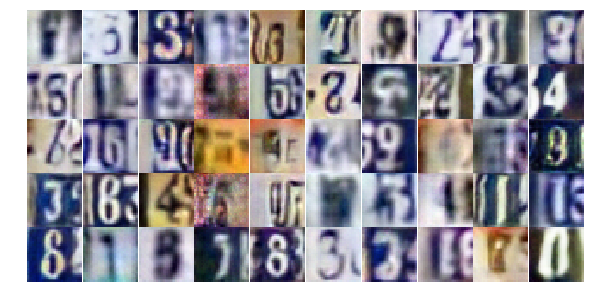

Epoch 21/25... Discriminator Loss: 1.0220... Generator Loss: 0.6248
Epoch 21/25... Discriminator Loss: 0.6446... Generator Loss: 1.0458
Epoch 21/25... Discriminator Loss: 0.6816... Generator Loss: 1.1582
Epoch 21/25... Discriminator Loss: 0.7427... Generator Loss: 0.9619
Epoch 21/25... Discriminator Loss: 1.4680... Generator Loss: 0.3927
Epoch 21/25... Discriminator Loss: 1.4065... Generator Loss: 0.4029
Epoch 21/25... Discriminator Loss: 0.5623... Generator Loss: 1.2441
Epoch 21/25... Discriminator Loss: 1.2730... Generator Loss: 0.4942
Epoch 21/25... Discriminator Loss: 1.2680... Generator Loss: 0.5150
Epoch 21/25... Discriminator Loss: 1.7768... Generator Loss: 0.2620


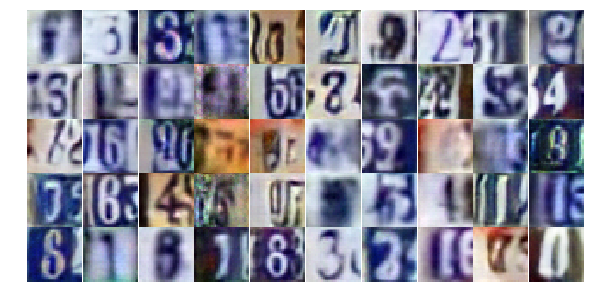

Epoch 21/25... Discriminator Loss: 1.3758... Generator Loss: 0.4819
Epoch 21/25... Discriminator Loss: 0.5842... Generator Loss: 1.2858
Epoch 21/25... Discriminator Loss: 1.0754... Generator Loss: 0.6281
Epoch 21/25... Discriminator Loss: 0.5136... Generator Loss: 1.1964
Epoch 21/25... Discriminator Loss: 0.5200... Generator Loss: 1.2612
Epoch 21/25... Discriminator Loss: 0.6109... Generator Loss: 1.2348
Epoch 21/25... Discriminator Loss: 0.6998... Generator Loss: 1.1018
Epoch 21/25... Discriminator Loss: 1.4851... Generator Loss: 0.3739
Epoch 21/25... Discriminator Loss: 1.0107... Generator Loss: 0.6521
Epoch 21/25... Discriminator Loss: 0.3137... Generator Loss: 2.6082


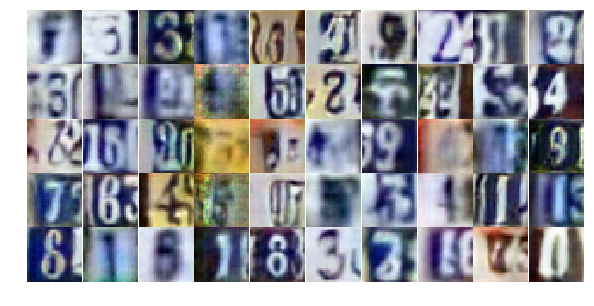

Epoch 21/25... Discriminator Loss: 0.7558... Generator Loss: 1.0759
Epoch 21/25... Discriminator Loss: 0.8021... Generator Loss: 0.9490
Epoch 21/25... Discriminator Loss: 0.6149... Generator Loss: 1.1626
Epoch 21/25... Discriminator Loss: 0.9892... Generator Loss: 0.7758
Epoch 21/25... Discriminator Loss: 0.4208... Generator Loss: 1.7925
Epoch 21/25... Discriminator Loss: 0.6858... Generator Loss: 1.2348
Epoch 21/25... Discriminator Loss: 0.9534... Generator Loss: 0.7007
Epoch 21/25... Discriminator Loss: 0.9493... Generator Loss: 0.9754
Epoch 21/25... Discriminator Loss: 0.8506... Generator Loss: 0.9070
Epoch 21/25... Discriminator Loss: 1.0260... Generator Loss: 0.6148


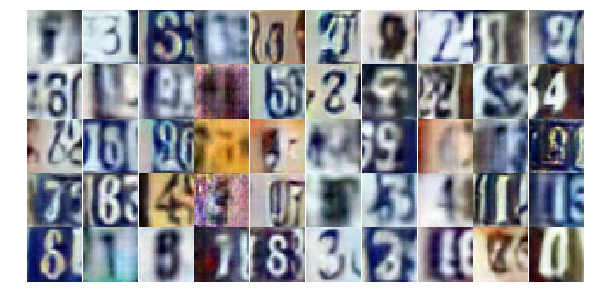

Epoch 21/25... Discriminator Loss: 0.4672... Generator Loss: 1.9379
Epoch 21/25... Discriminator Loss: 1.1722... Generator Loss: 0.5459
Epoch 21/25... Discriminator Loss: 0.8541... Generator Loss: 0.9147
Epoch 22/25... Discriminator Loss: 0.9945... Generator Loss: 0.7734
Epoch 22/25... Discriminator Loss: 0.9929... Generator Loss: 0.7135
Epoch 22/25... Discriminator Loss: 1.3391... Generator Loss: 0.4050
Epoch 22/25... Discriminator Loss: 0.7014... Generator Loss: 0.9899
Epoch 22/25... Discriminator Loss: 0.6567... Generator Loss: 1.0145
Epoch 22/25... Discriminator Loss: 1.1710... Generator Loss: 0.5876
Epoch 22/25... Discriminator Loss: 0.7104... Generator Loss: 2.2605


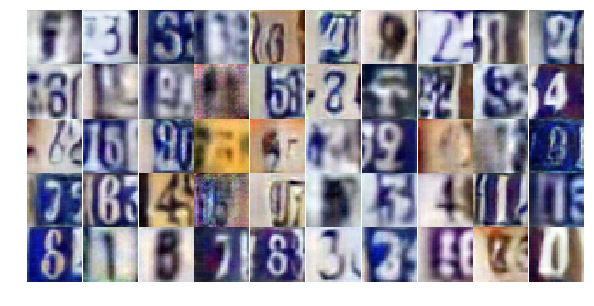

Epoch 22/25... Discriminator Loss: 1.9783... Generator Loss: 0.3605
Epoch 22/25... Discriminator Loss: 0.8362... Generator Loss: 1.5151
Epoch 22/25... Discriminator Loss: 1.1502... Generator Loss: 0.6757
Epoch 22/25... Discriminator Loss: 0.8215... Generator Loss: 0.8361
Epoch 22/25... Discriminator Loss: 0.7848... Generator Loss: 0.9250
Epoch 22/25... Discriminator Loss: 0.9444... Generator Loss: 0.7139
Epoch 22/25... Discriminator Loss: 0.8026... Generator Loss: 0.8963
Epoch 22/25... Discriminator Loss: 0.5321... Generator Loss: 1.5084
Epoch 22/25... Discriminator Loss: 0.9271... Generator Loss: 0.8315
Epoch 22/25... Discriminator Loss: 1.7385... Generator Loss: 0.3134


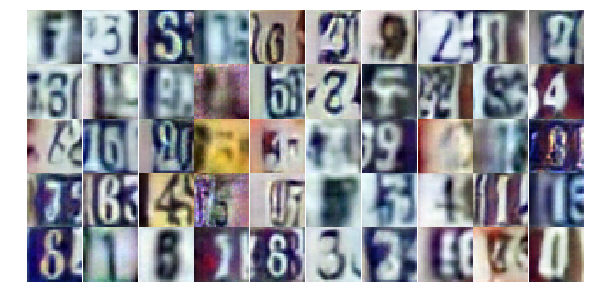

Epoch 22/25... Discriminator Loss: 0.5910... Generator Loss: 1.1734
Epoch 22/25... Discriminator Loss: 0.9844... Generator Loss: 0.6524
Epoch 22/25... Discriminator Loss: 1.1735... Generator Loss: 0.5200
Epoch 22/25... Discriminator Loss: 0.3632... Generator Loss: 1.6267
Epoch 22/25... Discriminator Loss: 0.6434... Generator Loss: 0.9661
Epoch 22/25... Discriminator Loss: 0.9441... Generator Loss: 0.6865
Epoch 22/25... Discriminator Loss: 0.4622... Generator Loss: 1.4713
Epoch 22/25... Discriminator Loss: 0.4683... Generator Loss: 1.4703
Epoch 22/25... Discriminator Loss: 0.7234... Generator Loss: 0.9681
Epoch 22/25... Discriminator Loss: 1.3649... Generator Loss: 0.4176


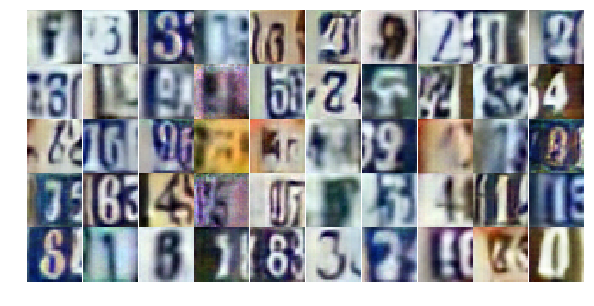

Epoch 22/25... Discriminator Loss: 0.4182... Generator Loss: 1.6501
Epoch 22/25... Discriminator Loss: 0.5258... Generator Loss: 1.4602
Epoch 22/25... Discriminator Loss: 0.7277... Generator Loss: 0.9977
Epoch 22/25... Discriminator Loss: 0.8610... Generator Loss: 0.7841
Epoch 22/25... Discriminator Loss: 1.1552... Generator Loss: 0.5607
Epoch 22/25... Discriminator Loss: 1.2066... Generator Loss: 0.5044
Epoch 22/25... Discriminator Loss: 1.4837... Generator Loss: 0.3975
Epoch 22/25... Discriminator Loss: 0.6378... Generator Loss: 1.3625
Epoch 22/25... Discriminator Loss: 1.4315... Generator Loss: 0.4829
Epoch 22/25... Discriminator Loss: 1.6297... Generator Loss: 0.3453


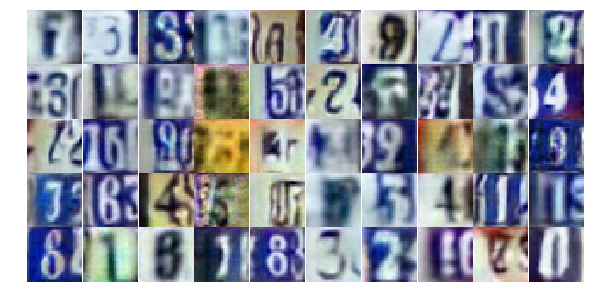

Epoch 22/25... Discriminator Loss: 0.7841... Generator Loss: 1.0877
Epoch 22/25... Discriminator Loss: 0.4972... Generator Loss: 1.3486
Epoch 22/25... Discriminator Loss: 0.4608... Generator Loss: 1.5308
Epoch 22/25... Discriminator Loss: 0.6168... Generator Loss: 1.0526
Epoch 22/25... Discriminator Loss: 0.4228... Generator Loss: 1.6371
Epoch 22/25... Discriminator Loss: 0.3999... Generator Loss: 1.5924
Epoch 22/25... Discriminator Loss: 1.1606... Generator Loss: 0.5133
Epoch 22/25... Discriminator Loss: 1.2559... Generator Loss: 0.5506
Epoch 22/25... Discriminator Loss: 1.0750... Generator Loss: 0.6216
Epoch 22/25... Discriminator Loss: 0.7821... Generator Loss: 0.9608


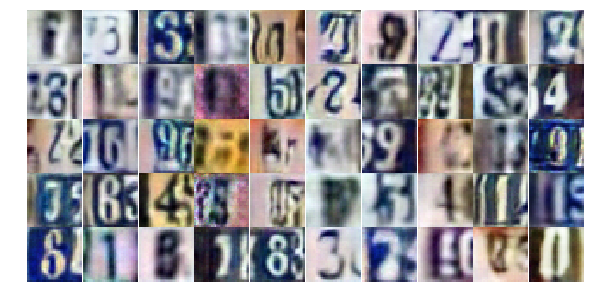

Epoch 22/25... Discriminator Loss: 0.8158... Generator Loss: 0.9073
Epoch 22/25... Discriminator Loss: 0.5720... Generator Loss: 1.5800
Epoch 22/25... Discriminator Loss: 1.7941... Generator Loss: 0.2782
Epoch 22/25... Discriminator Loss: 1.1560... Generator Loss: 0.6690
Epoch 22/25... Discriminator Loss: 0.9604... Generator Loss: 0.7046
Epoch 22/25... Discriminator Loss: 0.7871... Generator Loss: 1.2333
Epoch 22/25... Discriminator Loss: 1.7088... Generator Loss: 0.3154
Epoch 22/25... Discriminator Loss: 0.7284... Generator Loss: 0.9063
Epoch 22/25... Discriminator Loss: 0.7597... Generator Loss: 1.1149
Epoch 22/25... Discriminator Loss: 1.2440... Generator Loss: 0.5390


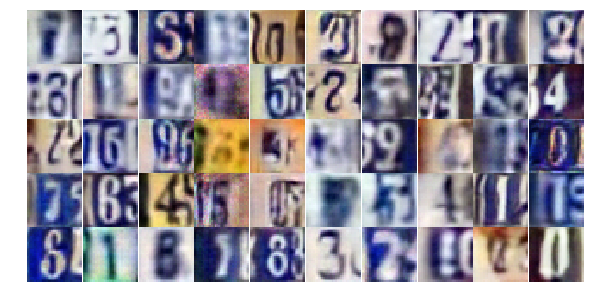

Epoch 23/25... Discriminator Loss: 0.4829... Generator Loss: 1.5379
Epoch 23/25... Discriminator Loss: 0.5847... Generator Loss: 1.4031
Epoch 23/25... Discriminator Loss: 1.2585... Generator Loss: 0.4772
Epoch 23/25... Discriminator Loss: 0.5306... Generator Loss: 2.4521
Epoch 23/25... Discriminator Loss: 0.7777... Generator Loss: 1.5897
Epoch 23/25... Discriminator Loss: 1.1167... Generator Loss: 0.5946
Epoch 23/25... Discriminator Loss: 1.5414... Generator Loss: 0.3971
Epoch 23/25... Discriminator Loss: 0.8680... Generator Loss: 0.8207
Epoch 23/25... Discriminator Loss: 0.7751... Generator Loss: 0.8755
Epoch 23/25... Discriminator Loss: 0.4763... Generator Loss: 1.3183


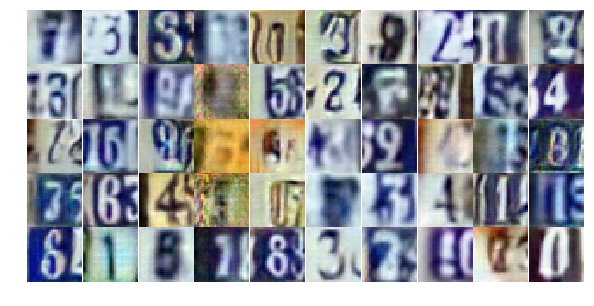

Epoch 23/25... Discriminator Loss: 0.4060... Generator Loss: 1.6125
Epoch 23/25... Discriminator Loss: 0.8433... Generator Loss: 0.8814
Epoch 23/25... Discriminator Loss: 0.8201... Generator Loss: 0.8896
Epoch 23/25... Discriminator Loss: 0.8281... Generator Loss: 0.8693
Epoch 23/25... Discriminator Loss: 0.5430... Generator Loss: 1.3114
Epoch 23/25... Discriminator Loss: 0.9141... Generator Loss: 0.7968
Epoch 23/25... Discriminator Loss: 0.8510... Generator Loss: 0.8652
Epoch 23/25... Discriminator Loss: 0.6576... Generator Loss: 1.1269
Epoch 23/25... Discriminator Loss: 1.4254... Generator Loss: 0.4349
Epoch 23/25... Discriminator Loss: 0.9258... Generator Loss: 0.7469


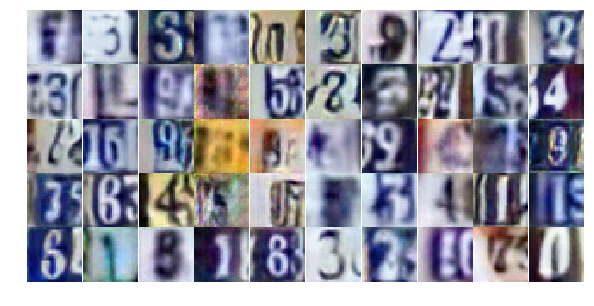

Epoch 23/25... Discriminator Loss: 1.2500... Generator Loss: 0.5409
Epoch 23/25... Discriminator Loss: 0.7923... Generator Loss: 0.9889
Epoch 23/25... Discriminator Loss: 1.4238... Generator Loss: 0.4022
Epoch 23/25... Discriminator Loss: 0.7764... Generator Loss: 1.0119
Epoch 23/25... Discriminator Loss: 0.5766... Generator Loss: 1.2735
Epoch 23/25... Discriminator Loss: 0.7103... Generator Loss: 0.9593
Epoch 23/25... Discriminator Loss: 0.7914... Generator Loss: 0.8173
Epoch 23/25... Discriminator Loss: 0.6379... Generator Loss: 1.0211
Epoch 23/25... Discriminator Loss: 0.6278... Generator Loss: 1.1875
Epoch 23/25... Discriminator Loss: 1.0704... Generator Loss: 1.4527


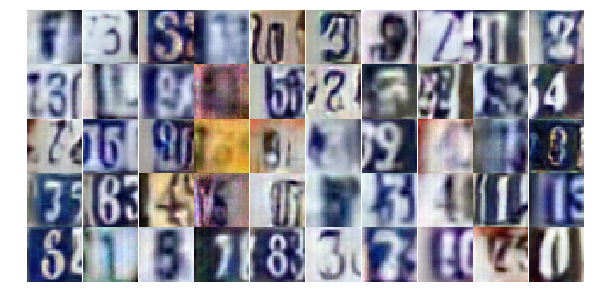

Epoch 23/25... Discriminator Loss: 0.6229... Generator Loss: 1.0254
Epoch 23/25... Discriminator Loss: 0.5577... Generator Loss: 1.2404
Epoch 23/25... Discriminator Loss: 0.6214... Generator Loss: 1.7791
Epoch 23/25... Discriminator Loss: 1.0727... Generator Loss: 0.6468
Epoch 23/25... Discriminator Loss: 0.6670... Generator Loss: 1.5219
Epoch 23/25... Discriminator Loss: 1.6426... Generator Loss: 0.3907
Epoch 23/25... Discriminator Loss: 0.9137... Generator Loss: 0.8039
Epoch 23/25... Discriminator Loss: 0.5507... Generator Loss: 1.7342
Epoch 23/25... Discriminator Loss: 0.3729... Generator Loss: 1.6863
Epoch 23/25... Discriminator Loss: 0.4971... Generator Loss: 1.5590


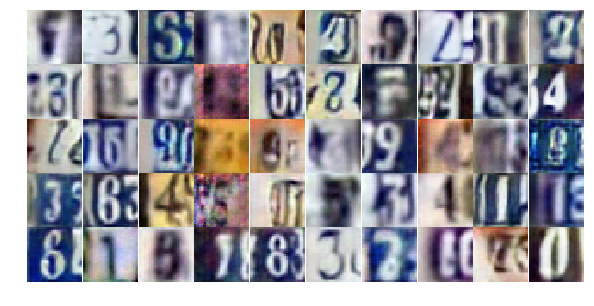

Epoch 23/25... Discriminator Loss: 0.8425... Generator Loss: 1.8415
Epoch 23/25... Discriminator Loss: 0.6567... Generator Loss: 1.0661
Epoch 23/25... Discriminator Loss: 0.6605... Generator Loss: 1.5452
Epoch 23/25... Discriminator Loss: 0.8502... Generator Loss: 0.7931
Epoch 23/25... Discriminator Loss: 0.7778... Generator Loss: 1.1387
Epoch 23/25... Discriminator Loss: 0.6931... Generator Loss: 1.2649
Epoch 23/25... Discriminator Loss: 1.1811... Generator Loss: 0.5482
Epoch 23/25... Discriminator Loss: 1.0671... Generator Loss: 0.7150
Epoch 23/25... Discriminator Loss: 0.7689... Generator Loss: 0.8818
Epoch 23/25... Discriminator Loss: 0.6325... Generator Loss: 1.1862


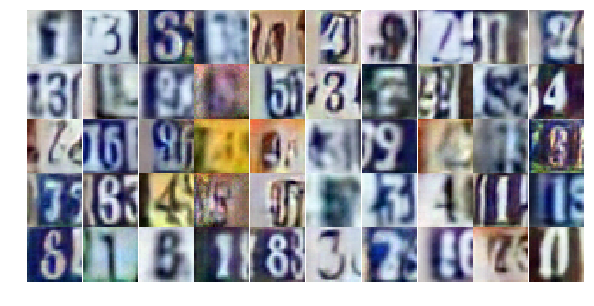

Epoch 23/25... Discriminator Loss: 0.5102... Generator Loss: 1.4248
Epoch 23/25... Discriminator Loss: 1.3383... Generator Loss: 0.4074
Epoch 23/25... Discriminator Loss: 1.0798... Generator Loss: 0.7225
Epoch 23/25... Discriminator Loss: 0.4893... Generator Loss: 1.3835
Epoch 23/25... Discriminator Loss: 1.0939... Generator Loss: 0.5864
Epoch 23/25... Discriminator Loss: 0.4683... Generator Loss: 1.7085
Epoch 23/25... Discriminator Loss: 1.2430... Generator Loss: 0.4453
Epoch 24/25... Discriminator Loss: 0.6883... Generator Loss: 1.0405
Epoch 24/25... Discriminator Loss: 0.6307... Generator Loss: 1.1335
Epoch 24/25... Discriminator Loss: 1.4221... Generator Loss: 0.4961


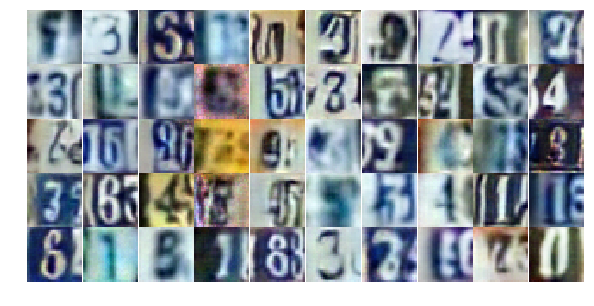

Epoch 24/25... Discriminator Loss: 0.5074... Generator Loss: 1.9920
Epoch 24/25... Discriminator Loss: 0.5158... Generator Loss: 1.7076
Epoch 24/25... Discriminator Loss: 0.9941... Generator Loss: 0.6418
Epoch 24/25... Discriminator Loss: 0.7850... Generator Loss: 2.3679
Epoch 24/25... Discriminator Loss: 0.8122... Generator Loss: 0.8356
Epoch 24/25... Discriminator Loss: 0.6764... Generator Loss: 0.9925
Epoch 24/25... Discriminator Loss: 0.6516... Generator Loss: 1.0922
Epoch 24/25... Discriminator Loss: 1.5884... Generator Loss: 0.3639
Epoch 24/25... Discriminator Loss: 0.3513... Generator Loss: 1.6356
Epoch 24/25... Discriminator Loss: 0.4539... Generator Loss: 1.7108


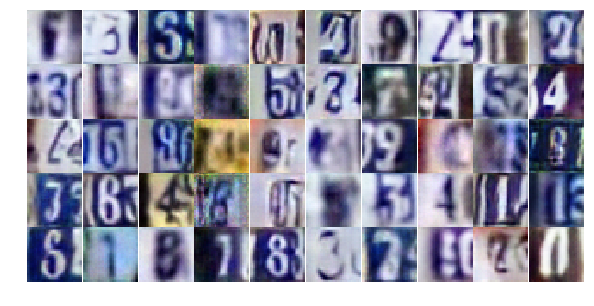

Epoch 24/25... Discriminator Loss: 1.4029... Generator Loss: 0.4275
Epoch 24/25... Discriminator Loss: 0.7466... Generator Loss: 0.9955
Epoch 24/25... Discriminator Loss: 1.2788... Generator Loss: 0.4725
Epoch 24/25... Discriminator Loss: 0.6012... Generator Loss: 1.1113
Epoch 24/25... Discriminator Loss: 0.4191... Generator Loss: 1.8676
Epoch 24/25... Discriminator Loss: 0.7993... Generator Loss: 0.9147
Epoch 24/25... Discriminator Loss: 0.4958... Generator Loss: 1.6565
Epoch 24/25... Discriminator Loss: 1.2540... Generator Loss: 0.5810
Epoch 24/25... Discriminator Loss: 0.7021... Generator Loss: 0.9950
Epoch 24/25... Discriminator Loss: 0.8938... Generator Loss: 0.8137


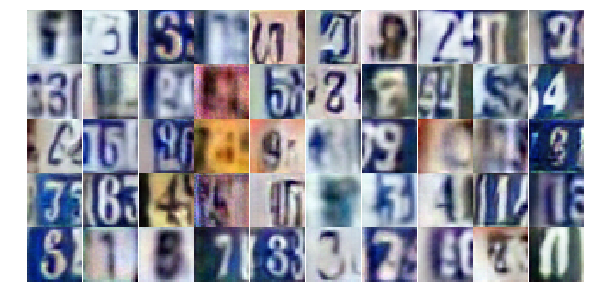

Epoch 24/25... Discriminator Loss: 0.8899... Generator Loss: 0.7458
Epoch 24/25... Discriminator Loss: 0.5755... Generator Loss: 1.2042
Epoch 24/25... Discriminator Loss: 0.5869... Generator Loss: 1.2883
Epoch 24/25... Discriminator Loss: 1.2008... Generator Loss: 0.5274
Epoch 24/25... Discriminator Loss: 0.7665... Generator Loss: 0.8799
Epoch 24/25... Discriminator Loss: 0.4980... Generator Loss: 1.3758
Epoch 24/25... Discriminator Loss: 0.5101... Generator Loss: 3.5857
Epoch 24/25... Discriminator Loss: 5.3840... Generator Loss: 0.0669
Epoch 24/25... Discriminator Loss: 1.2127... Generator Loss: 1.7498
Epoch 24/25... Discriminator Loss: 0.8215... Generator Loss: 0.9918


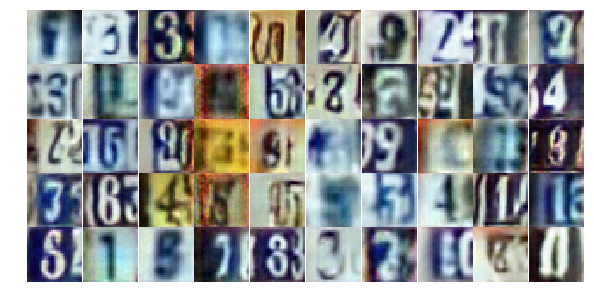

Epoch 24/25... Discriminator Loss: 0.5109... Generator Loss: 1.4598
Epoch 24/25... Discriminator Loss: 0.8030... Generator Loss: 0.9148
Epoch 24/25... Discriminator Loss: 0.7940... Generator Loss: 1.2236
Epoch 24/25... Discriminator Loss: 1.5103... Generator Loss: 0.3966
Epoch 24/25... Discriminator Loss: 0.9902... Generator Loss: 0.7639
Epoch 24/25... Discriminator Loss: 0.8144... Generator Loss: 0.8707
Epoch 24/25... Discriminator Loss: 0.8687... Generator Loss: 0.7895
Epoch 24/25... Discriminator Loss: 0.7181... Generator Loss: 1.0171
Epoch 24/25... Discriminator Loss: 0.9641... Generator Loss: 0.8409
Epoch 24/25... Discriminator Loss: 0.6406... Generator Loss: 1.2504


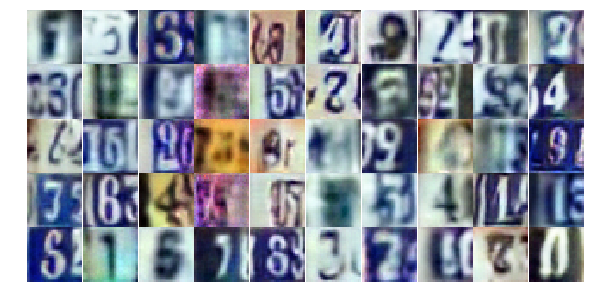

Epoch 24/25... Discriminator Loss: 0.5603... Generator Loss: 1.2052
Epoch 24/25... Discriminator Loss: 1.0484... Generator Loss: 0.6442
Epoch 24/25... Discriminator Loss: 1.1734... Generator Loss: 0.5593
Epoch 24/25... Discriminator Loss: 1.6127... Generator Loss: 0.3413
Epoch 24/25... Discriminator Loss: 1.4000... Generator Loss: 0.4698
Epoch 24/25... Discriminator Loss: 0.7266... Generator Loss: 0.9519
Epoch 24/25... Discriminator Loss: 1.2251... Generator Loss: 0.5223
Epoch 24/25... Discriminator Loss: 0.6768... Generator Loss: 1.2173
Epoch 24/25... Discriminator Loss: 1.0260... Generator Loss: 0.6575
Epoch 24/25... Discriminator Loss: 0.7729... Generator Loss: 2.4276


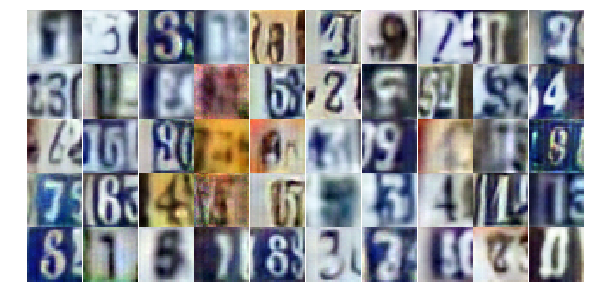

Epoch 24/25... Discriminator Loss: 0.8133... Generator Loss: 2.5904
Epoch 24/25... Discriminator Loss: 1.3777... Generator Loss: 0.4069
Epoch 24/25... Discriminator Loss: 1.2999... Generator Loss: 0.5555
Epoch 24/25... Discriminator Loss: 0.8486... Generator Loss: 0.8678
Epoch 24/25... Discriminator Loss: 1.1372... Generator Loss: 0.6155
Epoch 25/25... Discriminator Loss: 0.6877... Generator Loss: 1.2819
Epoch 25/25... Discriminator Loss: 0.7516... Generator Loss: 0.9864
Epoch 25/25... Discriminator Loss: 0.8858... Generator Loss: 0.7658
Epoch 25/25... Discriminator Loss: 0.8055... Generator Loss: 0.8910
Epoch 25/25... Discriminator Loss: 0.8935... Generator Loss: 0.7465


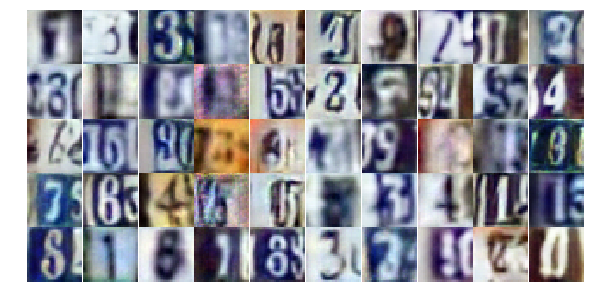

Epoch 25/25... Discriminator Loss: 1.1498... Generator Loss: 0.5168
Epoch 25/25... Discriminator Loss: 1.0775... Generator Loss: 0.6233
Epoch 25/25... Discriminator Loss: 0.9378... Generator Loss: 0.7868
Epoch 25/25... Discriminator Loss: 0.7327... Generator Loss: 1.0334
Epoch 25/25... Discriminator Loss: 0.6265... Generator Loss: 1.9514
Epoch 25/25... Discriminator Loss: 0.7895... Generator Loss: 1.0880
Epoch 25/25... Discriminator Loss: 0.9932... Generator Loss: 0.6889
Epoch 25/25... Discriminator Loss: 1.0300... Generator Loss: 0.7294
Epoch 25/25... Discriminator Loss: 0.5095... Generator Loss: 1.3340
Epoch 25/25... Discriminator Loss: 0.8864... Generator Loss: 0.7683


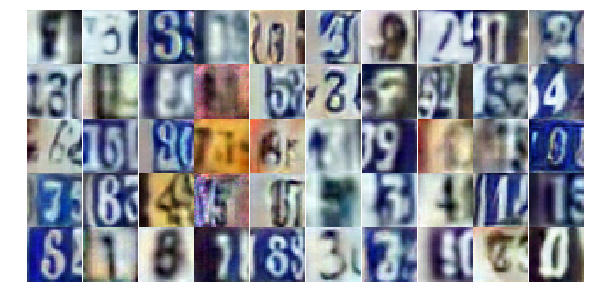

Epoch 25/25... Discriminator Loss: 0.8226... Generator Loss: 0.8447
Epoch 25/25... Discriminator Loss: 0.5381... Generator Loss: 1.9226
Epoch 25/25... Discriminator Loss: 1.3898... Generator Loss: 0.4890
Epoch 25/25... Discriminator Loss: 0.9048... Generator Loss: 0.7518
Epoch 25/25... Discriminator Loss: 0.6810... Generator Loss: 1.0963
Epoch 25/25... Discriminator Loss: 1.4569... Generator Loss: 0.4558
Epoch 25/25... Discriminator Loss: 0.7833... Generator Loss: 0.9489
Epoch 25/25... Discriminator Loss: 0.8667... Generator Loss: 1.3453
Epoch 25/25... Discriminator Loss: 0.4457... Generator Loss: 1.6517
Epoch 25/25... Discriminator Loss: 0.9174... Generator Loss: 0.8303


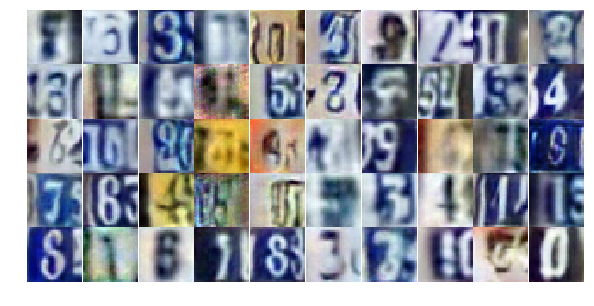

Epoch 25/25... Discriminator Loss: 0.9656... Generator Loss: 0.8102
Epoch 25/25... Discriminator Loss: 0.4494... Generator Loss: 1.4751
Epoch 25/25... Discriminator Loss: 1.2162... Generator Loss: 0.5166
Epoch 25/25... Discriminator Loss: 0.5088... Generator Loss: 1.3494
Epoch 25/25... Discriminator Loss: 0.8310... Generator Loss: 0.9032
Epoch 25/25... Discriminator Loss: 0.7475... Generator Loss: 0.9764
Epoch 25/25... Discriminator Loss: 0.7330... Generator Loss: 1.0992
Epoch 25/25... Discriminator Loss: 0.9980... Generator Loss: 0.6082
Epoch 25/25... Discriminator Loss: 0.7636... Generator Loss: 2.2768
Epoch 25/25... Discriminator Loss: 0.4660... Generator Loss: 1.4848


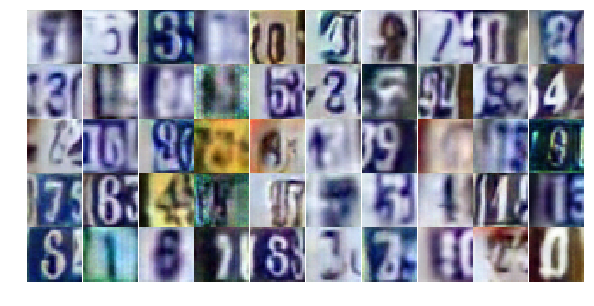

Epoch 25/25... Discriminator Loss: 0.7471... Generator Loss: 0.9387
Epoch 25/25... Discriminator Loss: 0.7761... Generator Loss: 0.8432
Epoch 25/25... Discriminator Loss: 0.6051... Generator Loss: 1.2666
Epoch 25/25... Discriminator Loss: 0.8357... Generator Loss: 0.8503
Epoch 25/25... Discriminator Loss: 1.0989... Generator Loss: 0.6231
Epoch 25/25... Discriminator Loss: 0.7247... Generator Loss: 0.9980
Epoch 25/25... Discriminator Loss: 0.4054... Generator Loss: 1.7404
Epoch 25/25... Discriminator Loss: 1.4830... Generator Loss: 0.3921
Epoch 25/25... Discriminator Loss: 2.1868... Generator Loss: 0.2464
Epoch 25/25... Discriminator Loss: 0.6668... Generator Loss: 2.4536


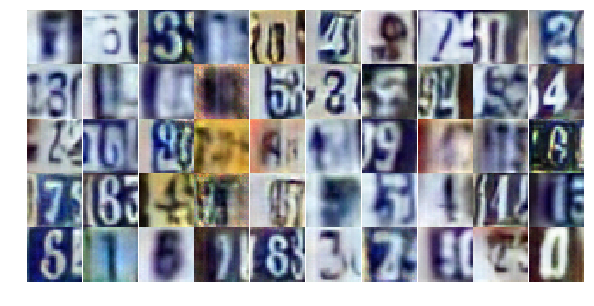

Epoch 25/25... Discriminator Loss: 0.7889... Generator Loss: 1.4789
Epoch 25/25... Discriminator Loss: 0.6035... Generator Loss: 1.2387
Epoch 25/25... Discriminator Loss: 0.6694... Generator Loss: 1.5602
Epoch 25/25... Discriminator Loss: 1.0029... Generator Loss: 0.6659
Epoch 25/25... Discriminator Loss: 0.8648... Generator Loss: 0.8443
Epoch 25/25... Discriminator Loss: 0.7502... Generator Loss: 0.9580
Epoch 25/25... Discriminator Loss: 1.2883... Generator Loss: 0.4688
Epoch 25/25... Discriminator Loss: 0.5172... Generator Loss: 1.5790
Epoch 25/25... Discriminator Loss: 0.6755... Generator Loss: 1.0618
Epoch 25/25... Discriminator Loss: 1.0532... Generator Loss: 0.6334


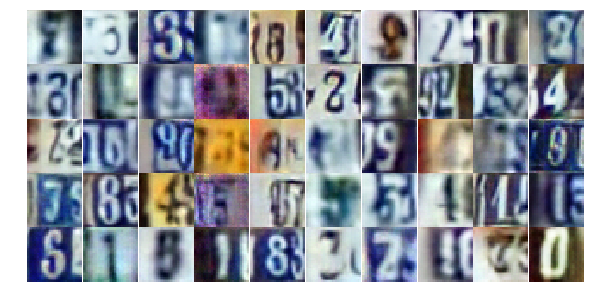

Epoch 25/25... Discriminator Loss: 0.6070... Generator Loss: 1.3030
Epoch 25/25... Discriminator Loss: 1.8232... Generator Loss: 0.2499


In [17]:
dataset = Dataset(trainset, testset)

losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

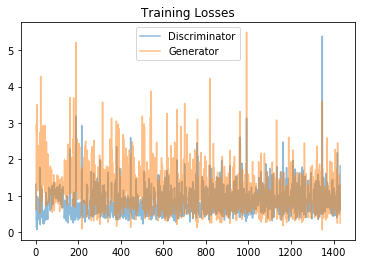

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

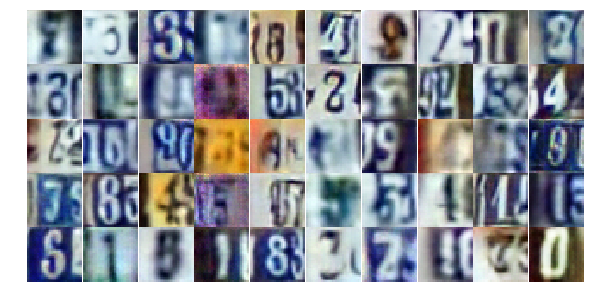

In [26]:
_ = view_samples(-1, samples, 5, 10, figsize=(10,5))